# re-fine

In [1]:
# N_VA_StaticAbsolute.py

import os
import time

# Import custom attributes
import av
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib import cm  # for colormaps
from matplotlib.colors import Normalize

Time elapsed for running module "av": 0.059 sec.


IndexError: boolean index did not match indexed array along dimension 0; dimension is 137 but corresponding boolean dimension is 136

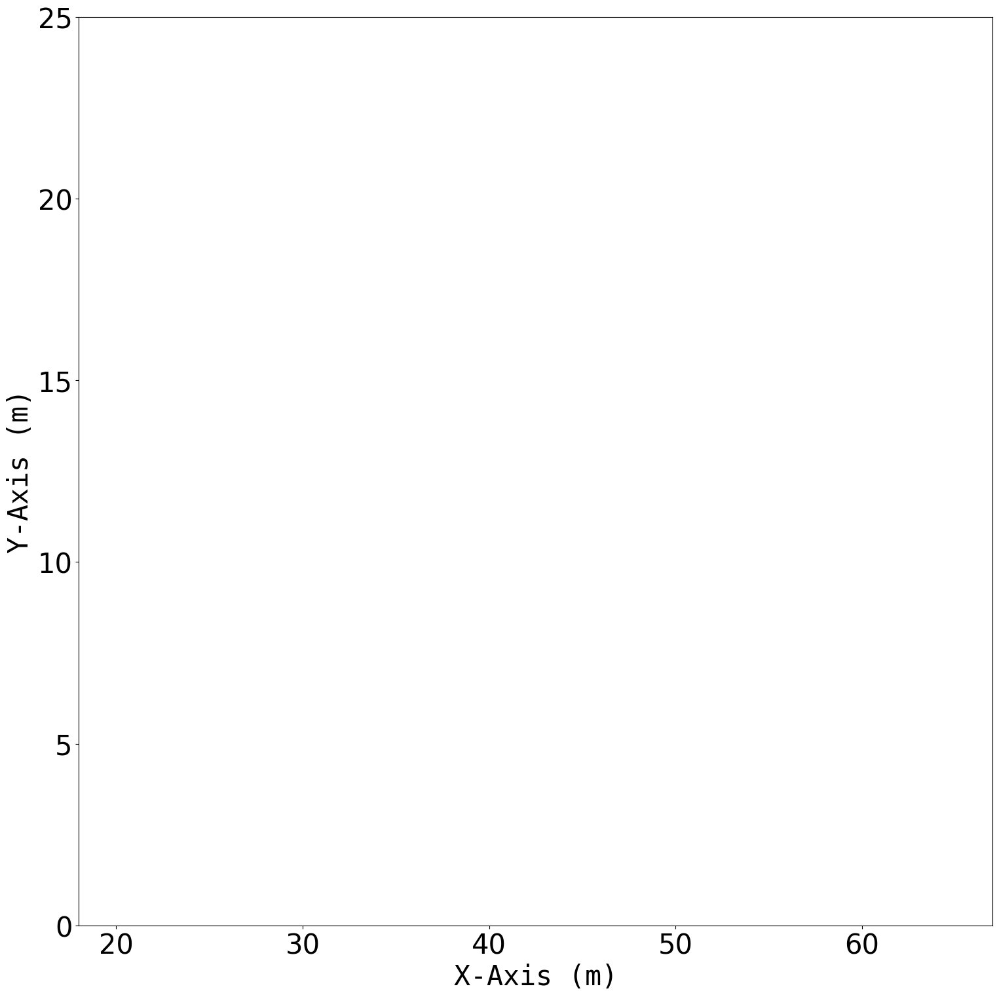

In [28]:
# N_VA_StaticAbsolute.py

import os
import time

import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize

# Import custom attributes
import av

# Start timer
t_start = time.time()

# Use centimeters as the base unit for saving high-res figures
mpl.rcParams['figure.dpi'] = 2.54

# Load the full dataset
df = pd.read_csv(av.dataset_name, header=None)
configs = df[0].unique()

for config in configs:
    sub = df[df[0] == config]
    X = sub[3].values
    Y = sub[4].values

    fig, ax = plt.subplots(figsize=(18, 18), dpi=100)
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(labelsize=30)

    # Colormap: map time → color
    cmap = cm.plasma
    norm = Normalize(vmin=0, vmax=av.tst - 1)

    # Plot each trajectory with quiver (filled triangular heads)
    for p in range(av.poi):
        xs = X[p::av.poi]
        ys = Y[p::av.poi]
        tvals = np.arange(len(xs))

        u = xs[1:] - xs[:-1]
        v = ys[1:] - ys[:-1]
        moved = (u != 0) | (v != 0)
        static = ~moved

        # 1) moving: filled triangular heads by quiver
        if moved.any():
            Q = ax.quiver(
                xs[:-1][moved], ys[:-1][moved],
                u[moved], v[moved],
                tvals[moved],
                cmap=cmap, norm=norm,
                angles='xy',
                scale_units='xy',
                scale=1,
                width=0.015,         # shaft thickness
                headwidth=6,        # head base width (points)
                headlength=8,       # head length (points)
                headaxislength=6,   # transition size (points)
                minlength=0          # no min-shaft
            )

        # 2) static: red dots
        if static.any():
            ax.scatter(
                xs[:-1][static], ys[:-1][static],
                color='red', s=40,
                linewidths=1.5, zorder=5
            )

        # 3) label start
        ax.text(xs[0], ys[0], f'p{p}',
                fontsize=30, fontname='monospace',
                ha='right', va='bottom', color='black')

    # Legend: static dot + quiverkey for 1 meter
    static_proxy = mpl.lines.Line2D([], [], marker='o',
                                    color='red', linestyle='None',
                                    markersize=8, label='static')
    ax.legend(handles=[static_proxy], loc='upper left', fontsize=20)

    # quiverkey draws a filled triangular arrow just like above
    ax.quiverkey(
        Q,
        X=0.8, Y=0.95, U=1.0,
        label='1 meter',
        labelpos='E',
        coordinates='axes',
        fontproperties={'size':20},
        color='black'
    )

    # colorbar for time
    cbar = fig.colorbar(Q, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Time step', fontsize=24, fontname='monospace')
    cbar.ax.tick_params(labelsize=20)

    ax.set_title(f'Configuration {config}',
                 fontname='monospace', fontsize=40)
    plt.savefig(f'N_C_Csa{config}.png', dpi=300, bbox_inches='tight')
    plt.close(fig)

print(f'Time elapsed: {time.time() - t_start:.3f} sec.')


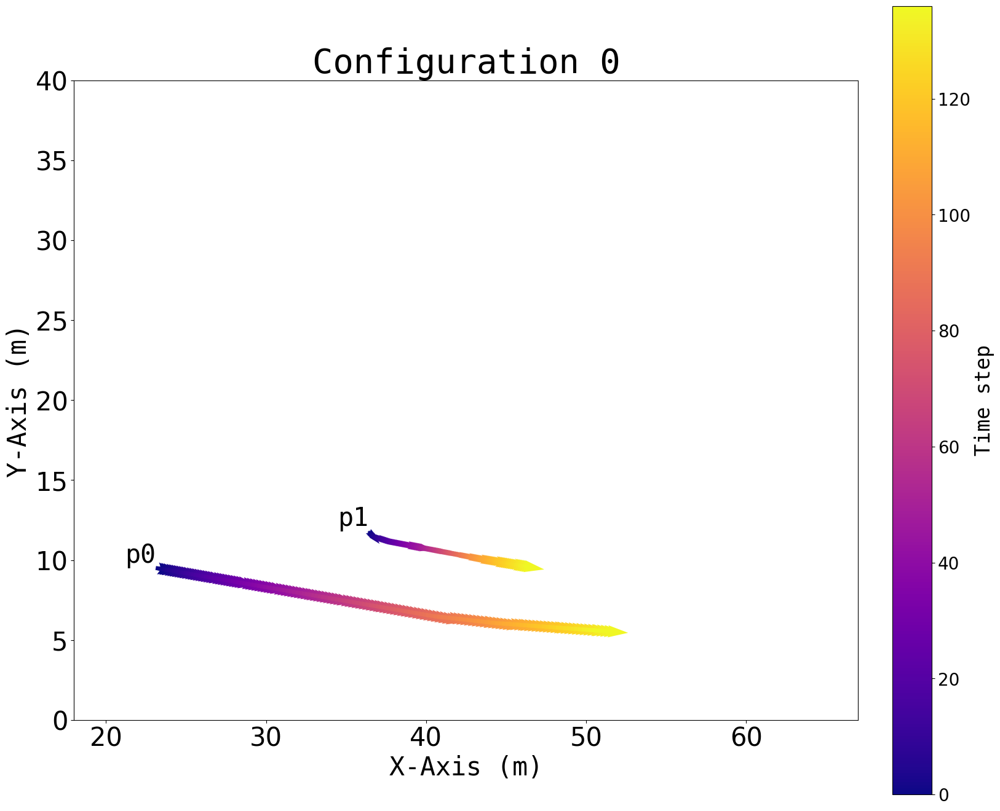

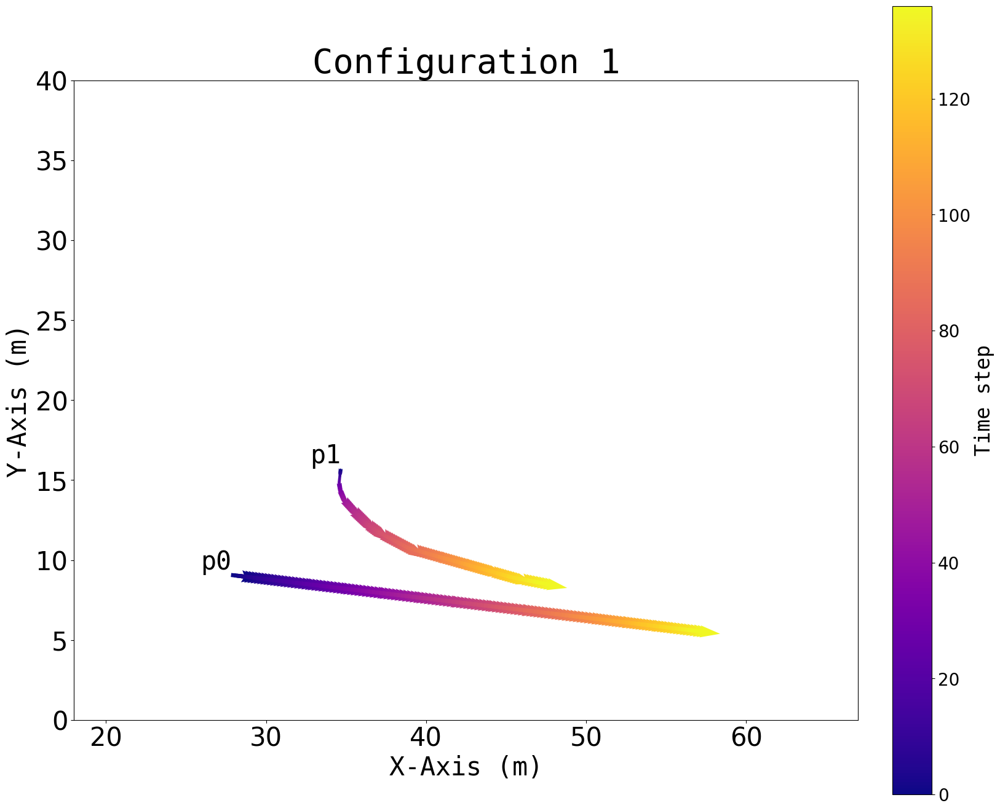

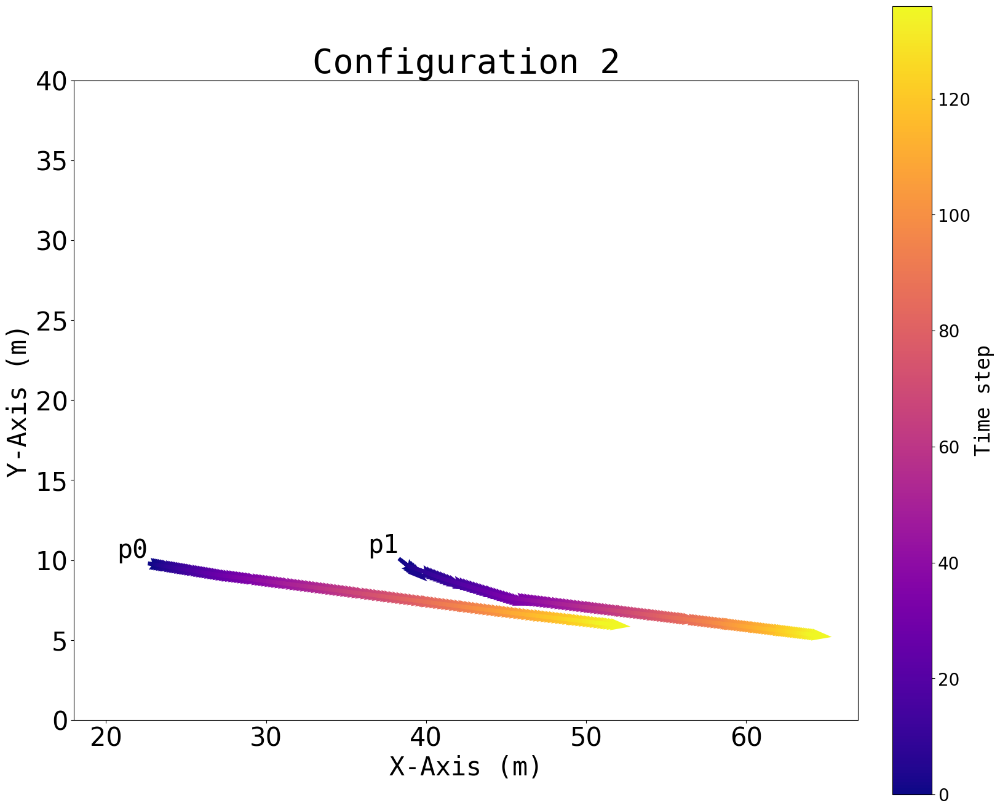

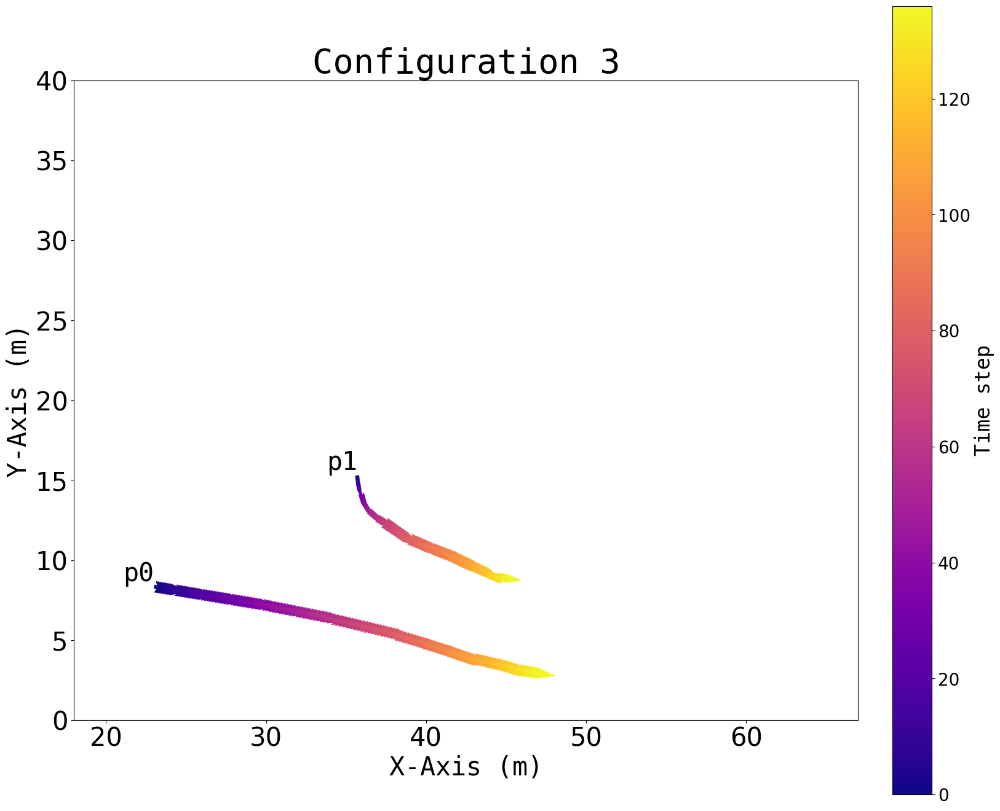

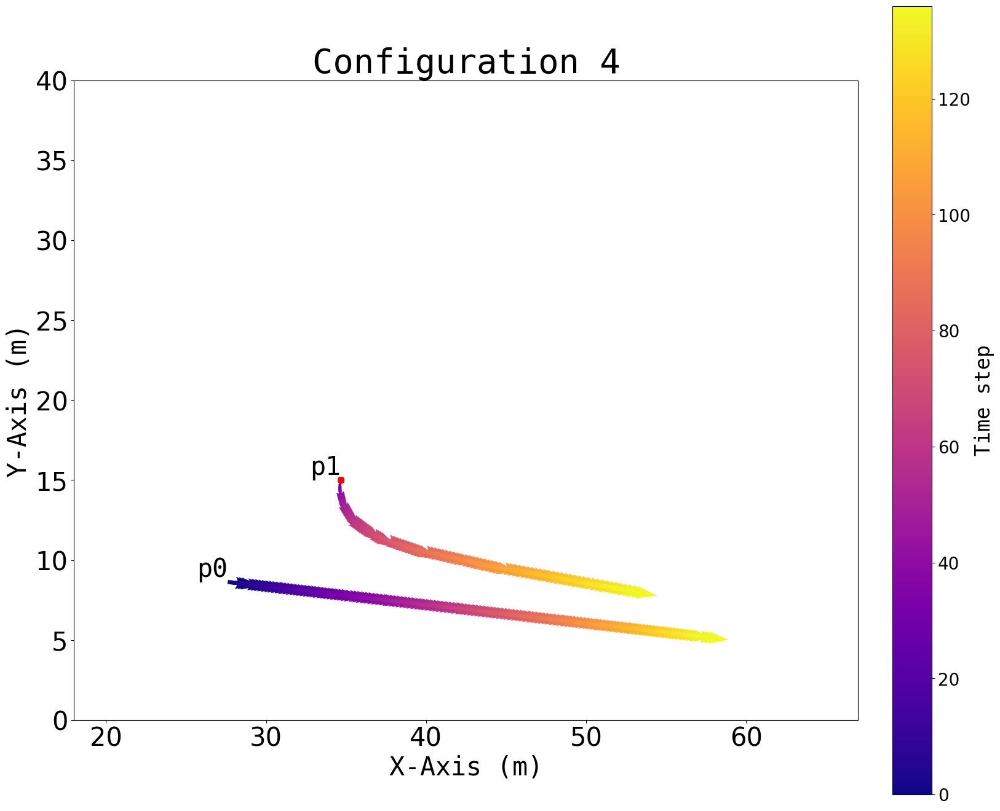

...

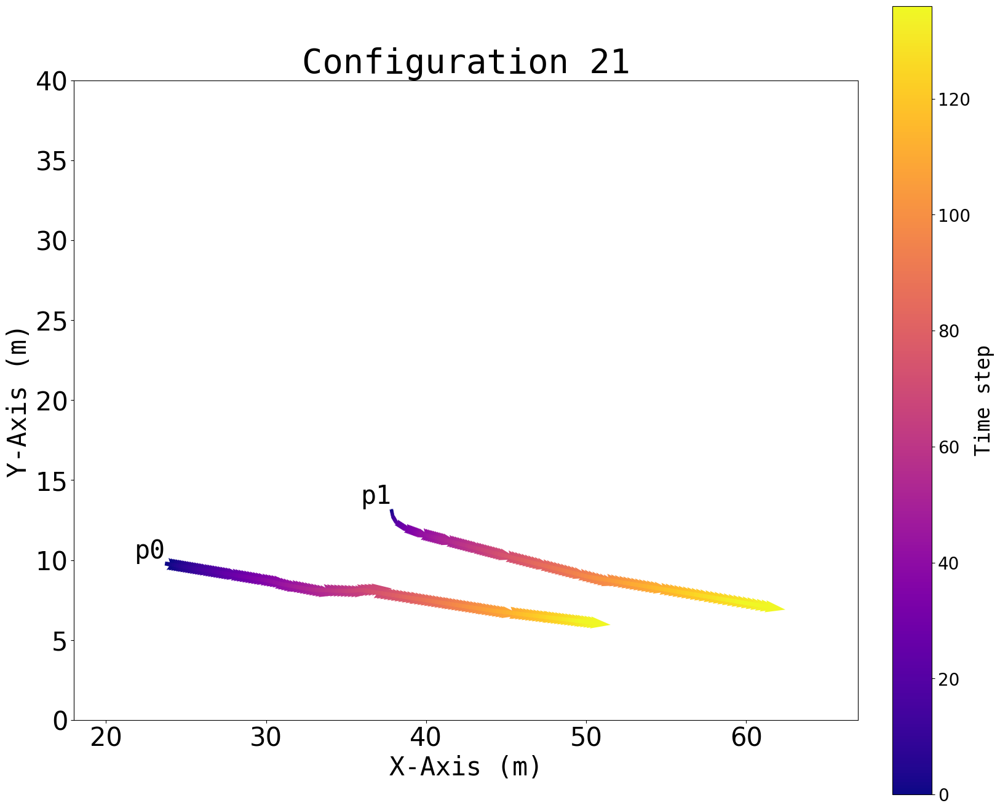

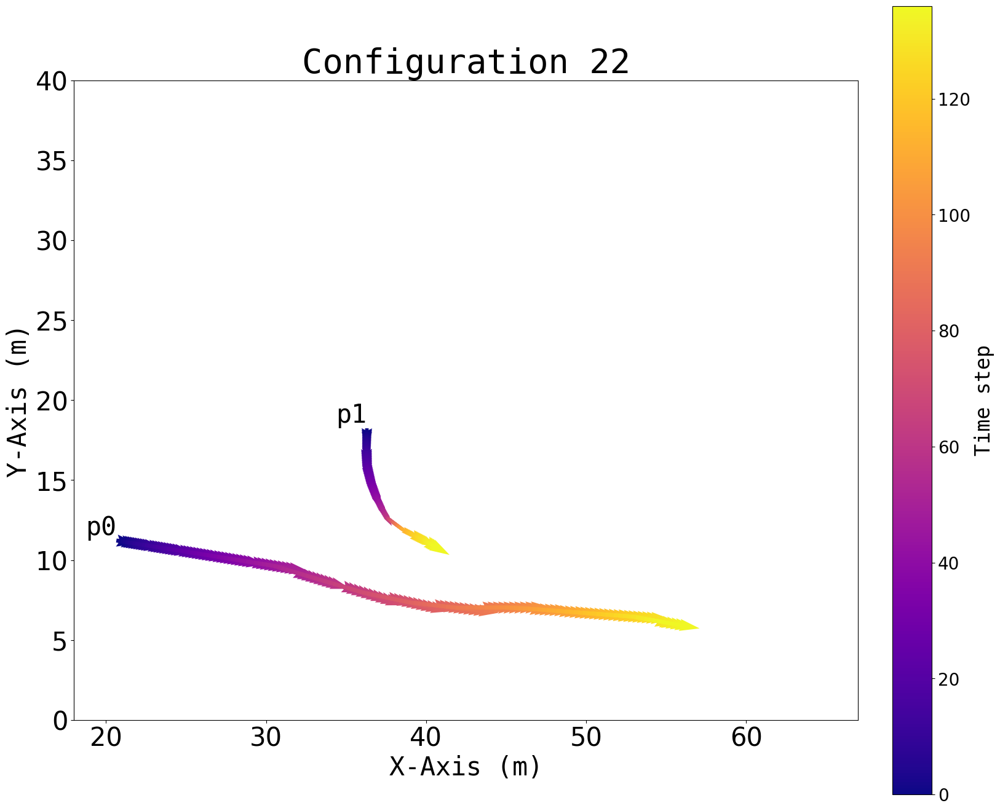

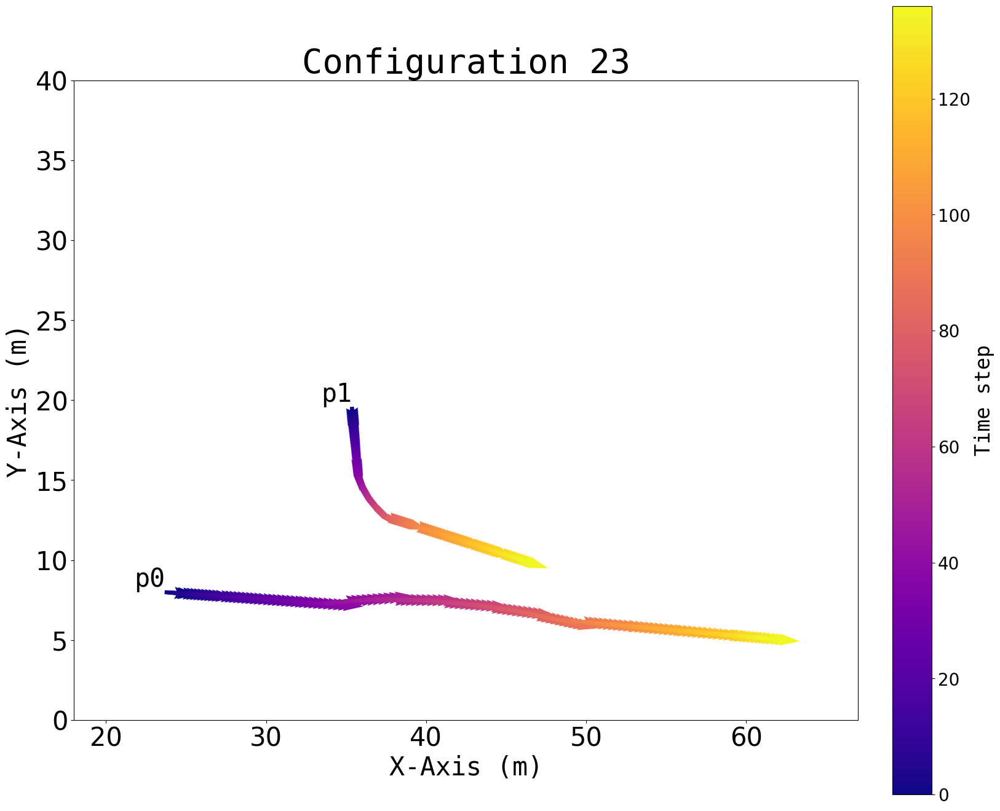

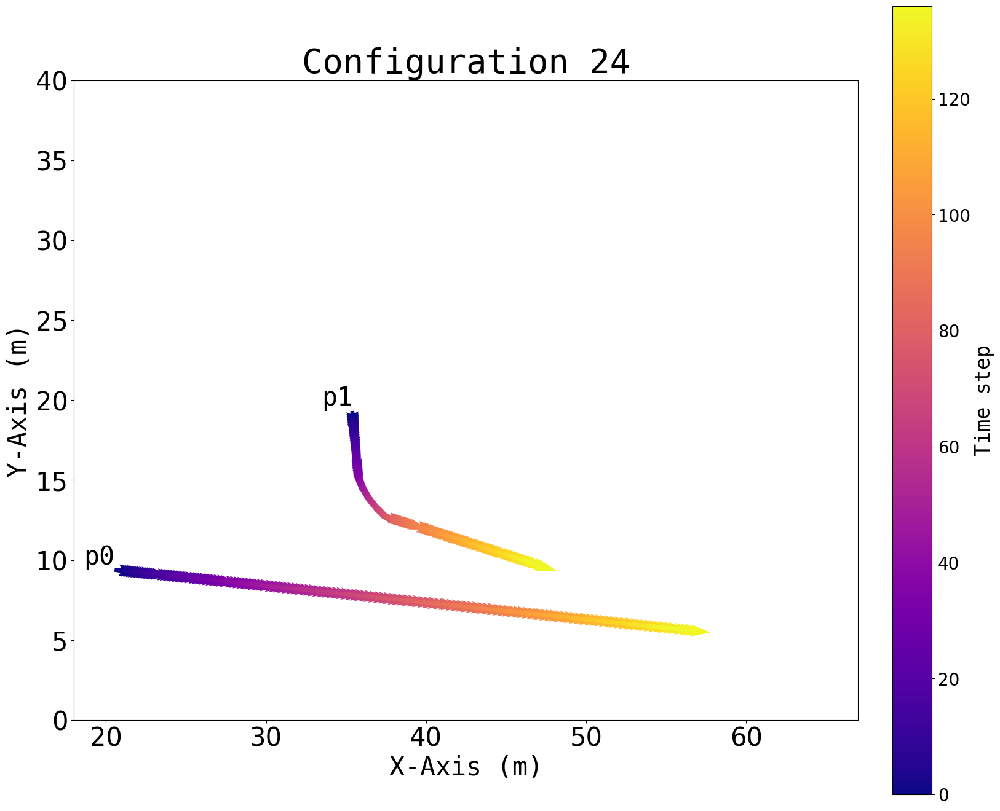

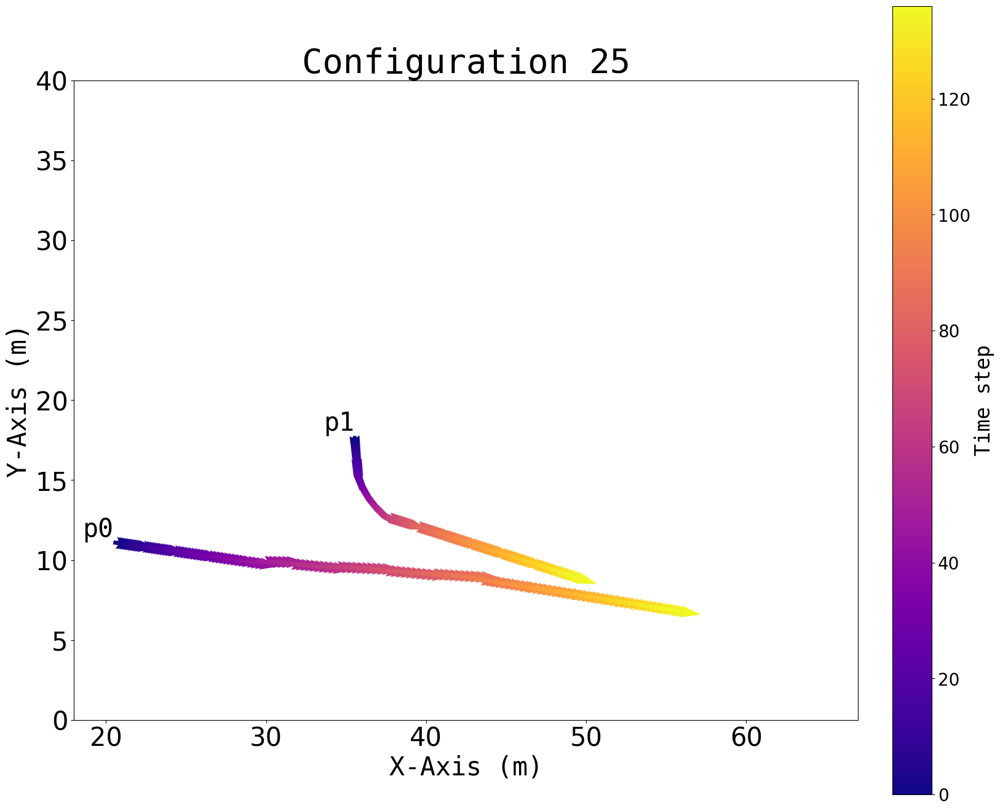

Time elapsed: 5.112 sec.


In [70]:
# N_VA_StaticAbsolute.py

import os
import time

import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize

# Import your custom config (dataset name, poi, tst, boundaries…)
import av

# Start timer
t_start = time.time()
mpl.rcParams['figure.dpi'] = 2.54   # for saving

# Load full dataset
df = pd.read_csv(av.dataset_name, header=None)
configs = df[0].unique()

for config in configs:
    sub = df[df[0] == config]
    X = sub[3].values
    Y = sub[4].values

    # Create figure & equal aspect
    fig, ax = plt.subplots(figsize=(18, 18), dpi=100)
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(labelsize=30)

    # Prepare colormap
    cmap = cm.plasma
    norm = Normalize(vmin=0, vmax=av.tst - 1)

    Q = None
    # Plot trajectories
    for p in range(av.poi):
        xs = X[p::av.poi]
        ys = Y[p::av.poi]
        tvals = np.arange(len(xs))

        u = xs[1:] - xs[:-1]
        v = ys[1:] - ys[:-1]
        moved = (u != 0) | (v != 0)
        static = ~moved

        # moving segments
        if moved.any():
            Q = ax.quiver(
                xs[:-1][moved], ys[:-1][moved],
                u[moved], v[moved],
                tvals[:-1][moved],
                cmap=cmap, norm=norm,
                angles='xy',
                scale_units='xy',
                scale=0.1,
            )
        # static points
        if static.any():
            ax.scatter(
                xs[:-1][static], ys[:-1][static],
                color='red', s=40, linewidths=1.5, zorder=5
            )
        # label start
        ax.text(
            xs[0], ys[0], f'p{p}',
            fontsize=30, fontname='monospace',
            ha='right', va='bottom', color='black'
        )

   
    # Colorbar
    cbar = fig.colorbar(Q, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Time step', fontsize=24, fontname='monospace')
    cbar.ax.tick_params(labelsize=20)

    # Title & save
    ax.set_title(f'Configuration {config}', fontsize=40, fontname='monospace')
    # plt.savefig(f'N_C_Csa{config}.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig)

print(f'Time elapsed: {time.time()-t_start:.3f} sec.')


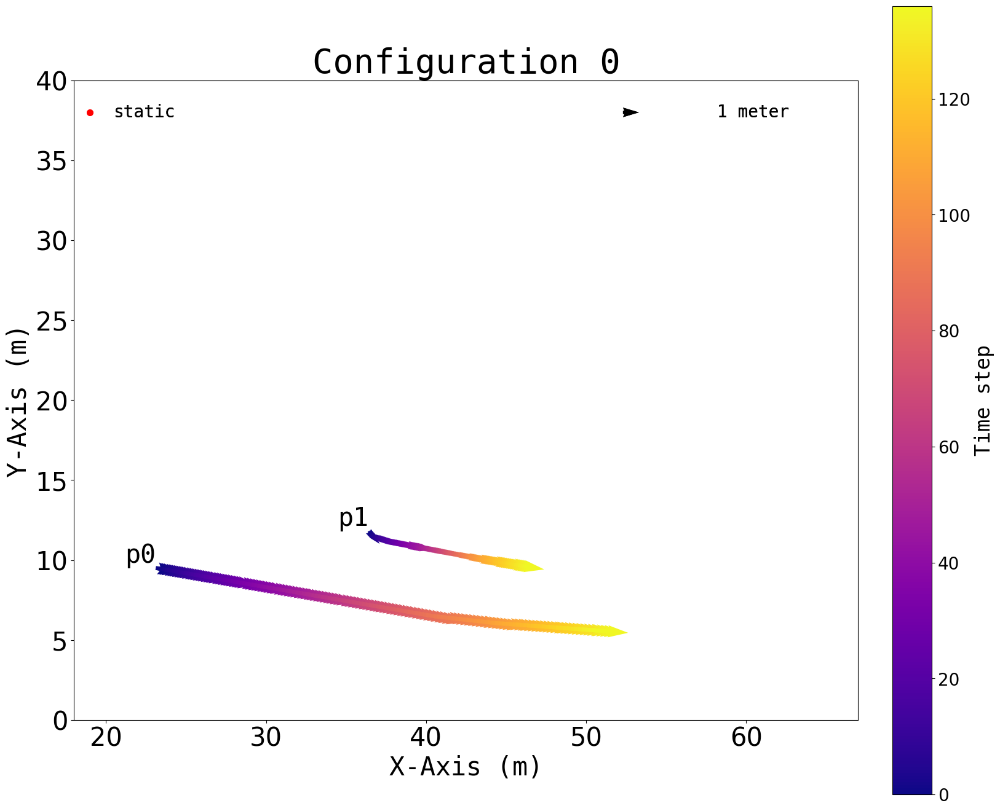

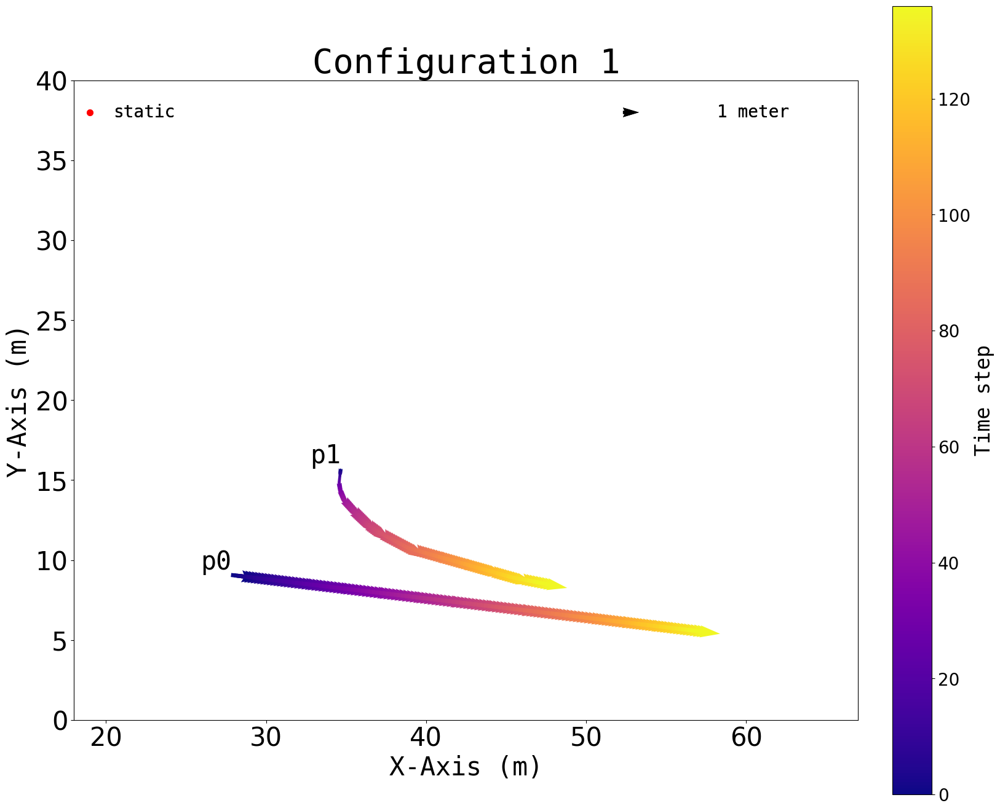

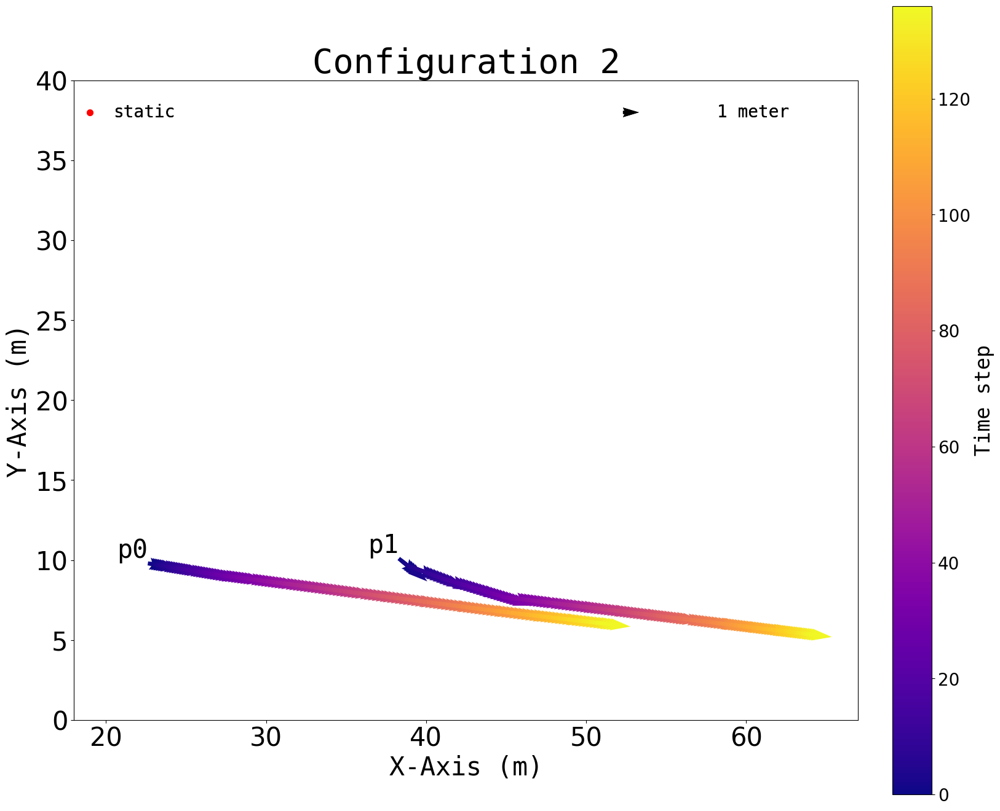

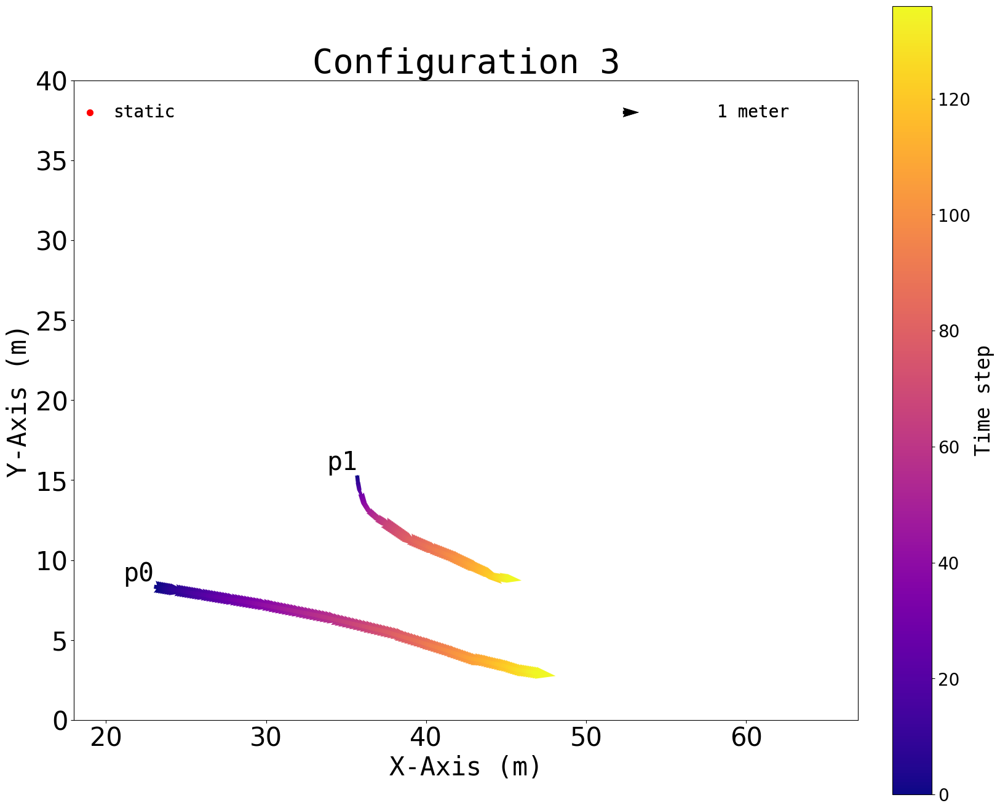

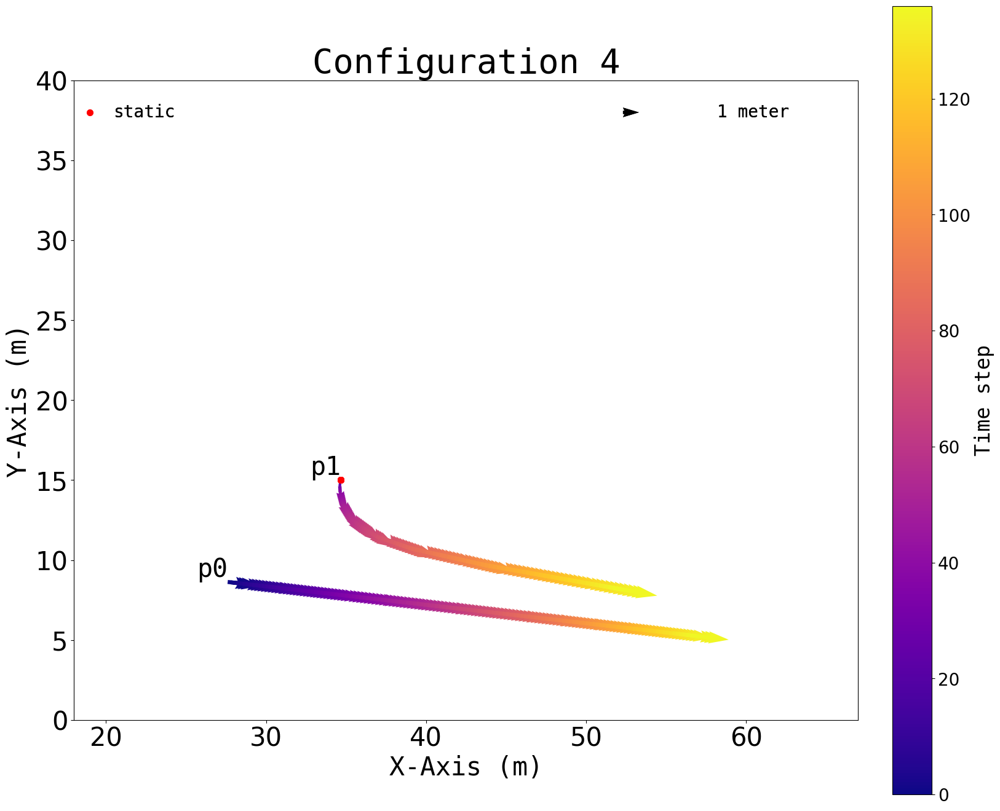

...

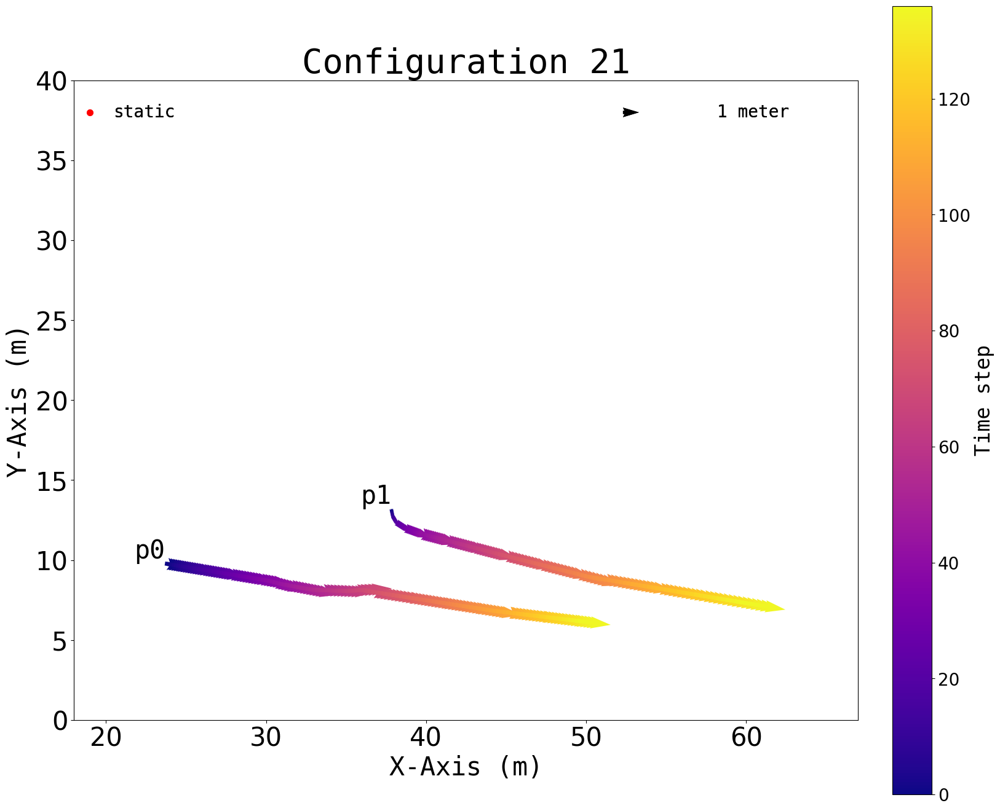

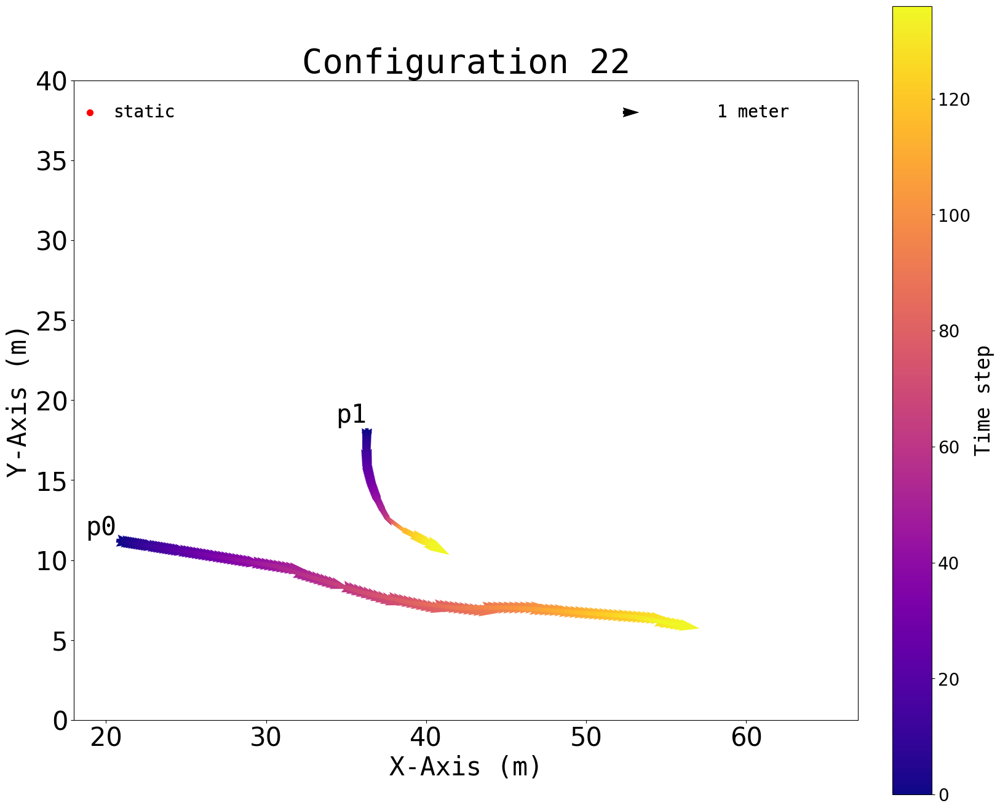

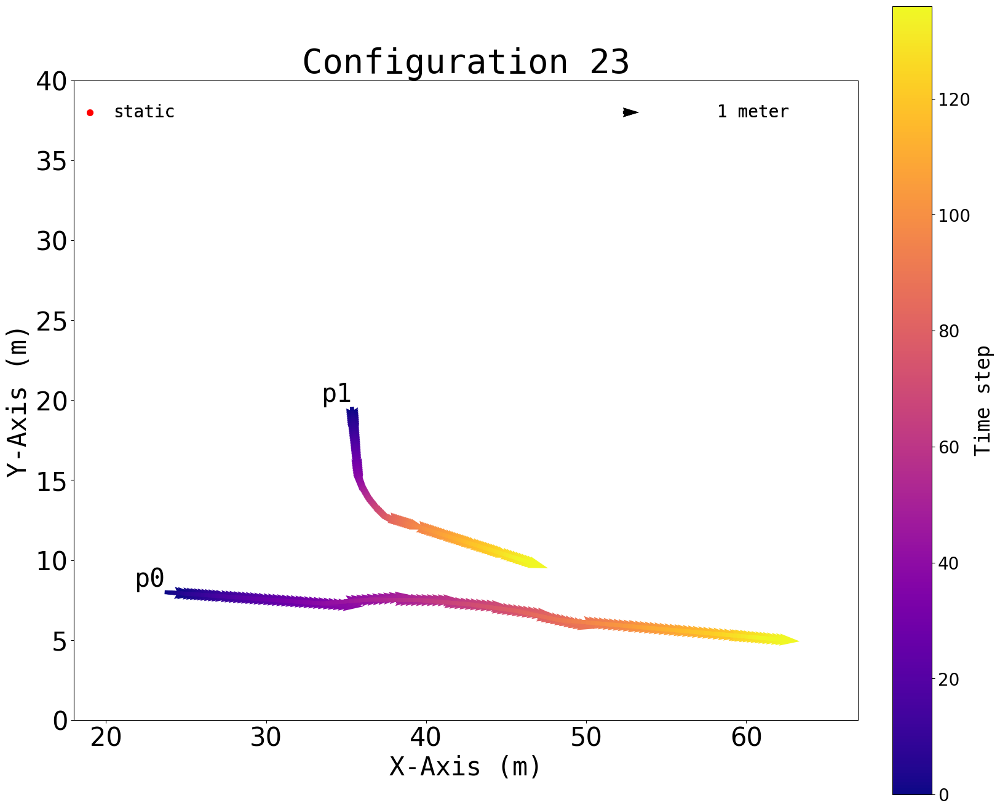

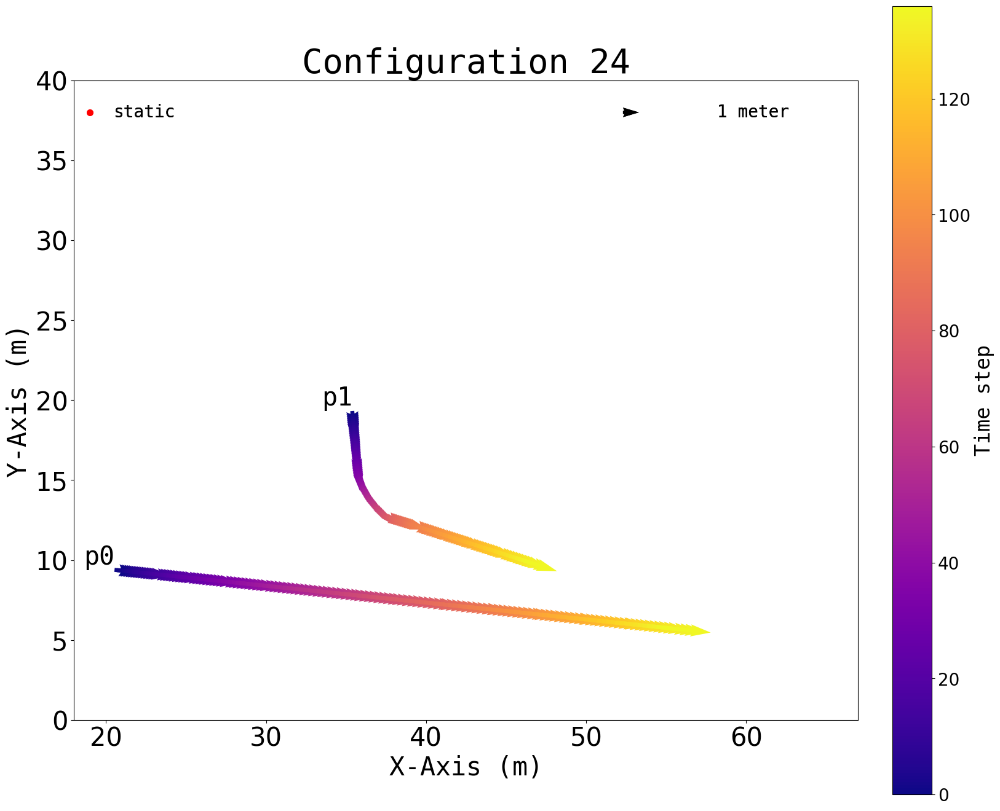

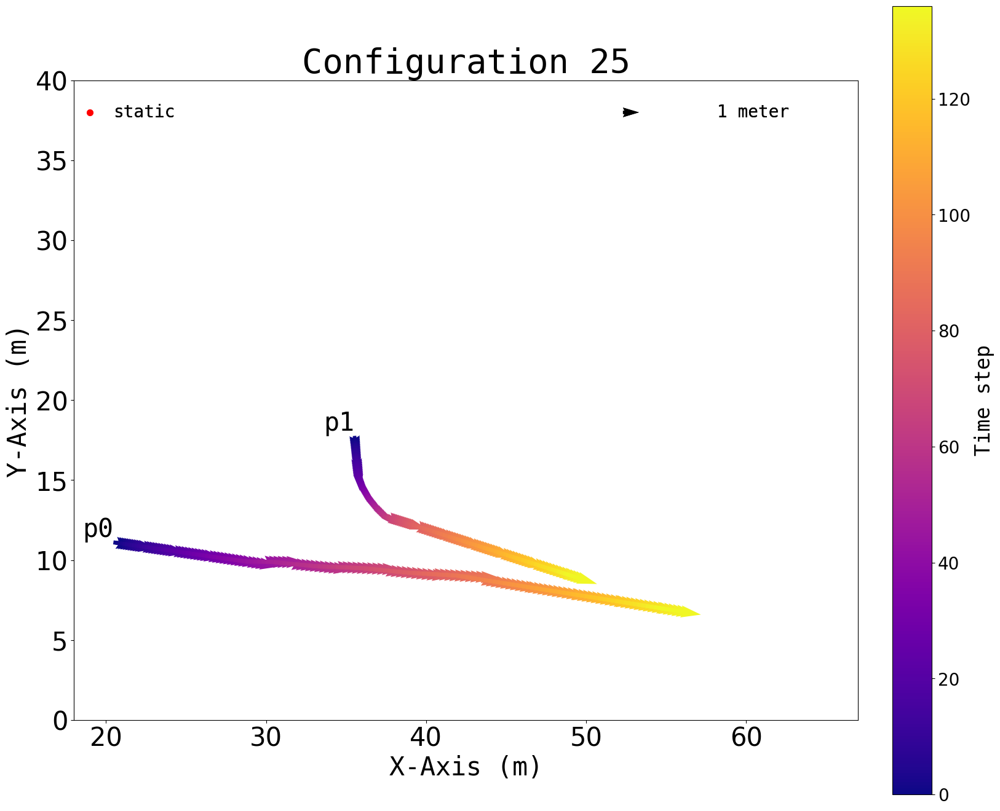

Time elapsed: 6.957 sec.


In [53]:
# N_VA_StaticAbsolute.py

import os
import time

import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize

import av  # your custom config module

t_start = time.time()
mpl.rcParams['figure.dpi'] = 2.54

df = pd.read_csv(av.dataset_name, header=None)
configs = df[0].unique()

for config in configs:
    sub = df[df[0] == config]
    X = sub[3].values
    Y = sub[4].values

    fig, ax = plt.subplots(figsize=(18, 18), dpi=100)
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(labelsize=30)

    cmap = cm.plasma
    norm = Normalize(vmin=0, vmax=av.tst - 1)

    Q = None
    for p in range(av.poi):
        xs = X[p::av.poi]
        ys = Y[p::av.poi]
        tvals = np.arange(len(xs))

        u = xs[1:] - xs[:-1]
        v = ys[1:] - ys[:-1]
        moved = (u != 0) | (v != 0)
        static = ~moved

        if moved.any():
            Q = ax.quiver(
                xs[:-1][moved], ys[:-1][moved],
                u[moved], v[moved],
                tvals[:-1][moved],
                cmap=cmap, norm=norm,
                angles='xy',
                scale_units='xy',
                scale=0.1,
            )

        if static.any():
            ax.scatter(
                xs[:-1][static], ys[:-1][static],
                color='red', s=40, linewidths=1.5, zorder=5
            )

        ax.text(
            xs[0], ys[0], f'p{p}',
            fontsize=30, fontname='monospace',
            ha='right', va='bottom', color='black'
        )

        # 1) draw the “static” red dot legend in axes‐fraction coordinates
        ax.scatter(
            [0.02], [0.95],
            transform=ax.transAxes,
            color='red', s=40,
            linewidths=1.5, zorder=10
        )
        ax.text(
            0.05, 0.95,
            'static',
            transform=ax.transAxes,
            va='center',
            fontsize=20,
            fontname='monospace'
        )
        
        # 2) draw the “1 meter” arrow exactly as before, but in axes coords
        ax.quiver(
            [0.7], [0.95],
            [0.1], [0.0],
            transform=ax.transAxes,
            angles='xy', scale_units='xy', scale=0.1,
            color='black',
        )
        ax.text(
            0.82, 0.95,
            '1 meter',
            transform=ax.transAxes,
            va='center',
            fontsize=20,
            fontname='monospace'
        )

    # Colorbar for time
    cbar = fig.colorbar(Q, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Time step', fontsize=24, fontname='monospace')
    cbar.ax.tick_params(labelsize=20)

    ax.set_title(f'Configuration {config}', fontsize=40, fontname='monospace')
    # plt.savefig(f'N_C_Csa{config}.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig)

print(f'Time elapsed: {time.time()-t_start:.3f} sec.')


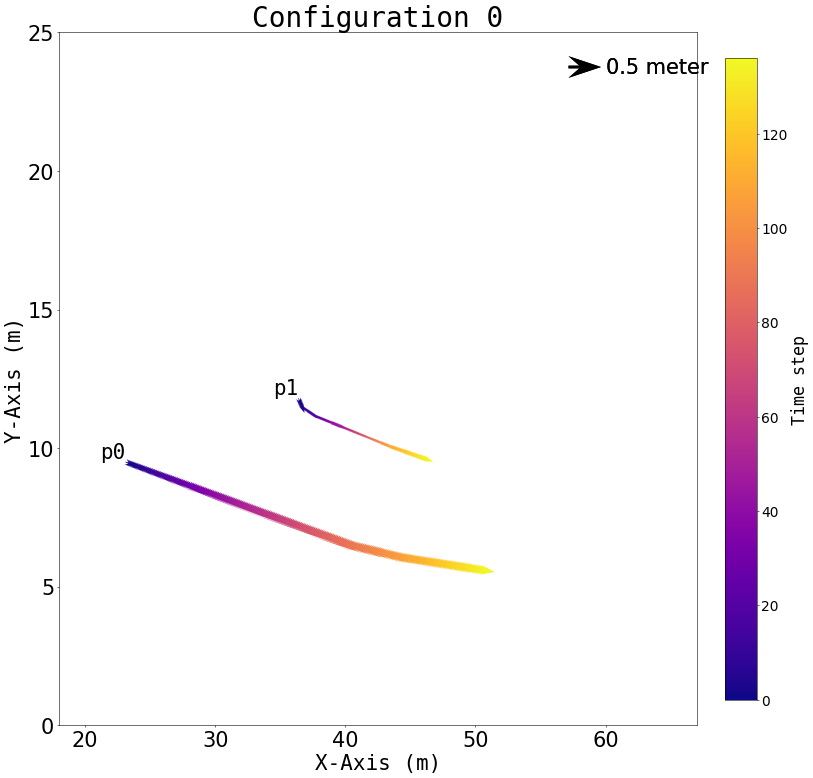

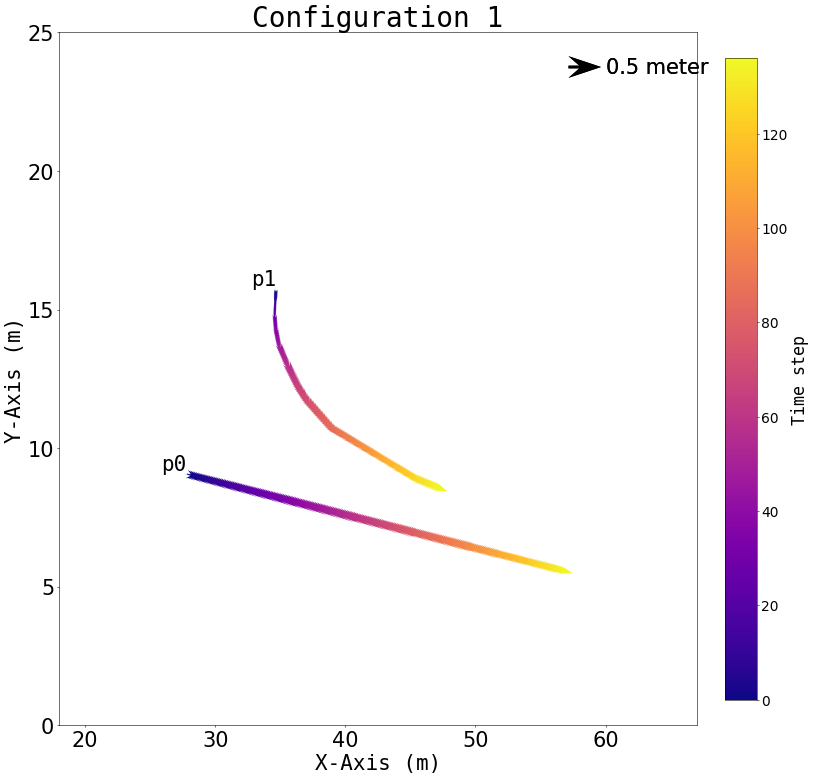

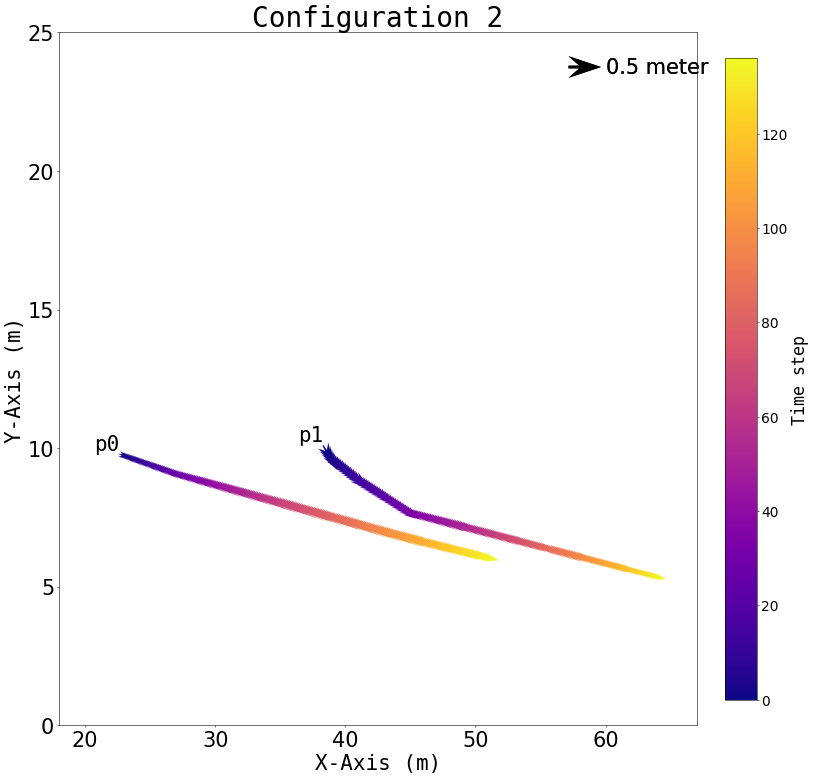

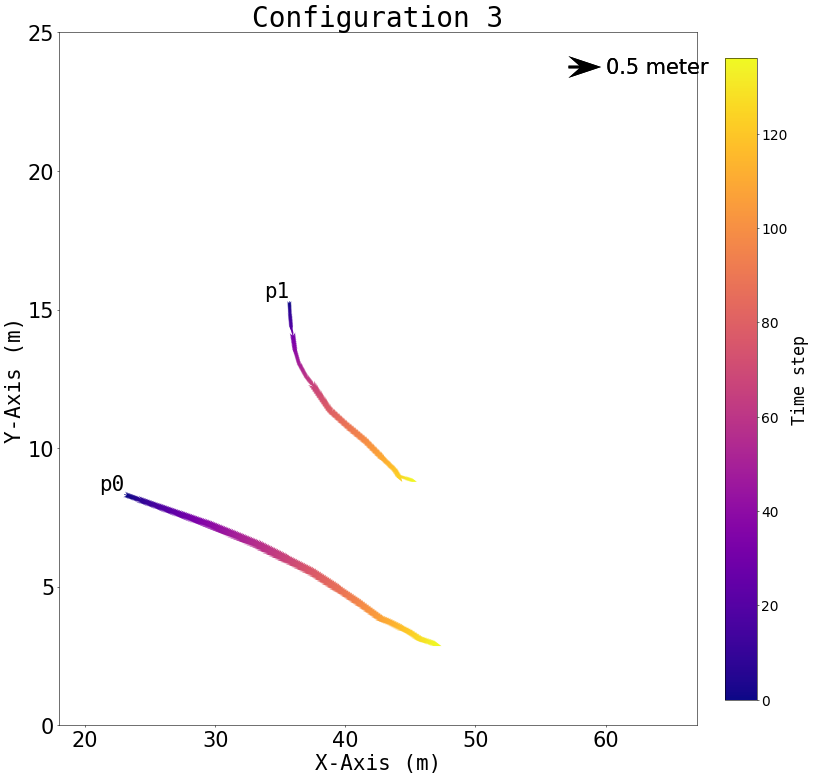

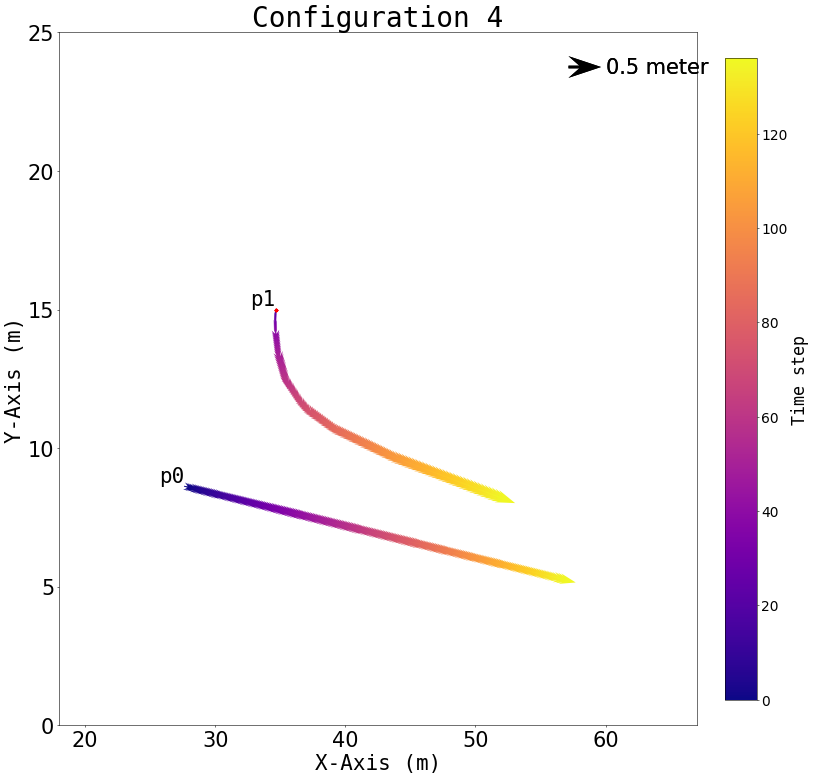

...

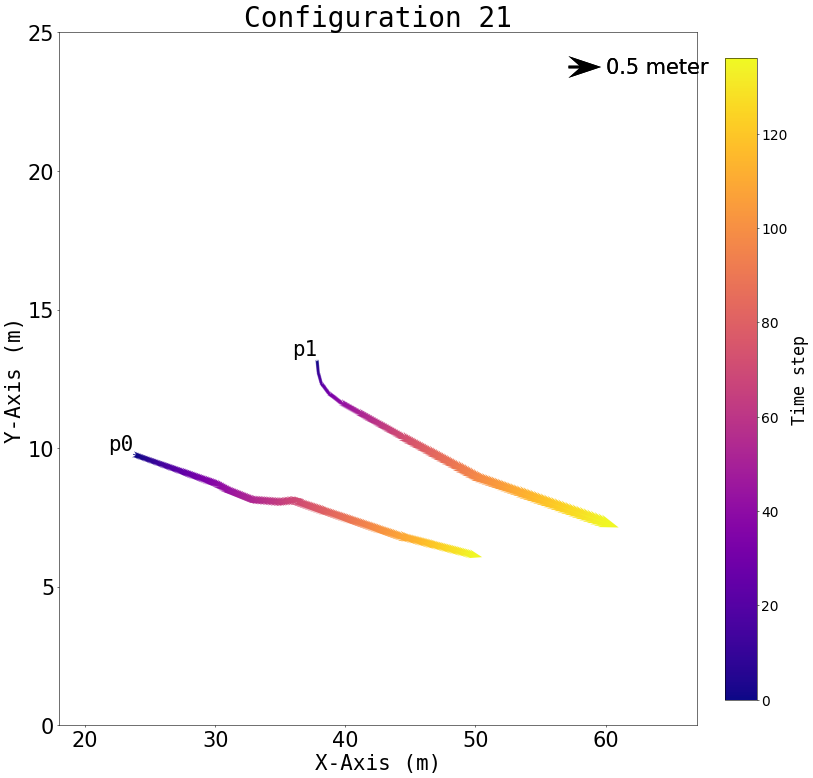

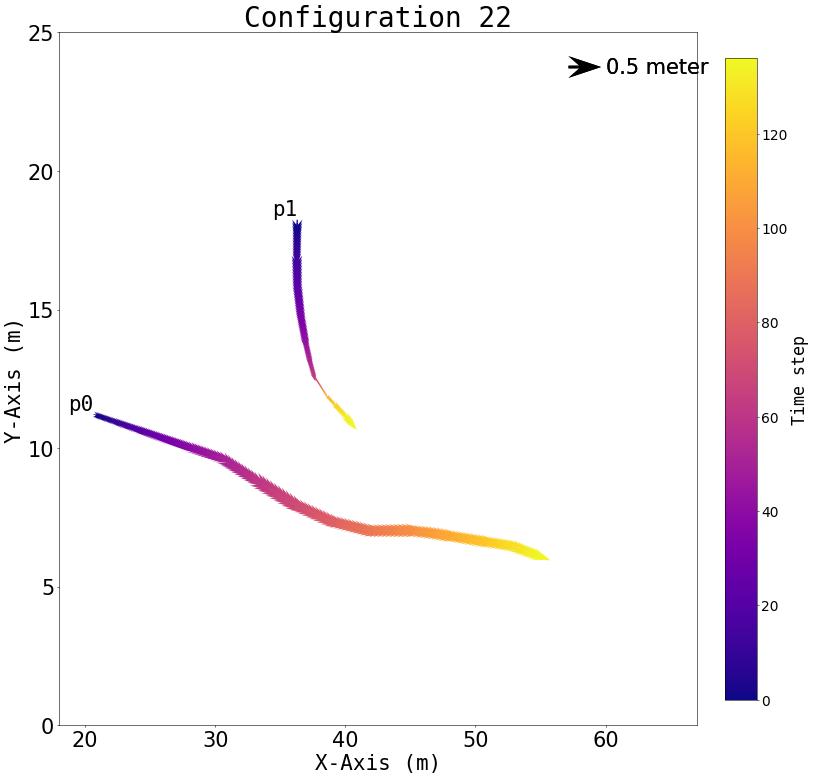

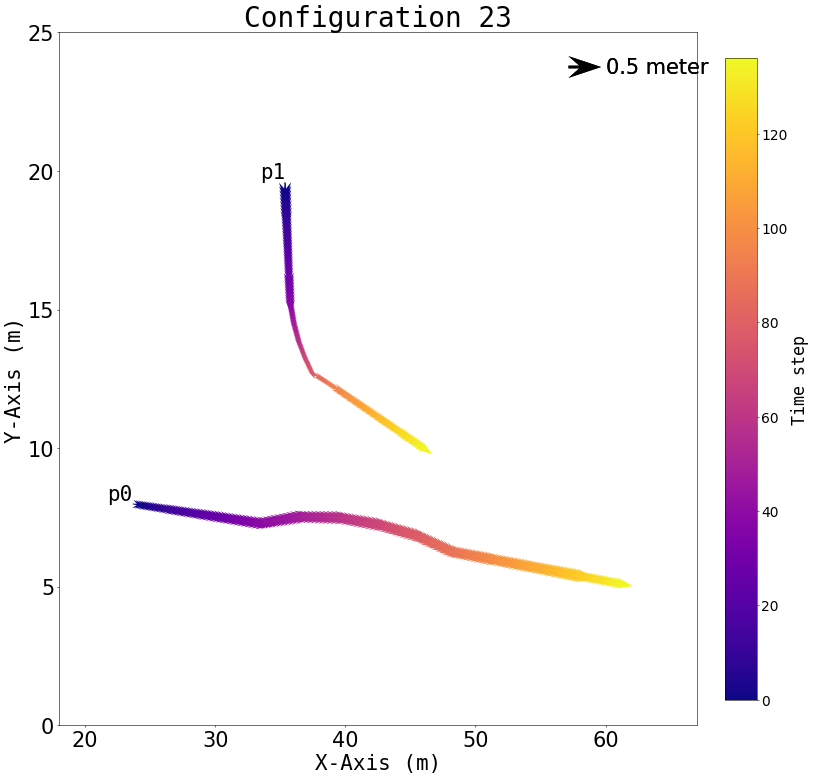

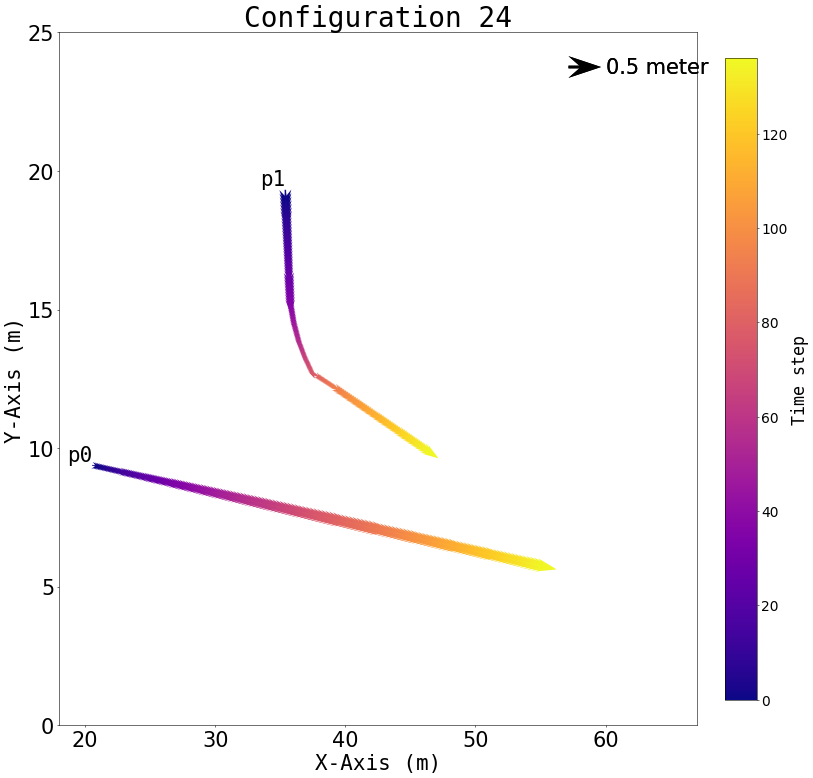

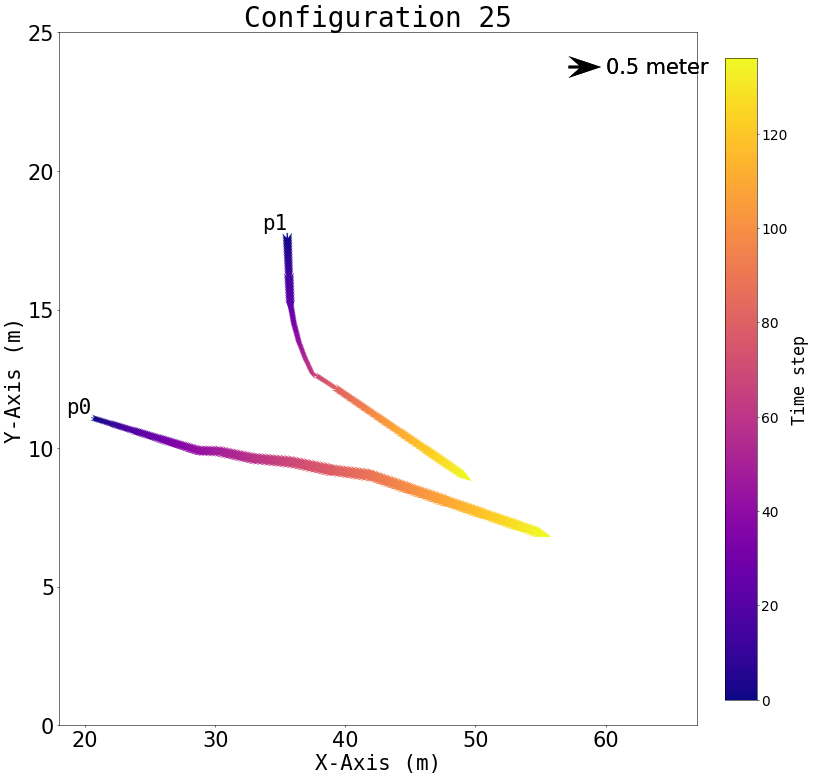

Time elapsed for running module "N_VA_StaticAbsolute": 24.053 sec.


In [59]:
# Start timer
t_start = time.time()

# Use centimeters as the base unit
mpl.rcParams['figure.dpi'] = 2.54

# Load the full dataset
df = pd.read_csv(av.dataset_name, header=None)

# Each unique value in column 0 is a different configuration
configurations = df[0].unique()

for config in configurations:
    # Filter rows for this configuration
    config_data = df[df[0] == config]

    # Extract X/Y columns (columns 3 and 4)
    x = config_data[3]
    y = config_data[4]

    # Create the plot
    fig, ax = plt.subplots(figsize=(18, 18), dpi=50)
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')

    # Prepare a high-contrast colormap (start → end)
    cmap = cm.plasma
    norm = Normalize(vmin=0, vmax=av.tst - 1)

    # ScalarMappable for the colorbar
    sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])

    # Plot each point’s trajectory as colored arrows + red dots for static
    for p in range(av.poi):
        xs = x.iloc[p::av.poi].values
        ys = y.iloc[p::av.poi].values
        t   = np.arange(len(xs))  # [0, 1, ..., av.tst-1]

        # compute displacement vectors
        u = xs[1:] - xs[:-1]
        v = ys[1:] - ys[:-1]
        tvals = t[:-1]

        # mask: moved vs static
        moved_mask  = (u != 0) | (v != 0)
        static_mask = ~moved_mask

        # 1) 画移动段的箭头
        if np.any(moved_mask):
            # Draw arrows, colored by time step
            Q = ax.quiver(
                xs[:-1],
                ys[:-1],  # arrow bases
                u,
                v,  # arrow vectors
                t[:-1],  # color value per arrow
                cmap=cmap,
                norm=norm,
                angles="xy",
                scale_units="xy",
                scale=0.2,
                width=0.02,
                headwidth=8,
                headlength=12,
                headaxislength=8,
                minlength=0.1,
            )
            
            ax.quiverkey(Q, 0.85, 0.95, 0.5,
                 label='0.5 meter', labelpos='E',fontproperties={'size':30})

        # 2) 画静止段的红点
        if np.any(static_mask):
            ax.scatter(
                xs[:-1][static_mask], ys[:-1][static_mask],
                color='red',
                s=10,
                # edgecolors='k',
                linewidths=1.5,
                zorder=5
            )

        # Label the starting point
        ax.text(
            xs[0], ys[0],
            f'p{p}',
            fontsize=30,
            fontname='monospace',
            ha='right', va='bottom',
            color='black'
        )
        

    # Add a standalone colorbar
    cbar = fig.colorbar(sm, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Time step', fontsize=24, fontname='monospace')
    cbar.ax.tick_params(labelsize=20)

    # Title and save
    ax.set_title(f'Configuration {config}', fontname='monospace', fontsize=40)
    output_name = f'N_C_Csa{config}.png'

    plt.savefig(output_name, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig)

print(f'Time elapsed for running module "N_VA_StaticAbsolute": {time.time() - t_start:.3f} sec.')


NameError: name 'tvals' is not defined

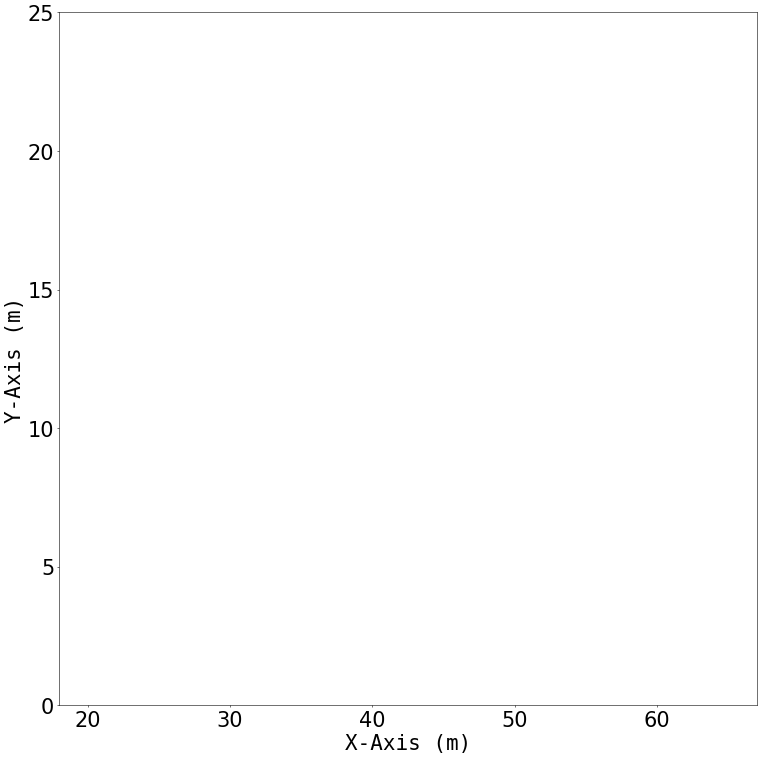

In [2]:
# Start timer
t_start = time.time()

# Use centimeters as the base unit
mpl.rcParams["figure.dpi"] = 2.54

# Load the full dataset
df = pd.read_csv(av.dataset_name, header=None)

# Each unique value in column 0 is a different configuration
configurations = df[0].unique()

for config in configurations:
    # Filter rows for this configuration
    config_data = df[df[0] == config]

    # Extract X/Y columns (columns 3 and 4)
    x = config_data[3]
    y = config_data[4]

    # Create the plot
    fig, ax = plt.subplots(figsize=(18, 18), dpi=50)
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    ax.set_xlabel("X-Axis (m)", fontsize=30, fontname="monospace")
    ax.set_ylabel("Y-Axis (m)", fontsize=30, fontname="monospace")
    ax.tick_params(axis="both", labelsize=30, labelcolor="black")

    # Prepare a high-contrast colormap (start → end)
    cmap = cm.plasma  # strong yellow→purple contrast
    norm = Normalize(vmin=0, vmax=av.tst - 1)

    # We'll use a ScalarMappable for the colorbar later
    sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])

    # Plot each point’s trajectory as colored arrows
    for p in range(av.poi):
        # Get this point's time-ordered positions
        xs = x.iloc[p :: av.poi].values
        ys = y.iloc[p :: av.poi].values
        t = np.arange(len(xs))  # [0, 1, ..., av.tst-1]

        # Compute displacement vectors for quiver
        u = xs[1:] - xs[:-1]
        v = ys[1:] - ys[:-1]

        # Draw arrows, colored by time step
        Q = ax.quiver(
            xs[:-1],
            ys[:-1],  # arrow bases
            u,
            v,  # arrow vectors
            t[:-1],  # color value per arrow
            cmap=cmap,
            norm=norm,
            angles="xy",
            scale_units="xy",
            scale=0.2,
            width=0.02,
            headwidth=8,
            headlength=12,
            headaxislength=8,
            minlength=0.1,
        )
        
        ax.quiverkey(Q, 0.85, 0.95, 1,
             label='1 meter', labelpos='E',fontproperties={'size':30})
        
        # Label the starting point
        ax.text(
            xs[0],
            ys[0],
            f"p{p}",
            fontsize=30,
            fontname="monospace",
            ha="right",
            va="bottom",
            color="black",
        )

    # Add a standalone colorbar
    cbar = fig.colorbar(sm, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label("Time step", fontsize=24, fontname="monospace")
    cbar.ax.tick_params(labelsize=20)

    # Title and save
    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    output_name = f"N_C_Csa{config}1.png"
    plt.savefig(output_name, dpi=300, bbox_inches='tight')
    plt.show()


print(
    f'Time elapsed for running module "N_VA_StaticAbsolute": {time.time() - t_start:.3f} sec.'
)

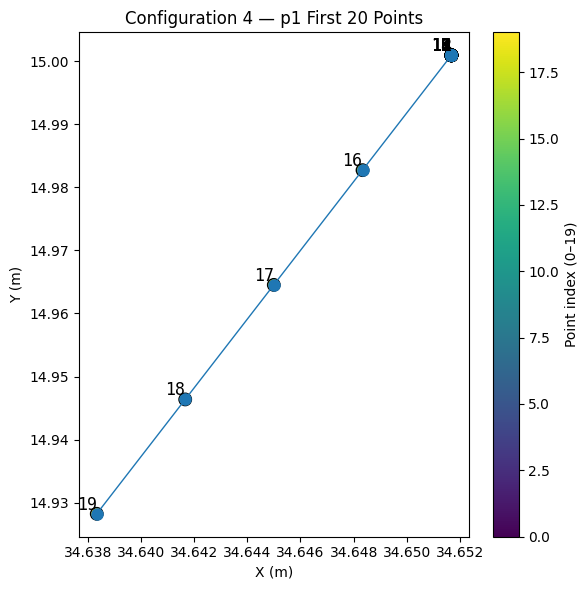

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rc_context

# 1. 直接读取数据集
df = pd.read_csv('N_C_Dataset.csv', header=None)
df.columns = ['conID', 'tstID', 'poiID', 'x', 'y']

# 2. 筛选 Configuration 4, poiID == 1 (p1)
config4 = df[df['conID'] == 4]
p1_data = config4[config4['poiID'] == 1]

# 3. 取前 20 个时间步的数据
first20 = p1_data.sort_values('tstID').iloc[:20]
xs = first20['x'].values
ys = first20['y'].values

# 4. 绘制
with rc_context({'figure.dpi': 100}):
    fig, ax = plt.subplots(figsize=(6, 6))
    indices = np.arange(len(xs))
    sc = ax.scatter(xs, ys,
                    c=indices,
                    cmap='viridis',
                    s=80,
                    edgecolors='k')
    ax.plot(xs, ys, '-o', linewidth=1, markersize=8)

    for idx, (xi, yi) in enumerate(zip(xs, ys)):
        ax.text(xi, yi, str(idx),
                fontsize=12,
                fontname='monospace',
                ha='right', va='bottom')

    plt.colorbar(sc, label='Point index (0–19)')
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    ax.set_title('Configuration 4 — p1 First 20 Points')
    plt.tight_layout()
    plt.show()


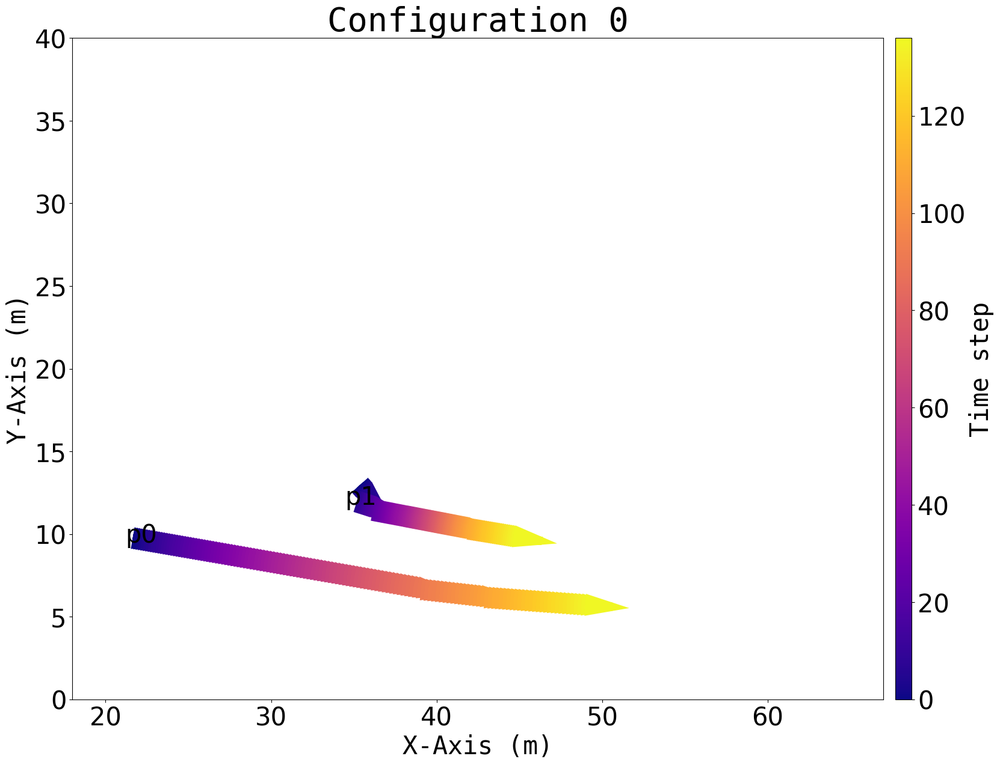

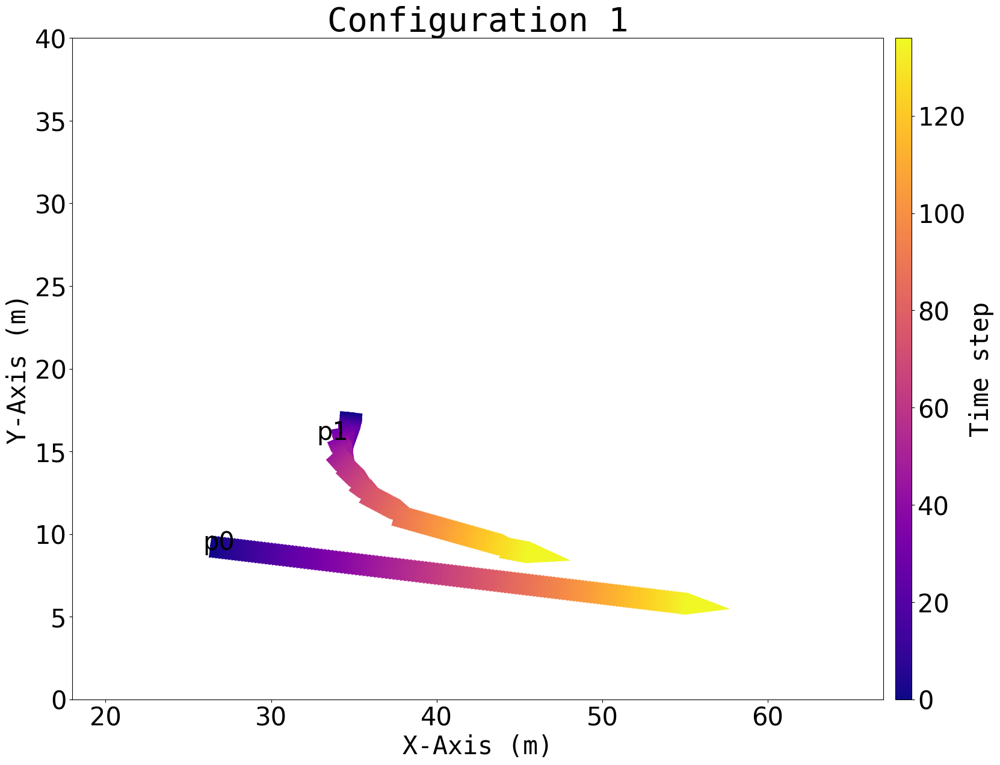

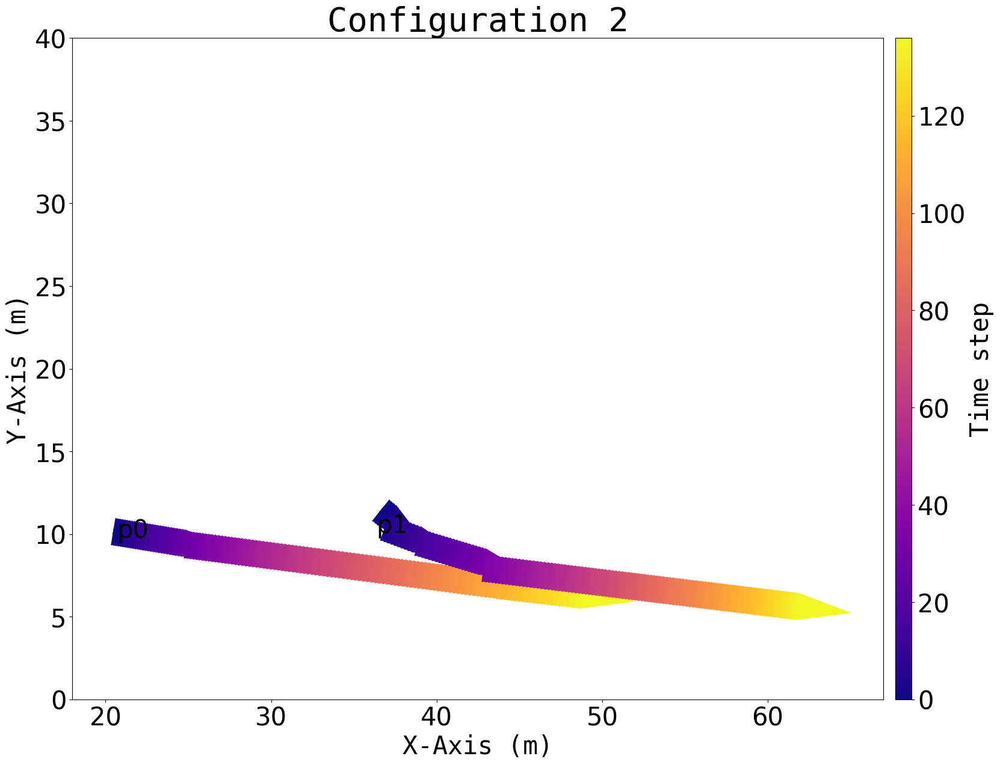

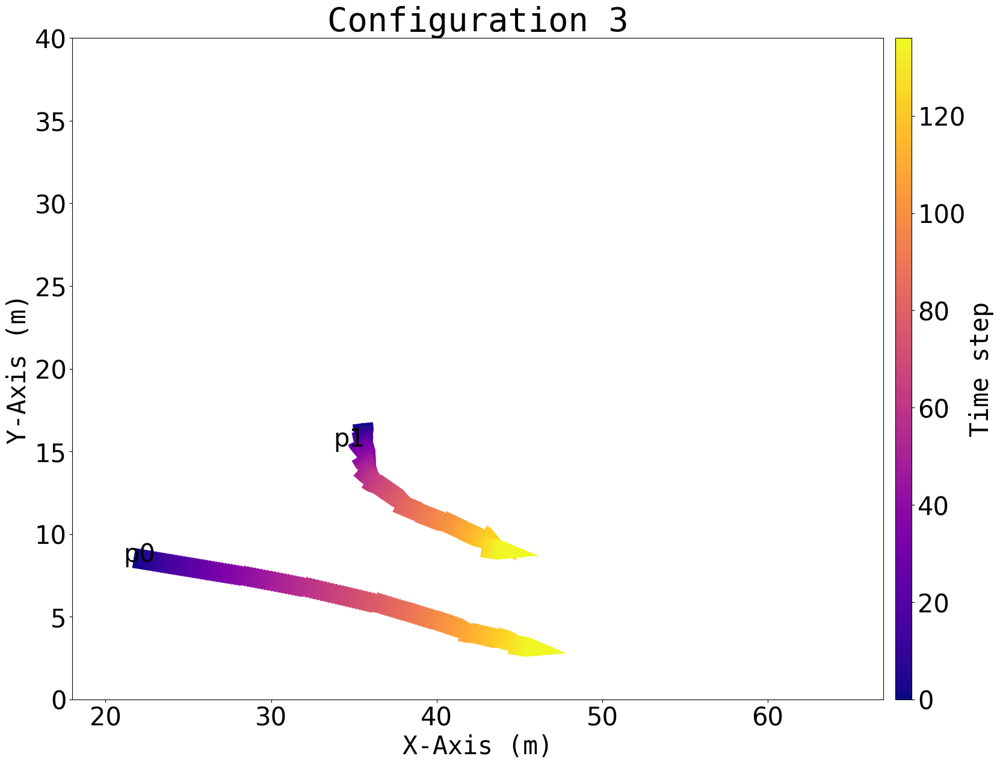

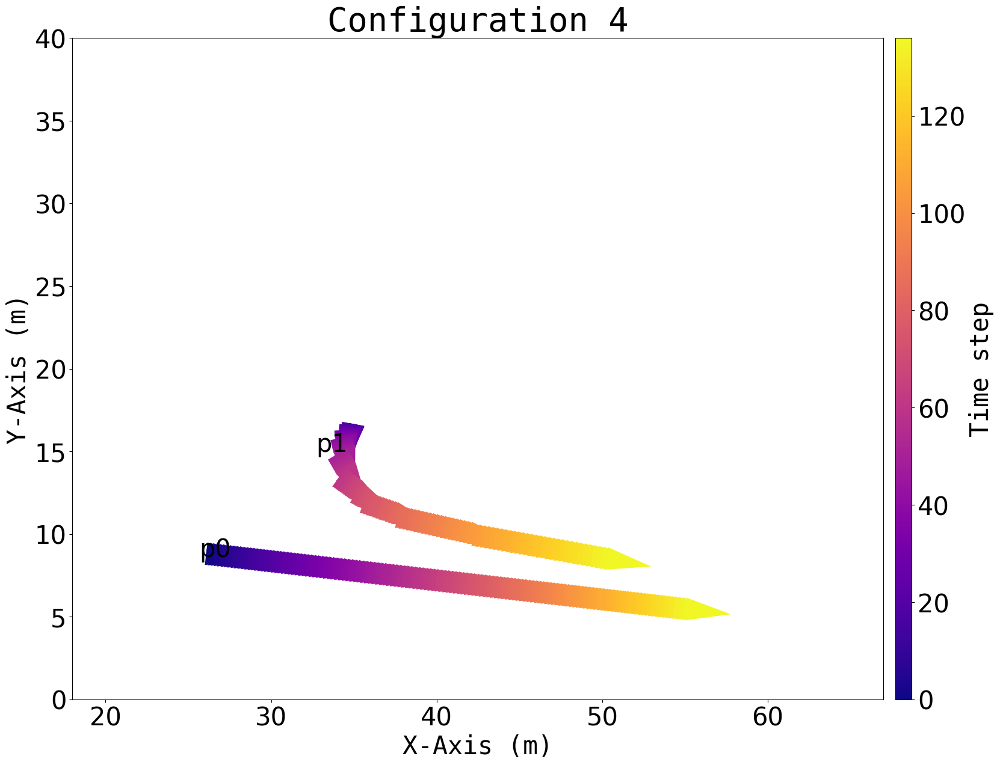

...

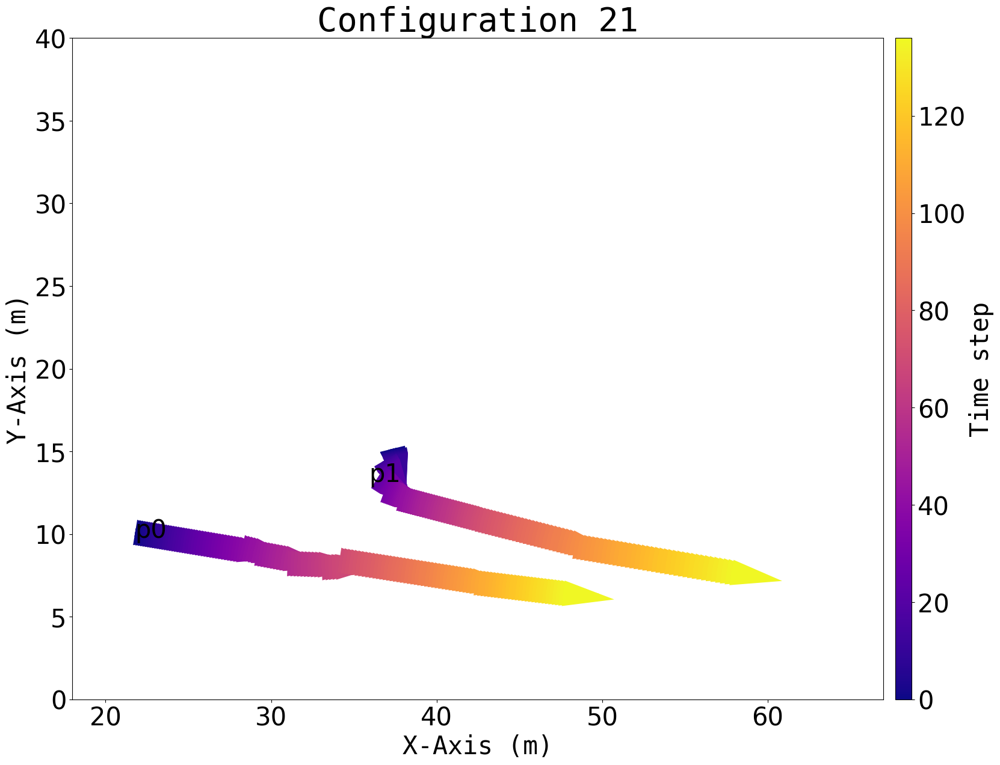

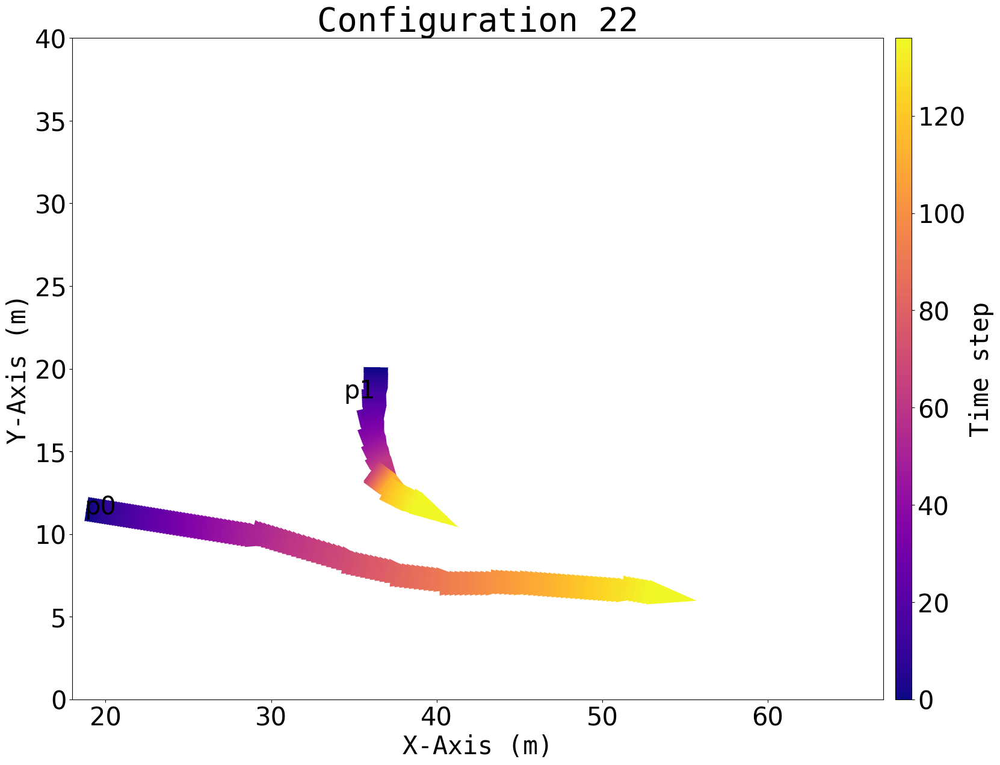

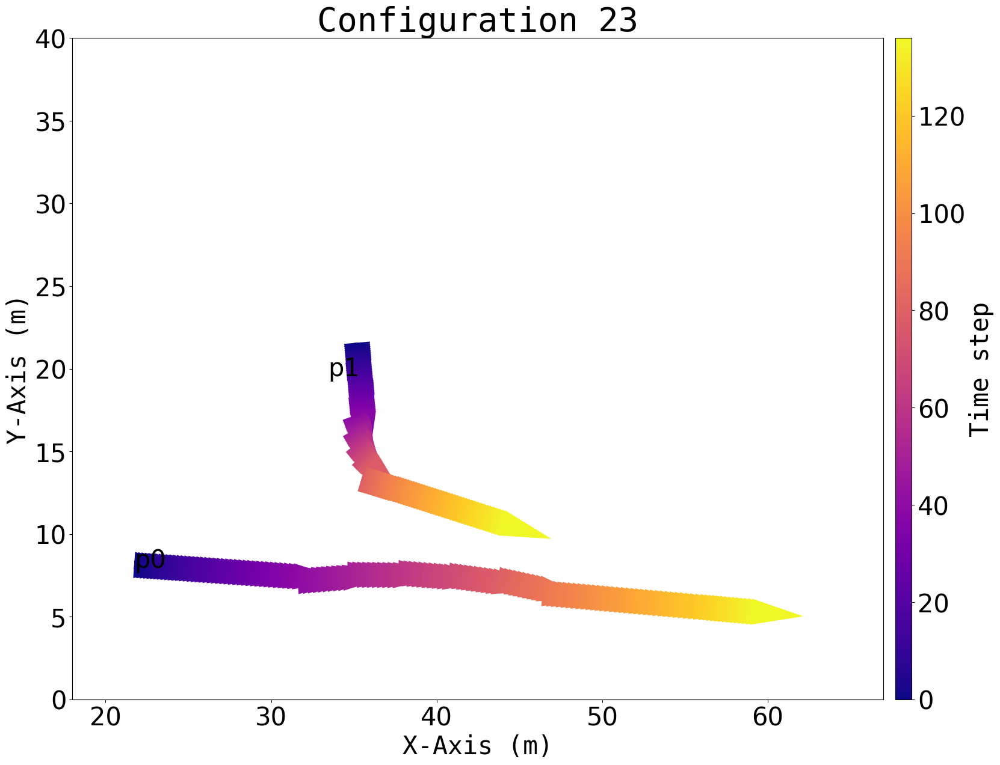

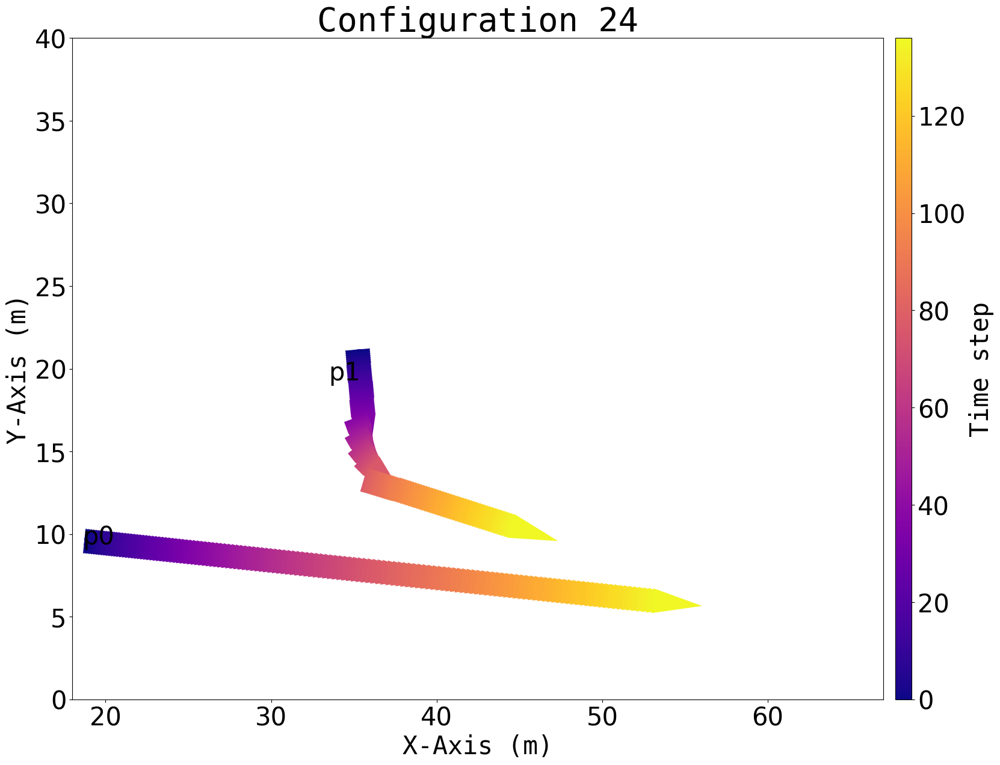

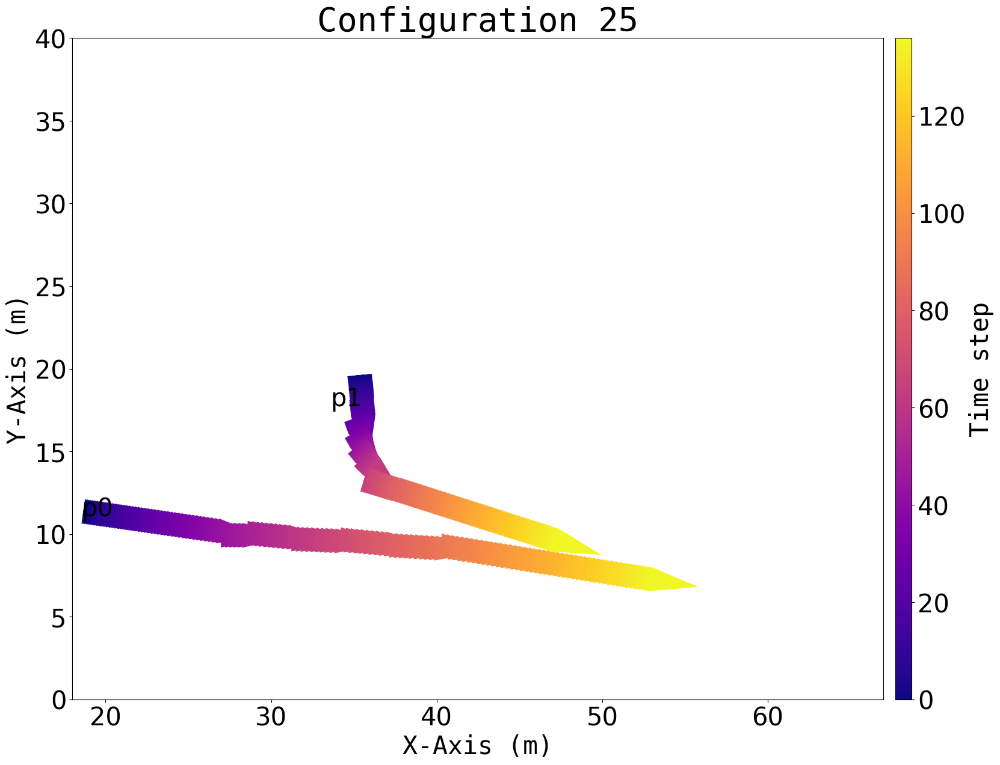

Time elapsed for running module "N_VA_StaticAbsolute": 8.748 sec.


In [84]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# Start time
t_start = time.time()

# Set the default unit of length to centimeters
mpl.rcParams['figure.dpi'] = 2.54

# Load the dataset
df = pd.read_csv(av.dataset_name, header=None)

# Get the unique values of the first column
configurations = df[0].unique()

# Create a list of colors for scatter when only one timestamp
if av.poi == 3:
    colors = ['black', 'blue', 'magenta']
else:
    colors = [plt.cm.cividis(i/av.poi) for i in range(av.poi)]

# Define colormap for time sequence (plasma)
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1  # number of arrow intervals per point

# Create the scatterplot, including arrows
for config in configurations:
    config_data = df[df[0] == config]  # Get the data for the current configuration
    
    # Get the x/y-values
    x = config_data[3]
    y = config_data[4]
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)

    # Set the limits of the axes
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    
    # Set the labels of the axes
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')  
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    # Ensure equal aspect ratio
    ax.set_aspect('equal', adjustable='box')

    # Plot data
    if av.tst == 1:
        for point_index, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[point_index % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                color_to_use = cmap_time(i / num_intervals)
                ax.arrow(
                    x1, y1, x2 - x1, y2 - y1,
                    length_includes_head=True,
                    head_width=(x.max() - x.min())/40,
                    head_length=(x.max() - x.min())/20,
                    linewidth=10,
                    color=color_to_use
                )
                if i == 0:
                    ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')

    # Add colorbar for time sequence with same height as y-axis and aligned
    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

    # Title and save
    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    file_name = f"N_C_Csa{config}.png"
    # fig.savefig(file_name, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig)

# End and print time
print(f'Time elapsed for running module "N_VA_StaticAbsolute": {time.time() - t_start:.3f} sec.')

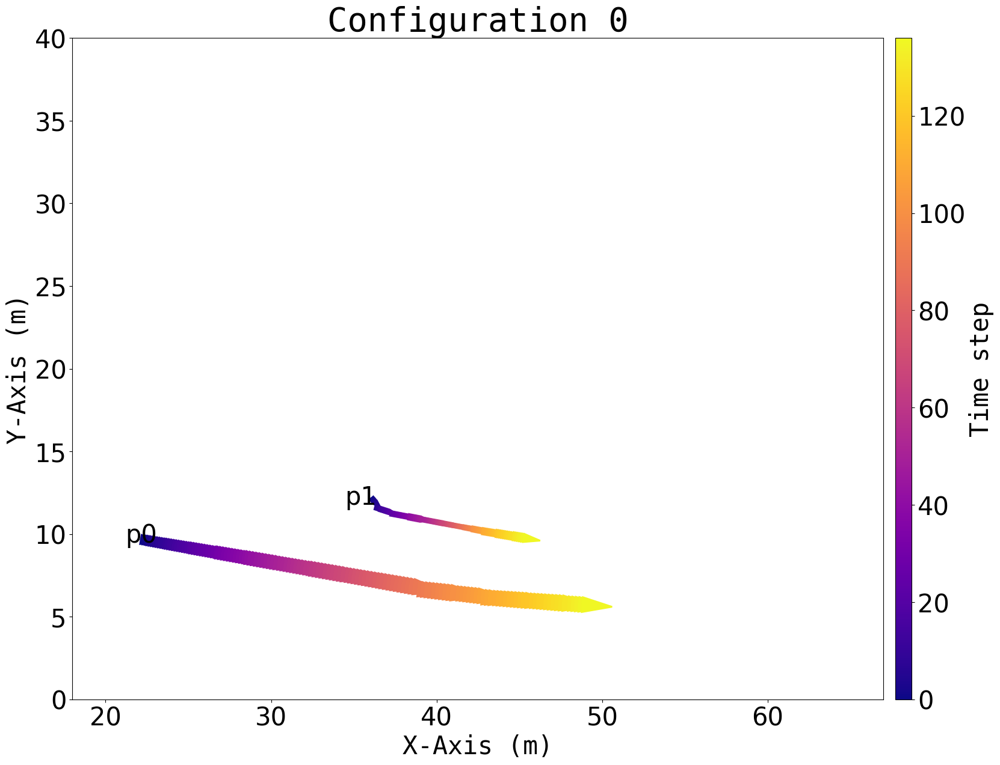

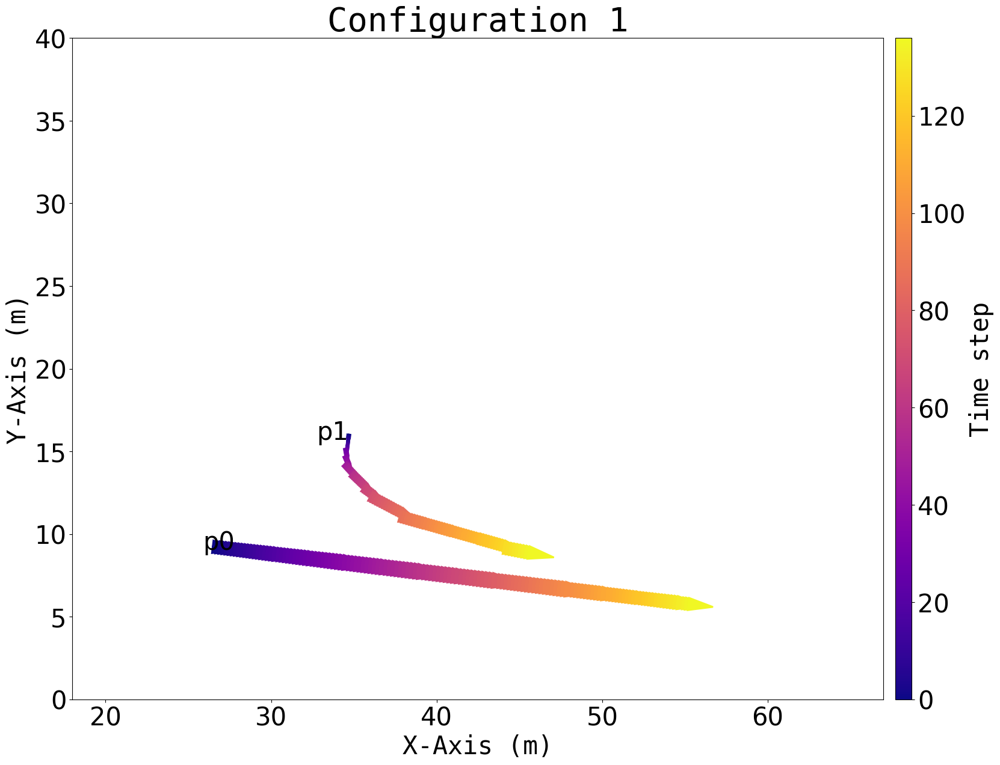

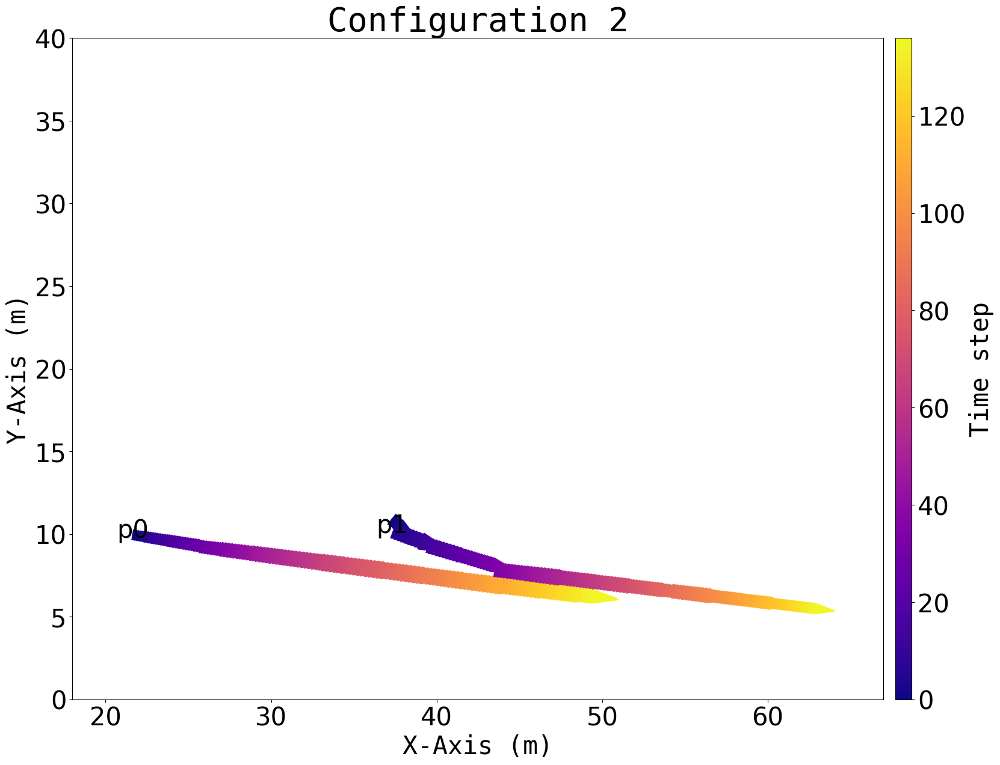

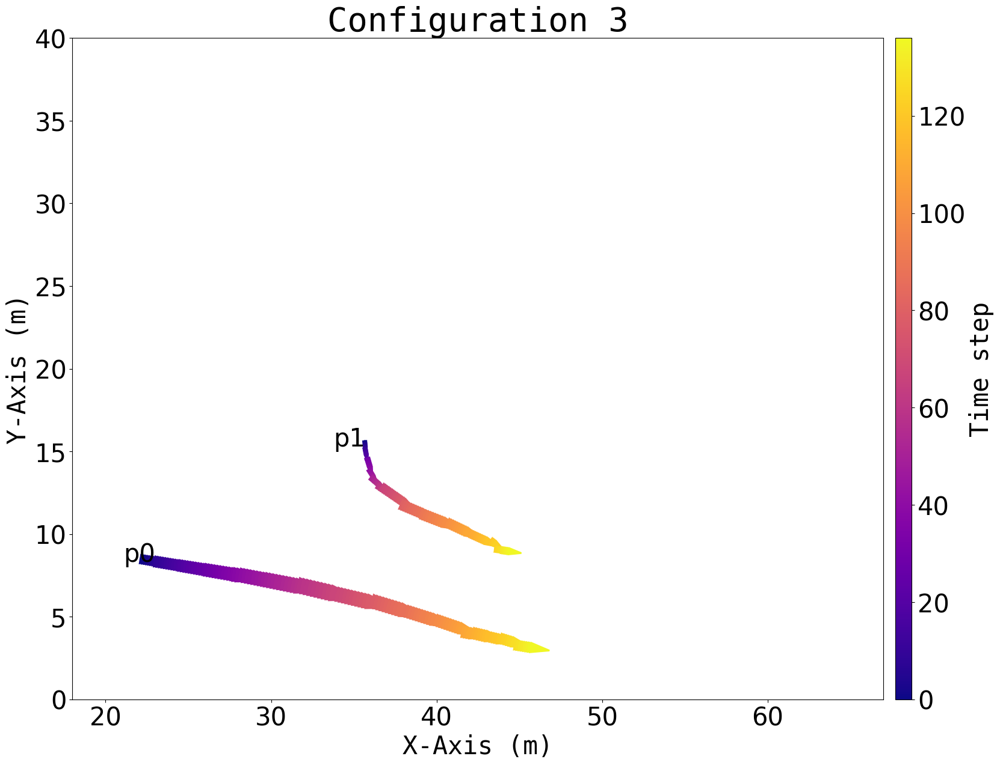

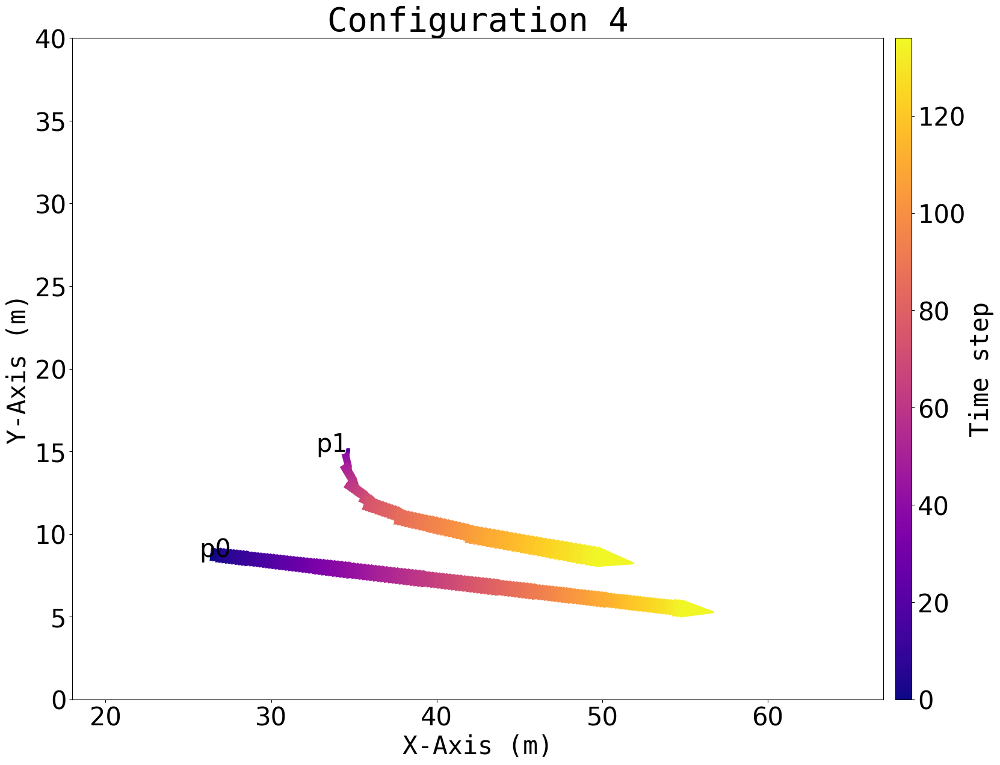

...

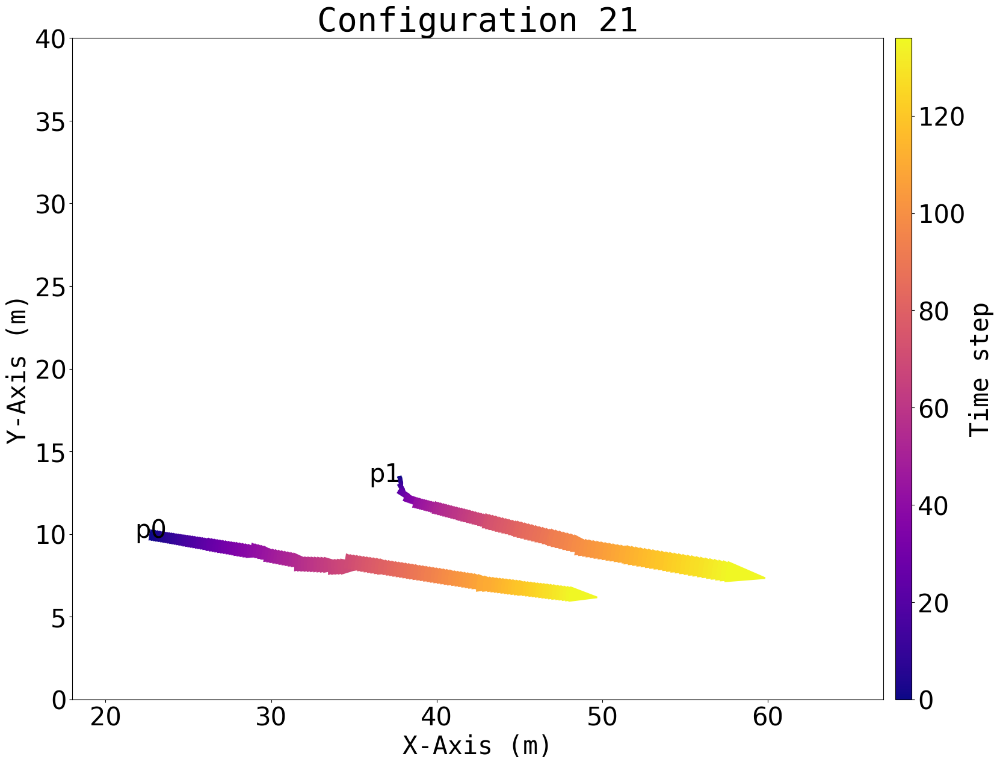

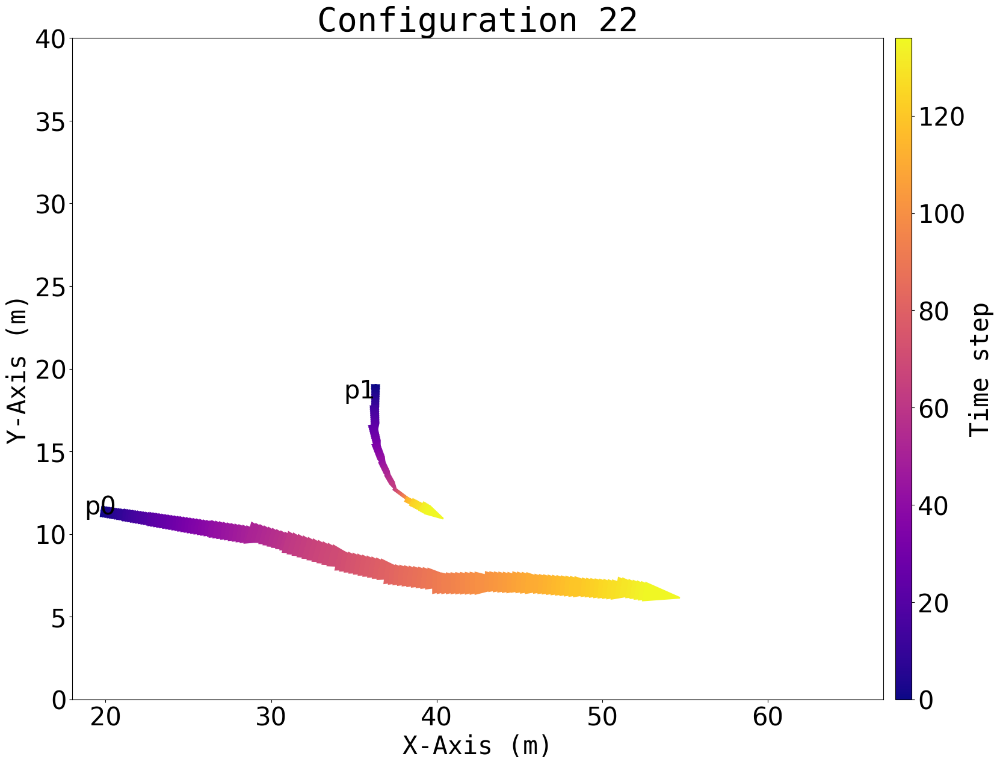

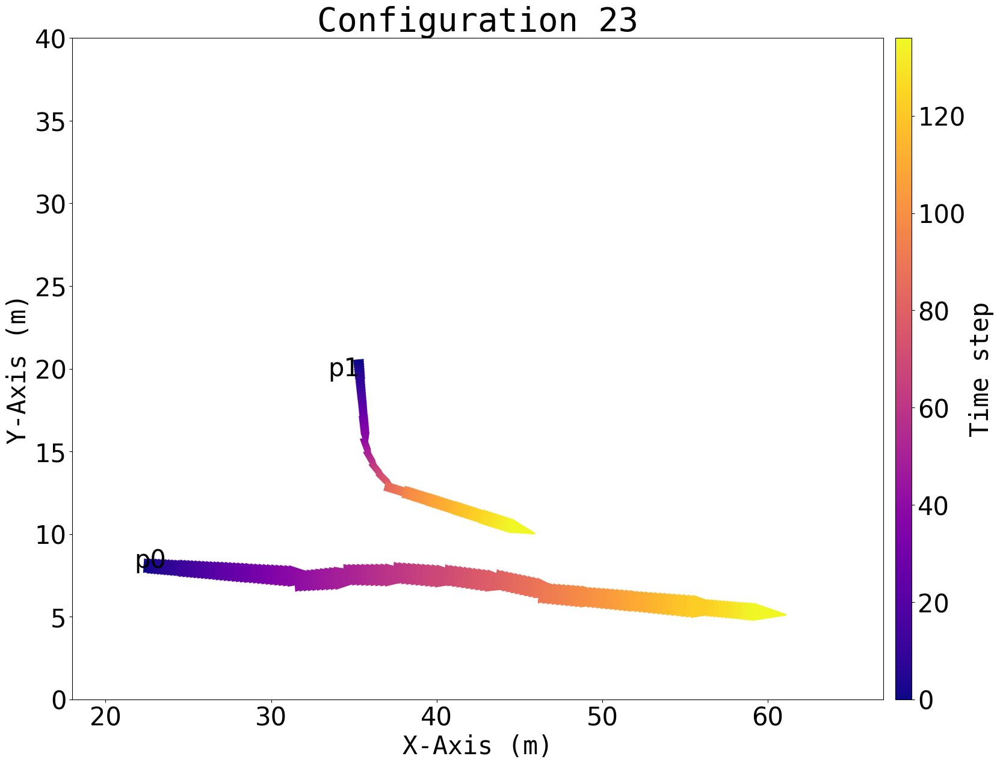

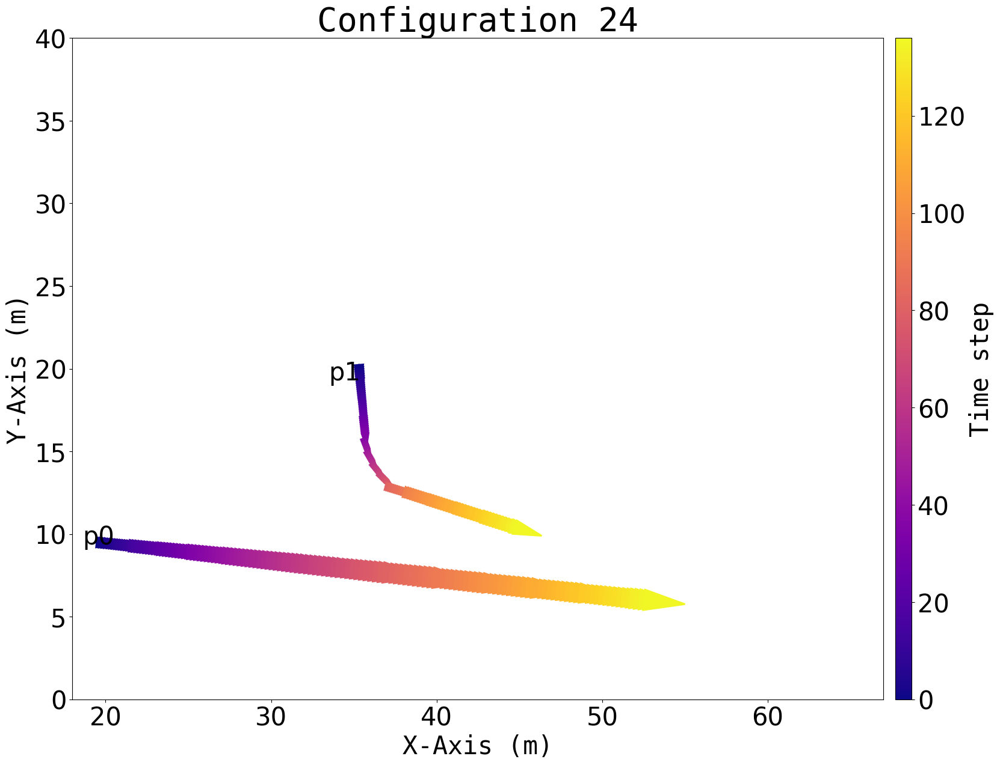

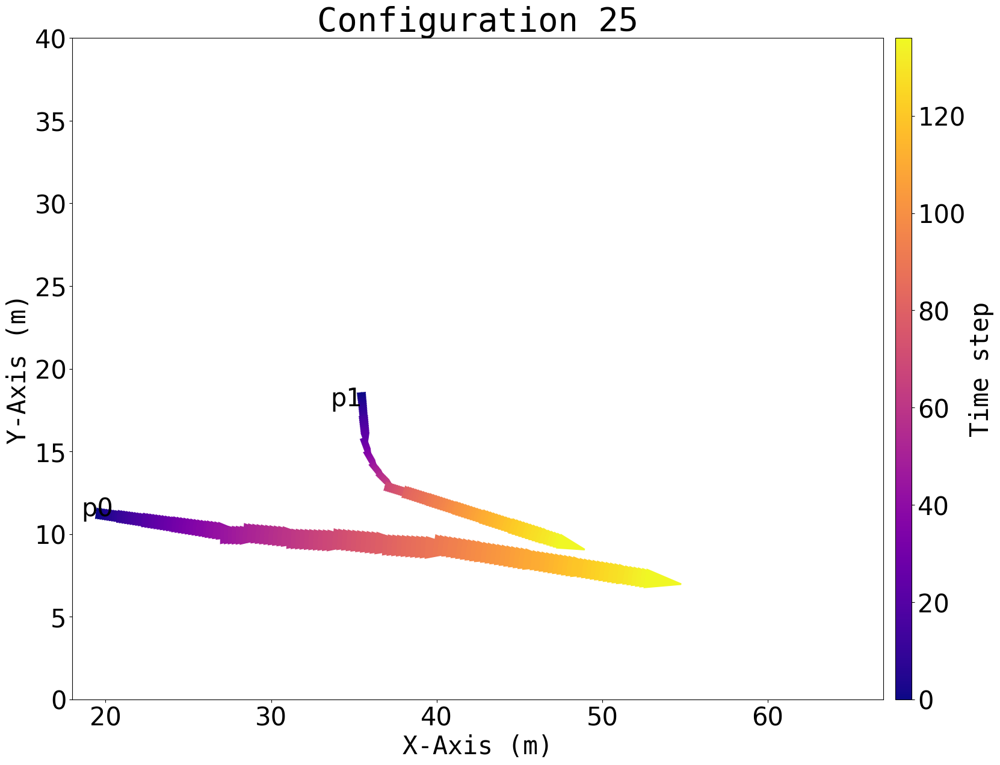

Time elapsed for running module "N_VA_StaticAbsolute": 8.100 sec.


In [88]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# Start time
t_start = time.time()

# Set the default unit of length to centimeters
mpl.rcParams['figure.dpi'] = 2.54

# Load the dataset
df = pd.read_csv(av.dataset_name, header=None)

# Get the unique values of the first column
configurations = df[0].unique()

# Create a list of colors for scatter when only one timestamp
if av.poi == 3:
    colors = ['black', 'blue', 'magenta']
else:
    colors = [plt.cm.cividis(i/av.poi) for i in range(av.poi)]

# Define colormap for time sequence (plasma)
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1  # number of arrow intervals per point

# Create the scatterplot, including arrows
for config in configurations:
    config_data = df[df[0] == config]  # Get the data for the current configuration
    
    # Get the x/y-values
    x = config_data[3]
    y = config_data[4]
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)

    # Set the limits of the axes
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    
    # Set the labels of the axes
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')  
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    # Ensure equal aspect ratio
    ax.set_aspect('equal', adjustable='box')

    # Plot data
    if av.tst == 1:
        for point_index, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[point_index % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                dx, dy = x2 - x1, y2 - y1
                step_len = np.hypot(dx, dy)
                # Determine head sizes based on step length
                head_width = step_len * 4
                head_length = step_len * 8
                color_to_use = cmap_time(i / num_intervals)
                ax.arrow(
                    x1, y1, dx, dy,
                    length_includes_head=True,
                    head_width=head_width,
                    head_length=head_length,
                    linewidth=2 + step_len * 0.05,
                    color=color_to_use
                )
                if i == 0:
                    ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')

    # Add colorbar for time sequence with same height as y-axis and aligned
    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

    # Title, save, and render
    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    # Save the figure
    # fig.savefig(f"N_C_Csa{config}.png", dpi=300, bbox_inches='tight')
    # Display the figure
    plt.show()
    plt.close(fig)

# End and print time
print(f'Time elapsed for running module "N_VA_StaticAbsolute": {time.time() - t_start:.3f} sec.')


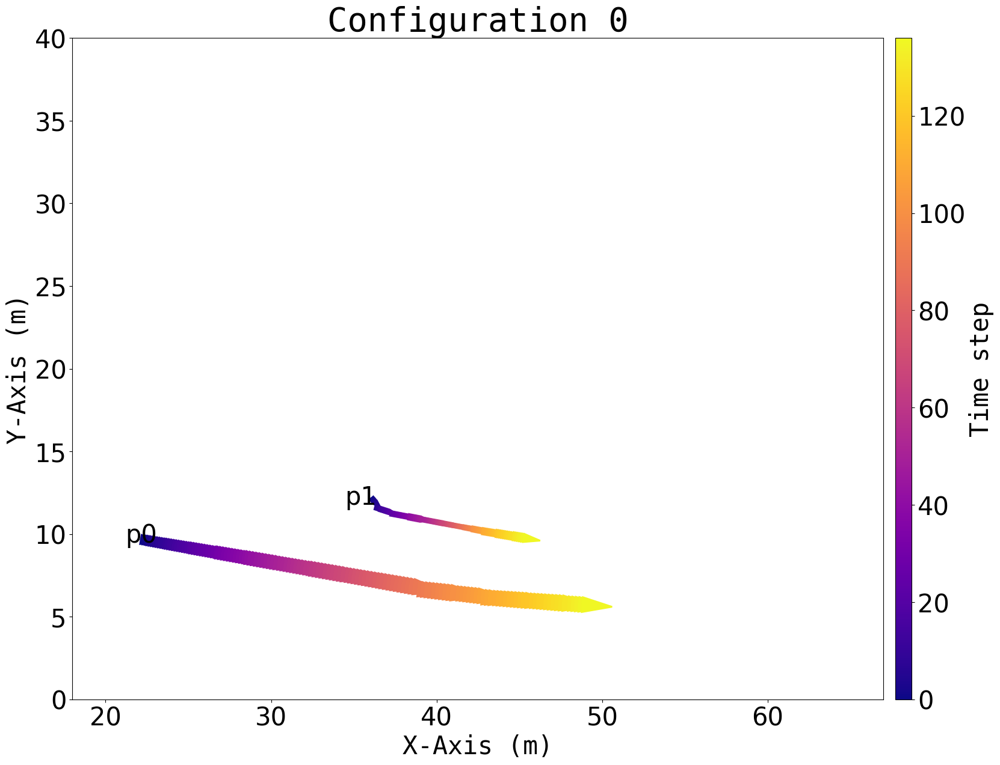

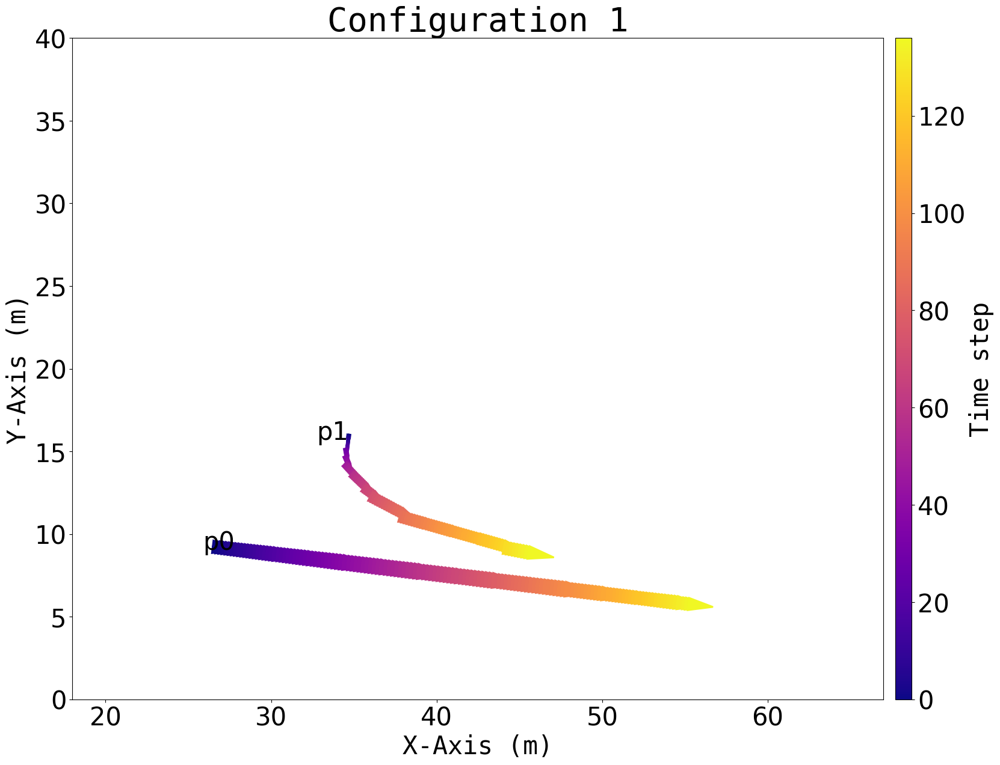

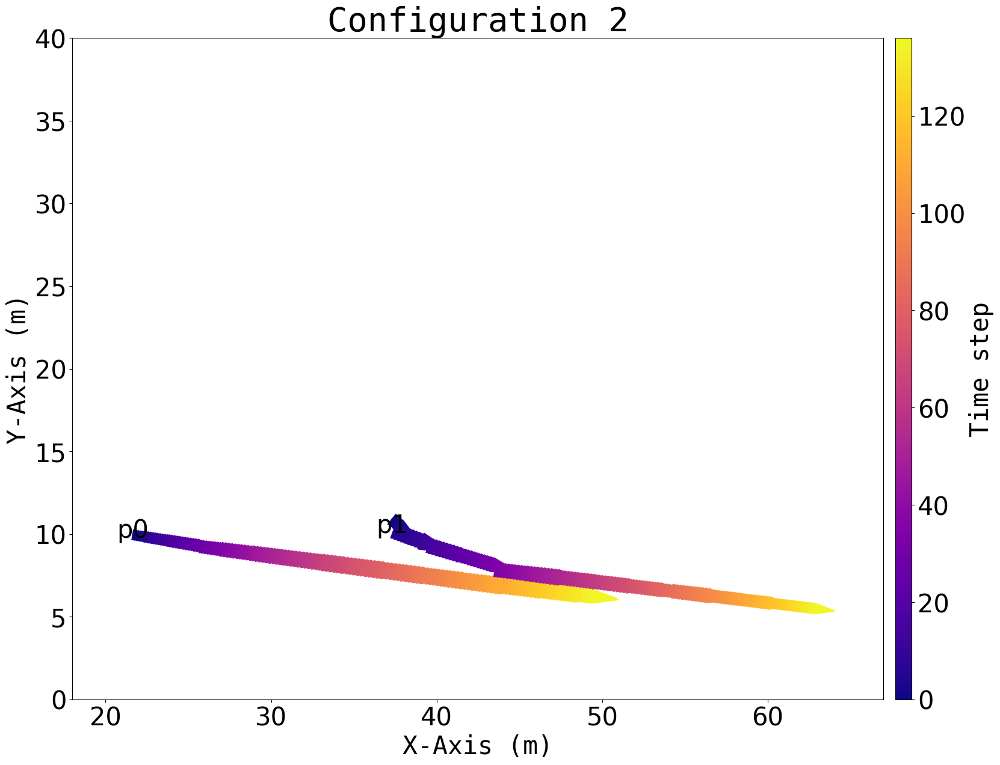

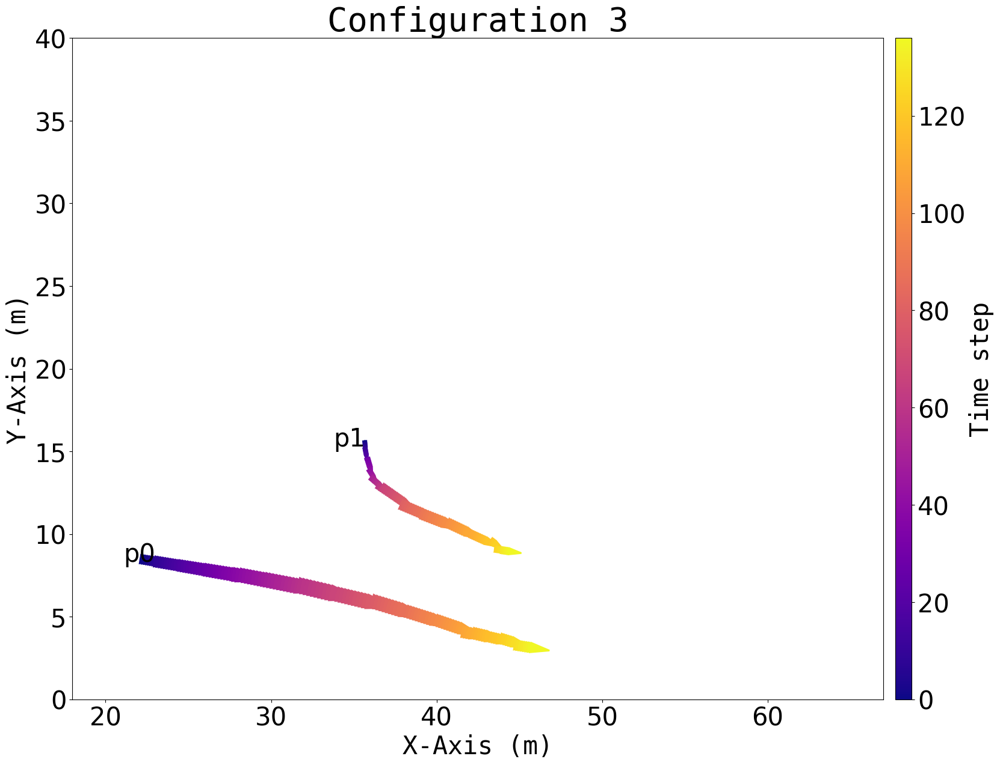

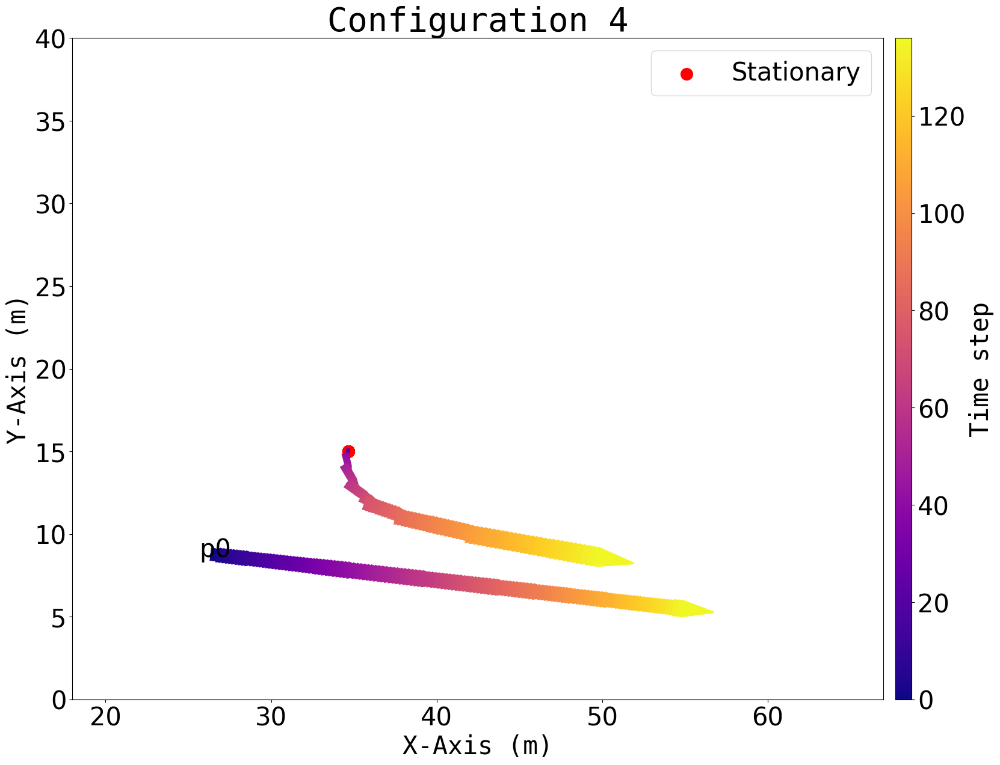

...

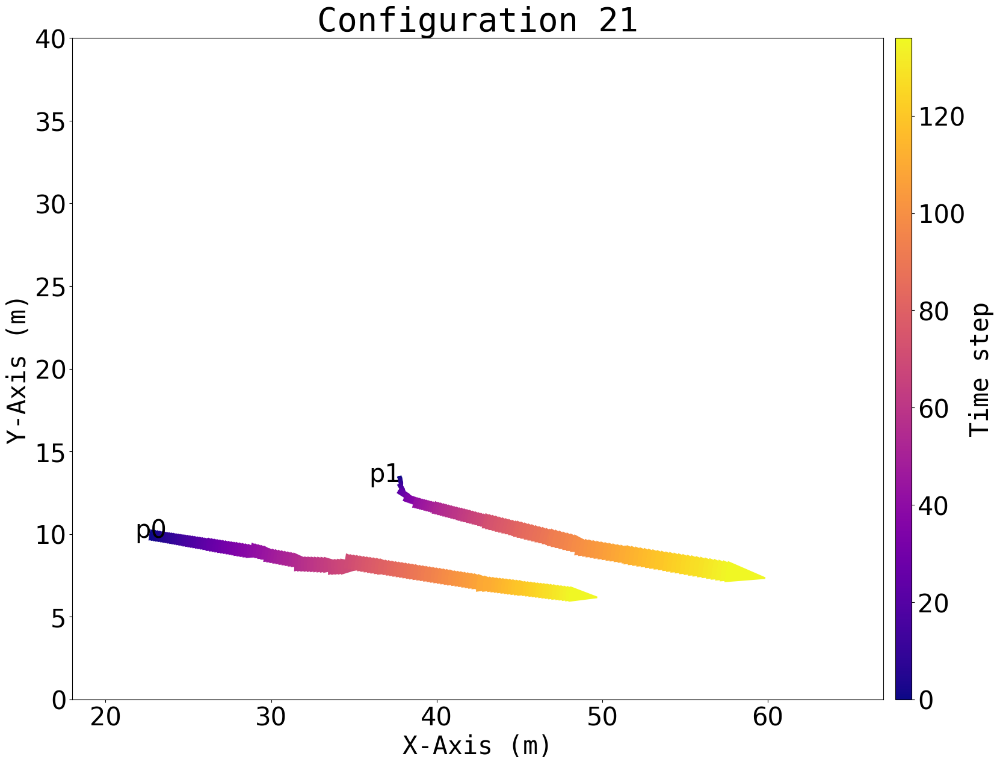

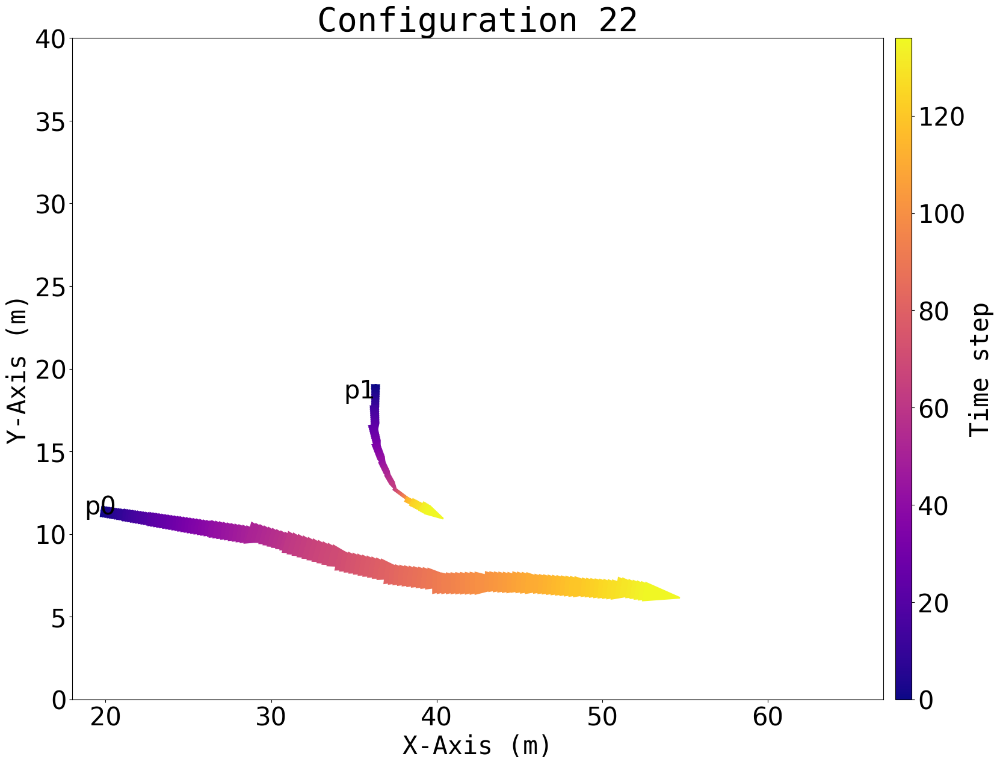

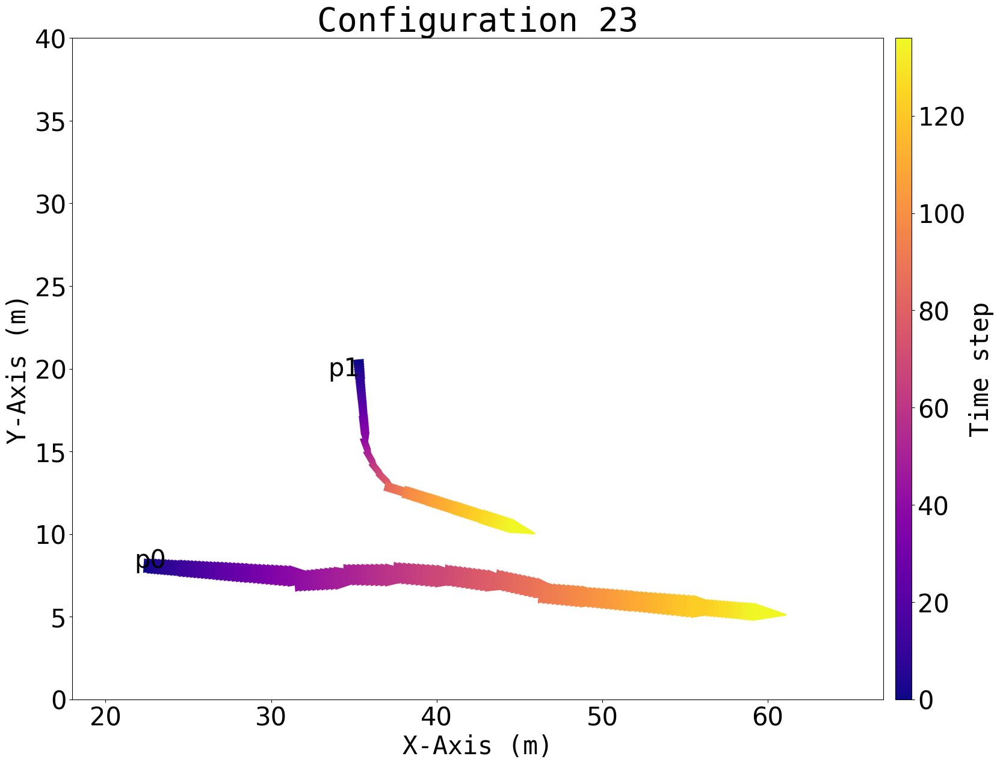

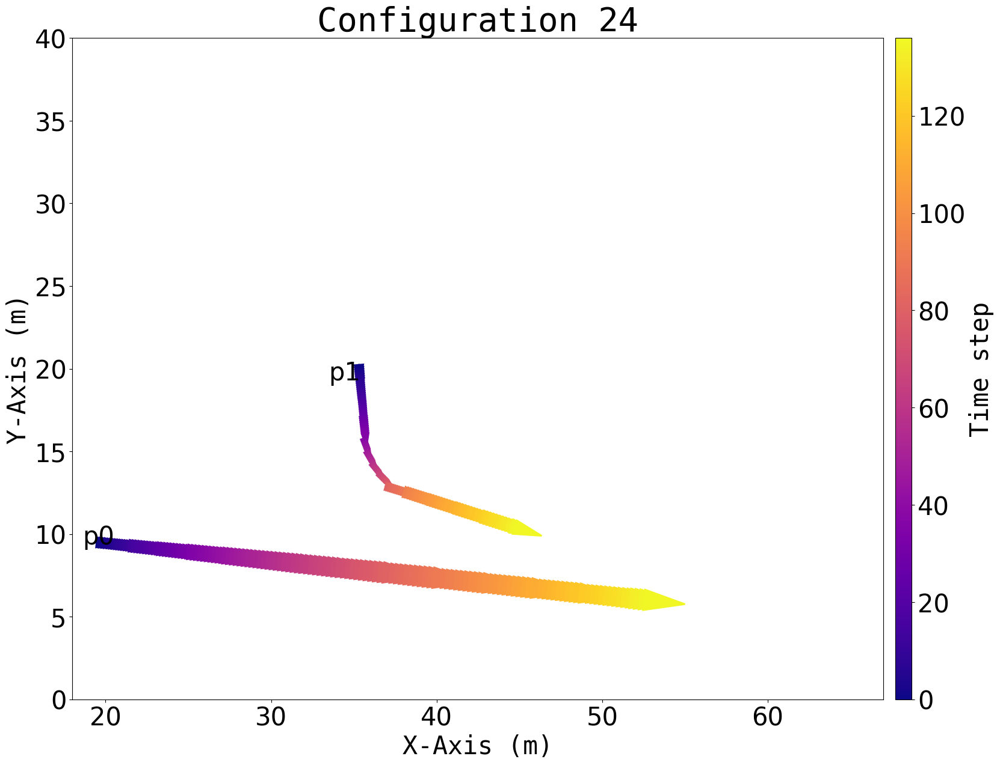

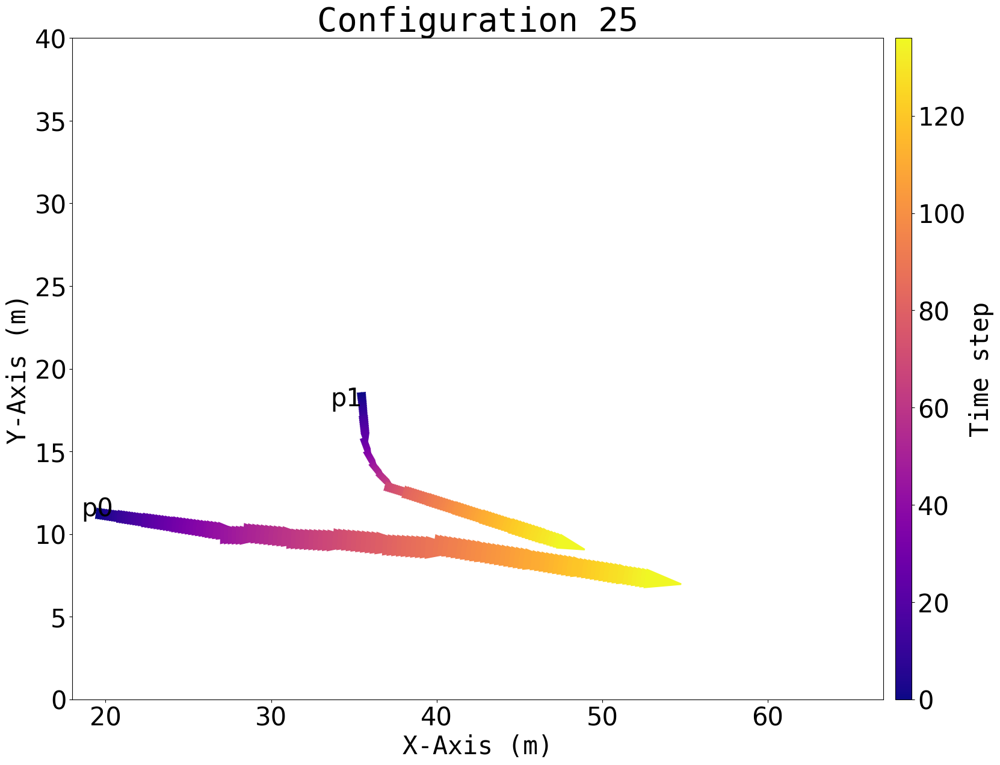

Time elapsed for running module "N_VA_StaticAbsolute": 8.939 sec.


In [89]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# Start time
t_start = time.time()

# Set the default unit of length to centimeters
mpl.rcParams['figure.dpi'] = 2.54

# Load the dataset
df = pd.read_csv(av.dataset_name, header=None)

# Get the unique values of the first column
configurations = df[0].unique()

# Create a list of colors for scatter when only one timestamp
if av.poi == 3:
    colors = ['black', 'blue', 'magenta']
else:
    colors = [plt.cm.cividis(i/av.poi) for i in range(av.poi)]

# Define colormap for time sequence (plasma)
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1  # number of arrow intervals per point

# Create the scatterplot, including arrows and stationary markers
for config in configurations:
    config_data = df[df[0] == config]  # Get the data for the current configuration
    
    # Get the x/y-values
    x = config_data[3]
    y = config_data[4]
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)

    # Set the limits of the axes
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    
    # Set the labels of the axes
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')  
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    # Ensure equal aspect ratio
    ax.set_aspect('equal', adjustable='box')

    # Flag for legend entry of stationary points
    stationary_plotted = False

    # Plot data
    if av.tst == 1:
        for point_index, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[point_index % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                dx, dy = x2 - x1, y2 - y1
                step_len = np.hypot(dx, dy)
                if step_len == 0:
                    # Plot stationary point
                    label = 'Stationary' if not stationary_plotted else None
                    ax.scatter(x1, y1, color='red', s=200, label=label)
                    stationary_plotted = True
                else:
                    # Determine head sizes based on step length
                    head_width = step_len * 4
                    head_length = step_len * 8
                    color_to_use = cmap_time(i / num_intervals)
                    ax.arrow(
                        x1, y1, dx, dy,
                        length_includes_head=True,
                        head_width=head_width,
                        head_length=head_length,
                        linewidth=2 + step_len * 0.05,
                        color=color_to_use
                    )
                    if i == 0:
                        ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')

    # Add colorbar for time sequence with same height as y-axis and aligned
    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

    # Legend for stationary points
    if stationary_plotted:
        ax.legend(fontsize=30, loc='upper right')

    # Title, save, and render
    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    # Save the figure
    # fig.savefig(f"N_C_Csa{config}.png", dpi=300, bbox_inches='tight')
    # Display the figure
    plt.show()
    plt.close(fig)

# End and print time
print(f"Time elapsed for running module \"N_VA_StaticAbsolute\": {time.time() - t_start:.3f} sec.")


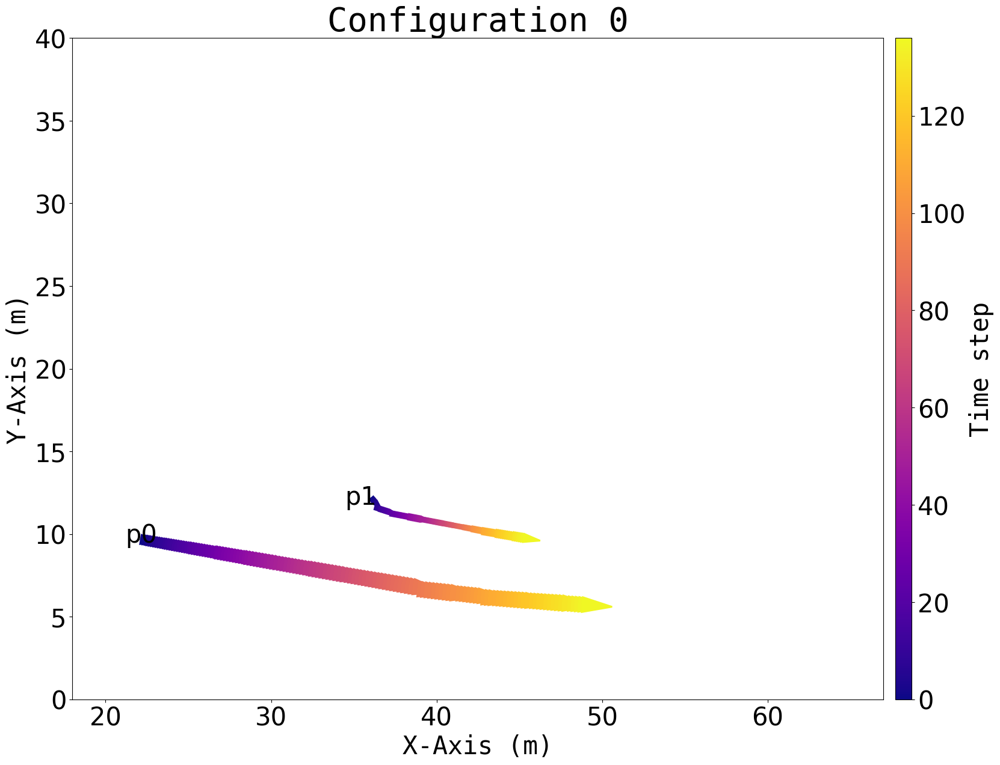

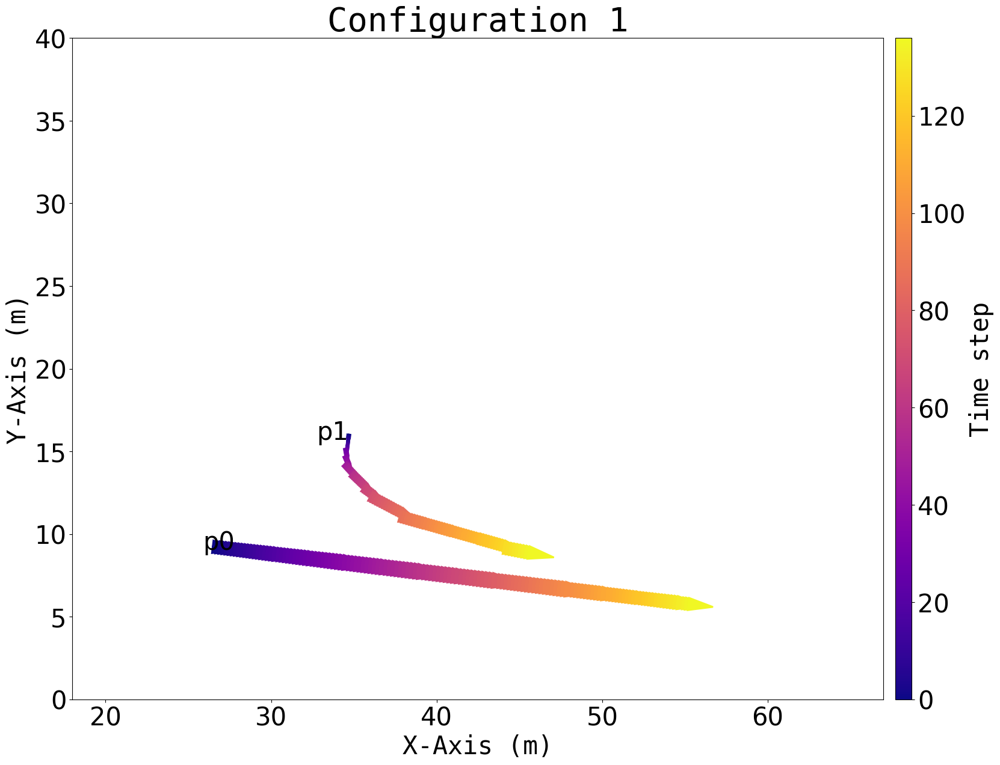

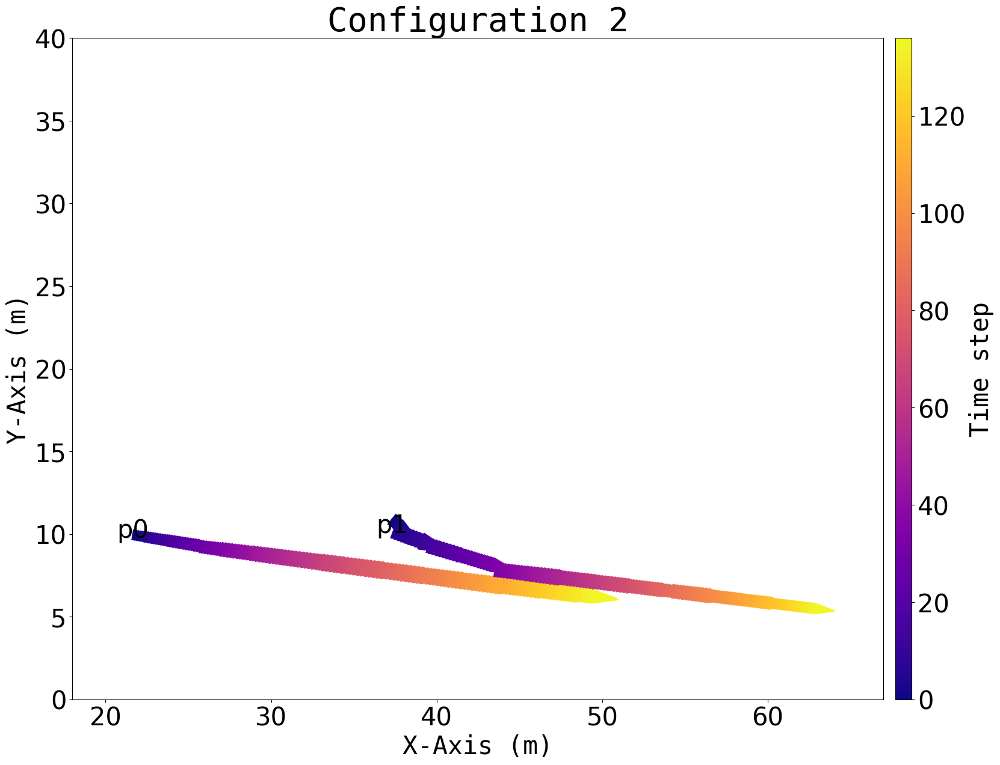

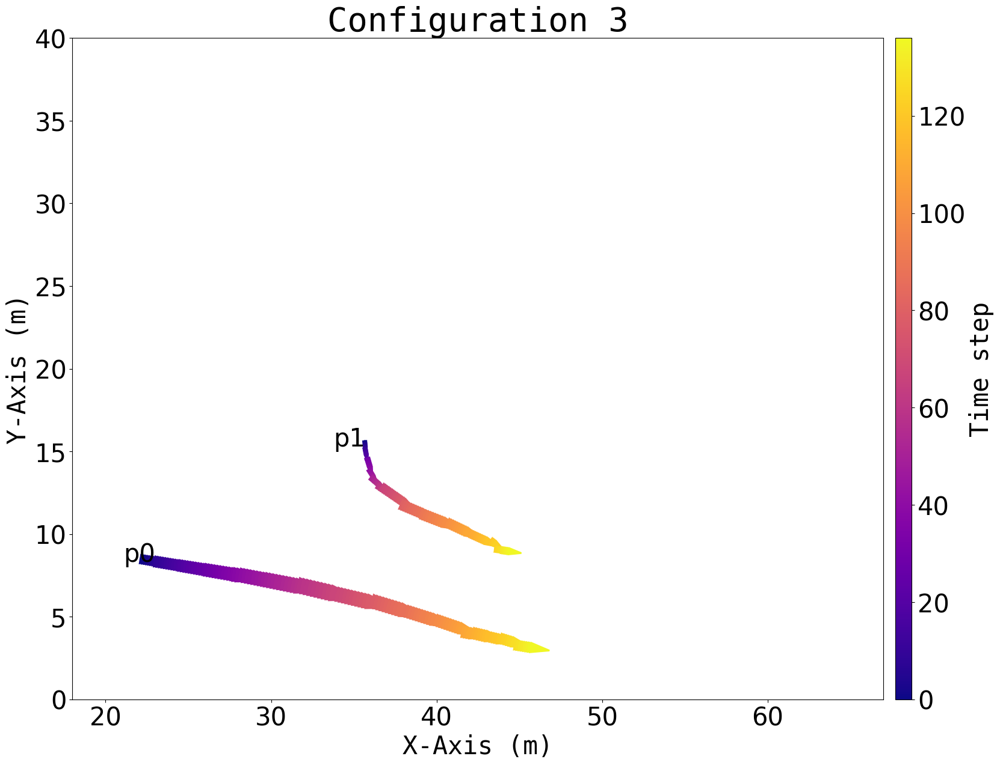

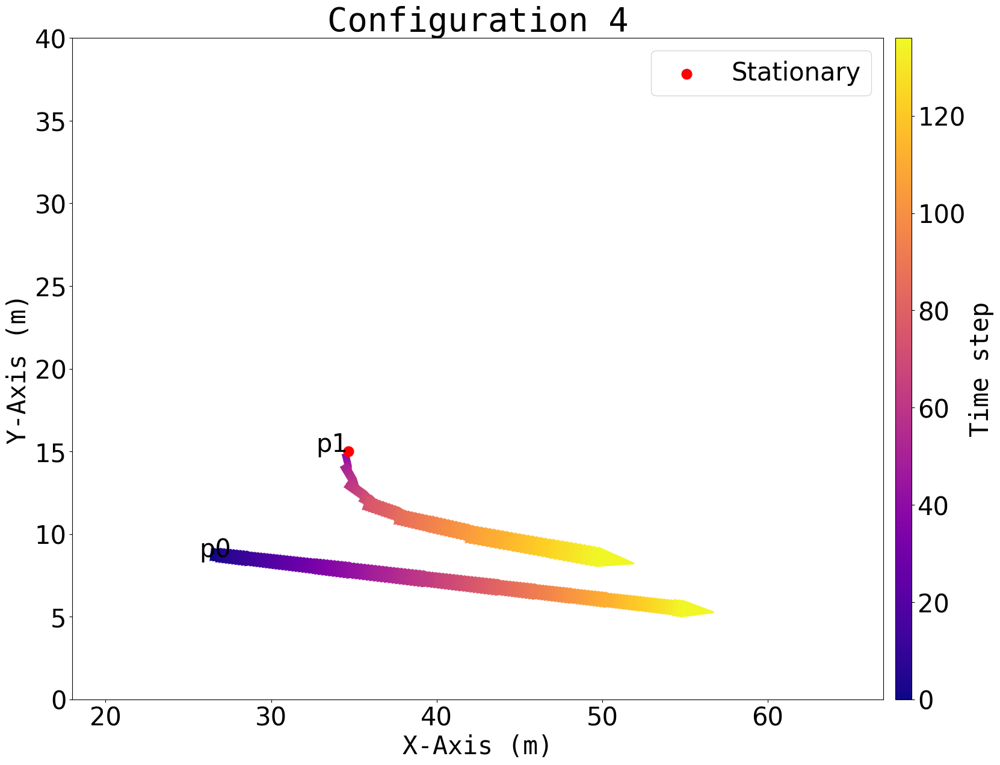

...

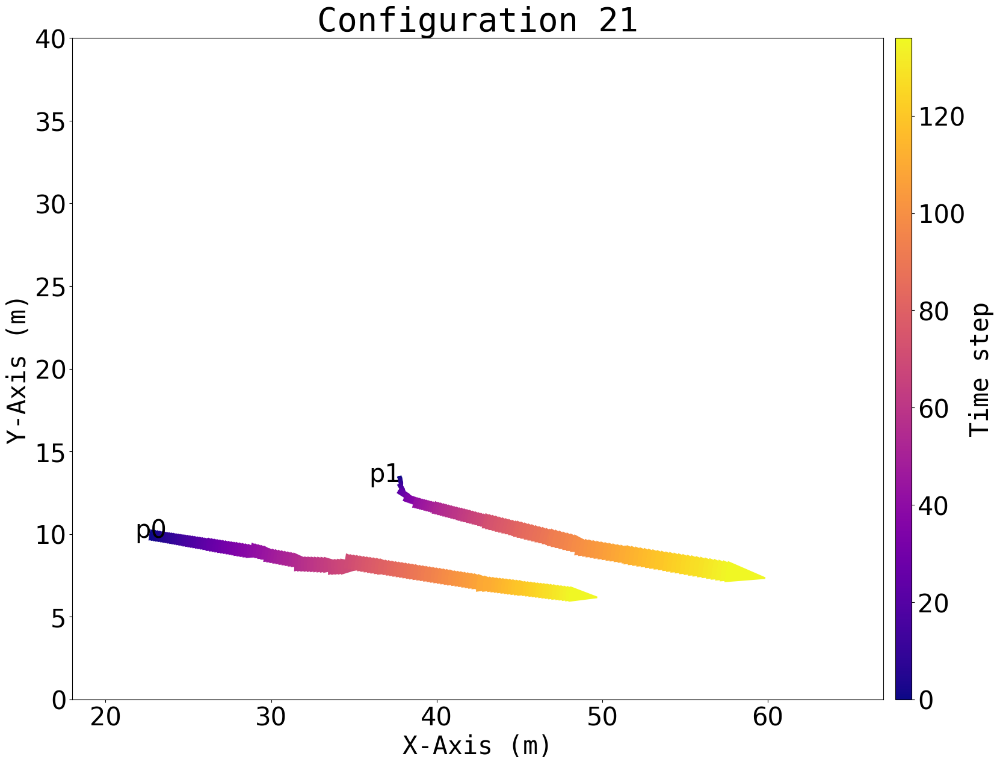

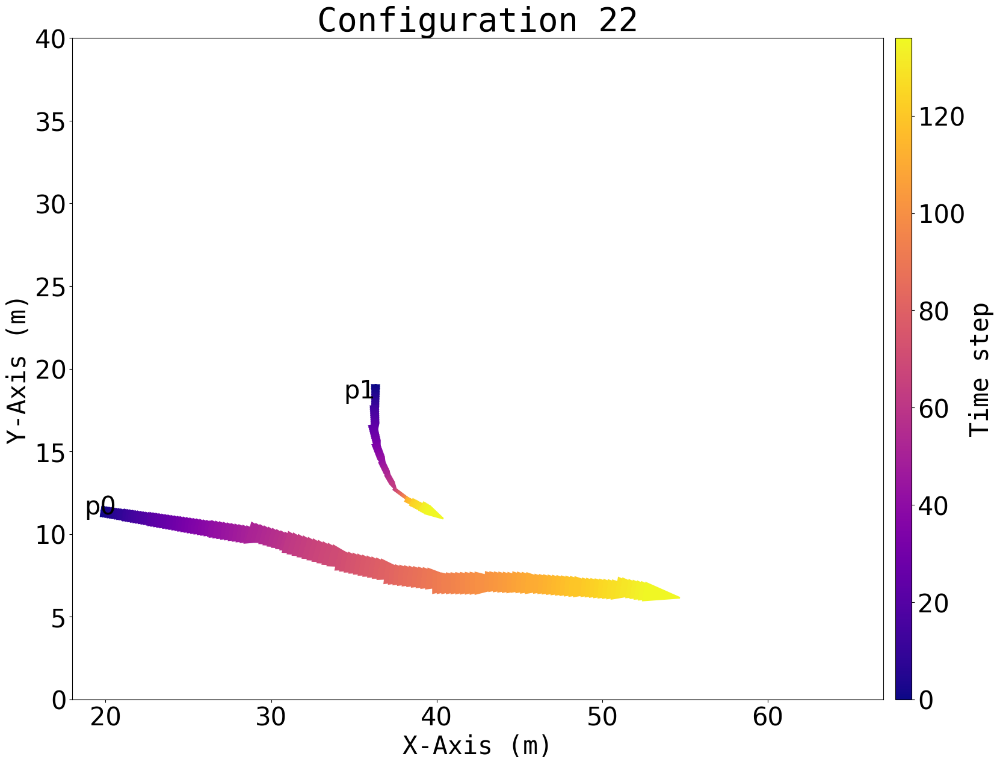

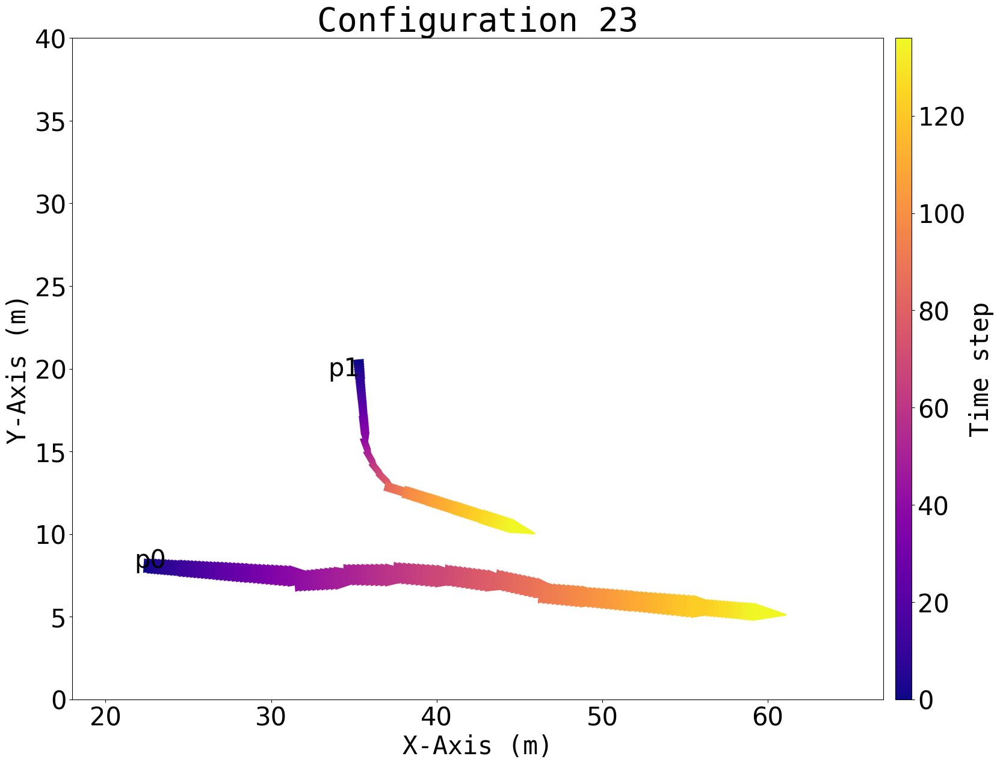

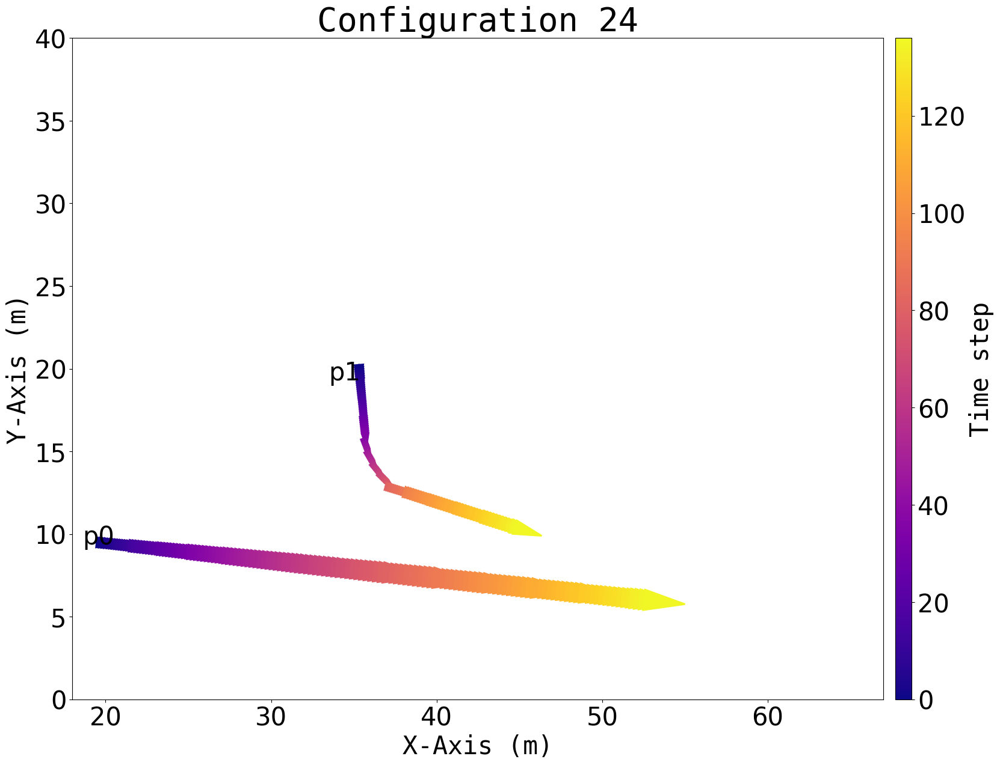

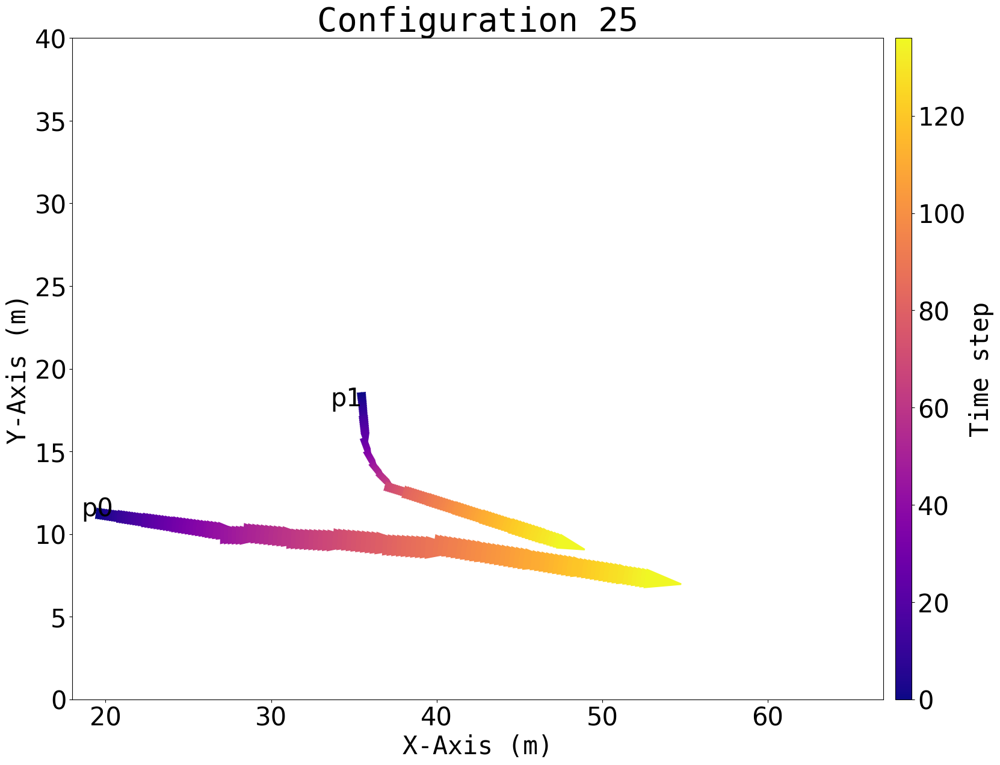

Time elapsed for running module "N_VA_StaticAbsolute": 8.569 sec.


In [3]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# Start time
t_start = time.time()

# Set the default unit of length to centimeters
mpl.rcParams['figure.dpi'] = 2.54

# Load the dataset
df = pd.read_csv(av.dataset_name, header=None)

# Get the unique values of the first column
configurations = df[0].unique()

# Create a list of colors for scatter when only one timestamp
if av.poi == 3:
    colors = ['black', 'blue', 'magenta']
else:
    colors = [plt.cm.cividis(i/av.poi) for i in range(av.poi)]

# Define colormap for time sequence (plasma)
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1  # number of arrow intervals per point

# Parameters for stationary marker sizing
min_marker_size = 100  # minimum red dot size
max_marker_size = 500  # maximum red dot size

# Create the scatterplot, including arrows and stationary markers
for config in configurations:
    config_data = df[df[0] == config]  # Get the data for the current configuration
    
    # Get the x/y-values
    x = config_data[3]
    y = config_data[4]
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)

    # Set the limits of the axes
    ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)
    
    # Set the labels of the axes
    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')  
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    # Ensure equal aspect ratio
    ax.set_aspect('equal', adjustable='box')

    # Track stationary durations and coords per point
    static_counts = {}
    static_coords = {}

    # Plot data
    if av.tst == 1:
        for point_index, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[point_index % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                dx, dy = x2 - x1, y2 - y1
                step_len = np.hypot(dx, dy)
                if step_len == 0:
                    static_counts[p] = static_counts.get(p, 0) + 1
                    static_coords[p] = (x1, y1)
                else:
                    # Determine head sizes based on step length
                    head_width = step_len * 4
                    head_length = step_len * 8
                    color_to_use = cmap_time(i / num_intervals)
                    ax.arrow(
                        x1, y1, dx, dy,
                        length_includes_head=True,
                        head_width=head_width,
                        head_length=head_length,
                        linewidth=2 + step_len * 0.05,
                        color=color_to_use
                    )
                if i == 0:
                    ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')

    # Plot stationary markers scaled by duration relative to total span
    stationary_plotted = False
    total_intervals = num_intervals
    for p, count in static_counts.items():
        x1, y1 = static_coords[p]
        # Compute marker size scaled by count / total_intervals
        size = min_marker_size + (count / total_intervals) * (max_marker_size - min_marker_size)
        label = 'Stationary' if not stationary_plotted else None
        ax.scatter(x1, y1, color='red', s=size, label=label)
        stationary_plotted = True

    # Add colorbar for time sequence with same height as y-axis and aligned
    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

    # Legend for stationary points
    if stationary_plotted:
        ax.legend(fontsize=30, loc='upper right')

    # Title, save, and render
    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    # Save the figure
    # fig.savefig(f"N_C_Csa{config}.png", dpi=300, bbox_inches='tight')
    # Display the figure
    plt.show()
    plt.close(fig)

# End and print time
print(f"Time elapsed for running module \"N_VA_StaticAbsolute\": {time.time() - t_start:.3f} sec.")


# time line

In [1]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

In [2]:
import av

# 定义直线两点
# line_start = np.array([37.63, 13.84])
# line_end = np.array([37.032, 9.81])

# line_start = np.array([40.04, 13.61])
# line_end = np.array([38.42, 5.65])

# line_start = np.array([38.88, 13.61])
# line_end = np.array([37.68, 5.37])

line_start = np.array([38.88, 13.61])
line_end = np.array([37.03, 5.51])

# line_start = np.array([38.23, 13.84])
# line_end = np.array([37.31, 5.42])

# 计算点到无限直线的距离
def point_line_distance_inf_line(point, line_start, line_end):
    point = np.array(point)
    line_vec = line_end - line_start
    point_vec = point - line_start
    line_unit_vec = line_vec / np.linalg.norm(line_vec)
    projection_length = np.dot(point_vec, line_unit_vec)
    projection = line_start + projection_length * line_unit_vec
    return np.linalg.norm(point - projection)

# 主函数：找出每个 configuration 中两个 poi 离直线最近的点及其 TST
def compute_closest_to_line(df_raw):
    df = df_raw.copy()
    df.columns = ['configuration', 'TST', 'poi', 'x', 'y']

    def find_closest_points_to_line(group):
        poi_groups = group.groupby('poi')
        if len(poi_groups) < 2:
            return None

        result = {'configuration': group['configuration'].iloc[0]}

        for poi_id in [0, 1]:
            poi_df = poi_groups.get_group(poi_id).reset_index(drop=True)

            min_dist = float('inf')
            closest_row = None

            for _, row in poi_df.iterrows():
                dist = point_line_distance_inf_line([row['x'], row['y']], line_start, line_end)
                if dist < min_dist:
                    min_dist = dist
                    closest_row = row

            result[f'poi{poi_id}_TST'] = closest_row['TST']
            result[f'poi{poi_id}_dist_to_line'] = min_dist

        return result

    result_df = df.groupby('configuration').apply(find_closest_points_to_line).dropna().tolist()
    return pd.DataFrame(result_df)

# 加载数据
df = pd.read_csv(av.dataset_name, header=None)
df_raw = df

# 计算结果
closest_to_line_df = compute_closest_to_line(df_raw)

C:\Users\25803\AppData\Local\Temp\ipykernel_32340\380768823.py:58: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  result_df = df.groupby('configuration').apply(find_closest_points_to_line).dropna().tolist()


In [9]:
import pandas as pd
import numpy as np
import av

# === 设置直线两点（构成无限延长直线） ===
# line_start = np.array([37.63, 13.84])
# line_end = np.array([37.032, 9.81])
# 873 1291 909 1071
line_start = np.array([40.41, 2.68])
line_end = np.array([40.08, 12.87])

# line_start = np.array([39.27, 13.86])
# line_end = np.array([37.51, 5.49])

# line_start = np.array([39.50, 13.95])
# line_end = np.array([37.51, 5.49])

# === 工具函数：判断点在直线哪一侧 ===
def point_side(point, line_start, line_end):
    px, py = point
    ax, ay = line_start
    bx, by = line_end
    cross = (bx - ax) * (py - ay) - (by - ay) * (px - ax)
    return np.sign(cross)

# === 工具函数：点到直线距离 ===
def point_line_distance_inf_line(point, line_start, line_end):
    point = np.array(point)
    line_vec = line_end - line_start
    point_vec = point - line_start
    line_unit_vec = line_vec / np.linalg.norm(line_vec)
    projection_length = np.dot(point_vec, line_unit_vec)
    projection = line_start + projection_length * line_unit_vec
    return np.linalg.norm(point - projection)

# === 主逻辑：先尝试找穿越点，如果没有就返回最近的点 ===
def find_cross_or_closest_point(poi_df):
    poi_df = poi_df.sort_values('TST').reset_index(drop=True)
    prev_side = None

    for i in range(len(poi_df)):
        point = [poi_df.loc[i, 'x'], poi_df.loc[i, 'y']]
        curr_side = point_side(point, line_start, line_end)

        if curr_side == 0:
            return poi_df.loc[i]  # 刚好在直线上

        if prev_side is not None and curr_side != prev_side:
            return poi_df.loc[i]  # 发生穿越

        prev_side = curr_side

    # ❗如果没有穿越 → 找距离最近的点
    min_dist = float('inf')
    closest_row = None
    for _, row in poi_df.iterrows():
        dist = point_line_distance_inf_line([row['x'], row['y']], line_start, line_end)
        if dist < min_dist:
            min_dist = dist
            closest_row = row

    return closest_row

# === 主函数：按 configuration 遍历 ===
def compute_first_cross_or_closest(df_raw):
    df = df_raw.copy()
    df.columns = ['configuration', 'TST', 'poi', 'x', 'y']

    def process_group(group):
        poi_groups = group.groupby('poi')
        if len(poi_groups) < 2:
            return None

        result = {'configuration': group['configuration'].iloc[0]}

        for poi_id in [0, 1]:
            poi_df = poi_groups.get_group(poi_id)
            chosen_row = find_cross_or_closest_point(poi_df)

            result[f'poi{poi_id}_TST'] = chosen_row['TST']
            result[f'poi{poi_id}_x'] = chosen_row['x']
            result[f'poi{poi_id}_y'] = chosen_row['y']

        return result

    result_df = df.groupby('configuration').apply(process_group).dropna().tolist()
    return pd.DataFrame(result_df)

# === 加载数据 ===
df = pd.read_csv(av.dataset_name, header=None)
df_raw = df

# === 运行处理 ===
closest_to_line_df = compute_first_cross_or_closest(df_raw)


C:\Users\25803\AppData\Local\Temp\ipykernel_14348\201059785.py:86: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  result_df = df.groupby('configuration').apply(process_group).dropna().tolist()


In [10]:
closest_to_line_df

,configuration,poi0_TST,poi0_x,poi0_y,poi1_TST,poi1_x,poi1_y
0,0,91.0,40.450321,6.492725,58.0,40.177053,10.684022
1,1,59.0,40.477653,7.540384,95.0,40.231934,10.367220
2,2,89.0,40.298992,7.341739,11.0,40.279020,9.115469
3,3,94.0,40.383251,4.628017,91.0,40.244852,10.767324
4,4,60.0,40.317325,7.160706,90.0,40.190390,10.469357
5,5,89.0,40.425146,6.349709,100.0,40.209146,10.986363
6,6,34.0,40.358298,8.684638,102.0,40.256915,10.105297
7,7,60.0,40.334814,6.147059,92.0,40.214013,9.884090
8,8,33.0,40.245631,8.053971,96.0,40.169906,11.942893
9,9,66.0,40.448311,6.480868,101.0,40.236939,8.851061


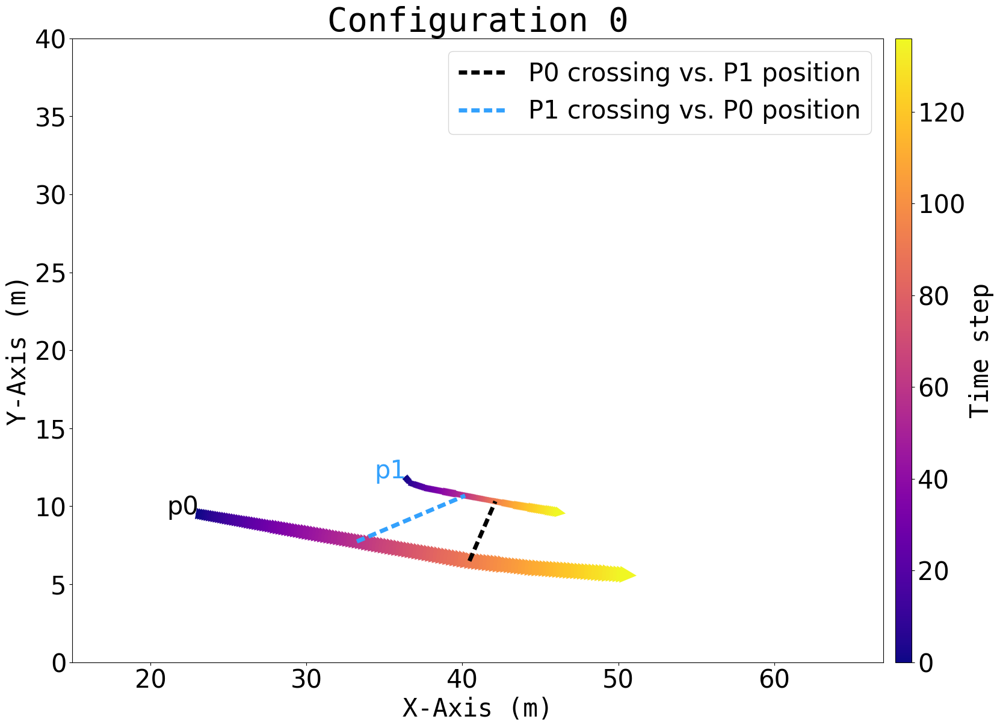

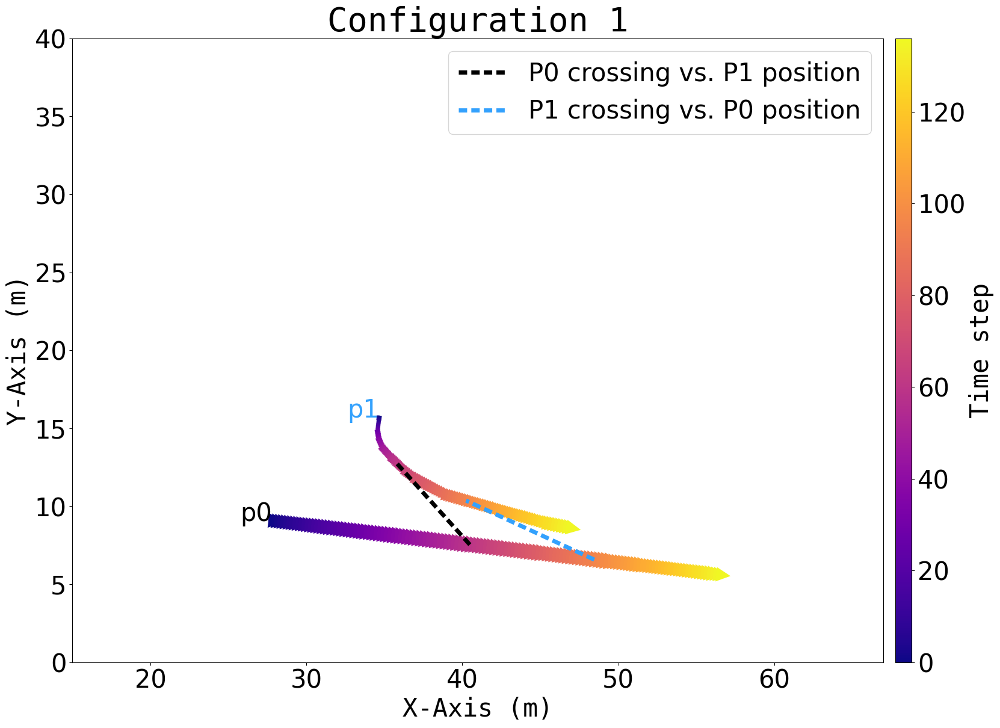

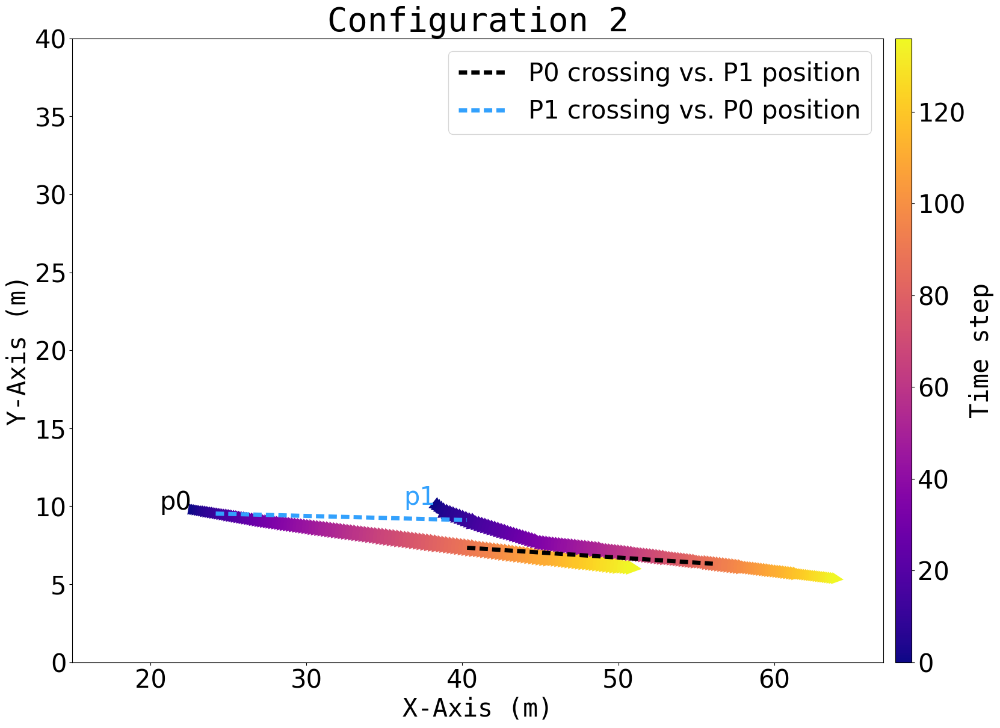

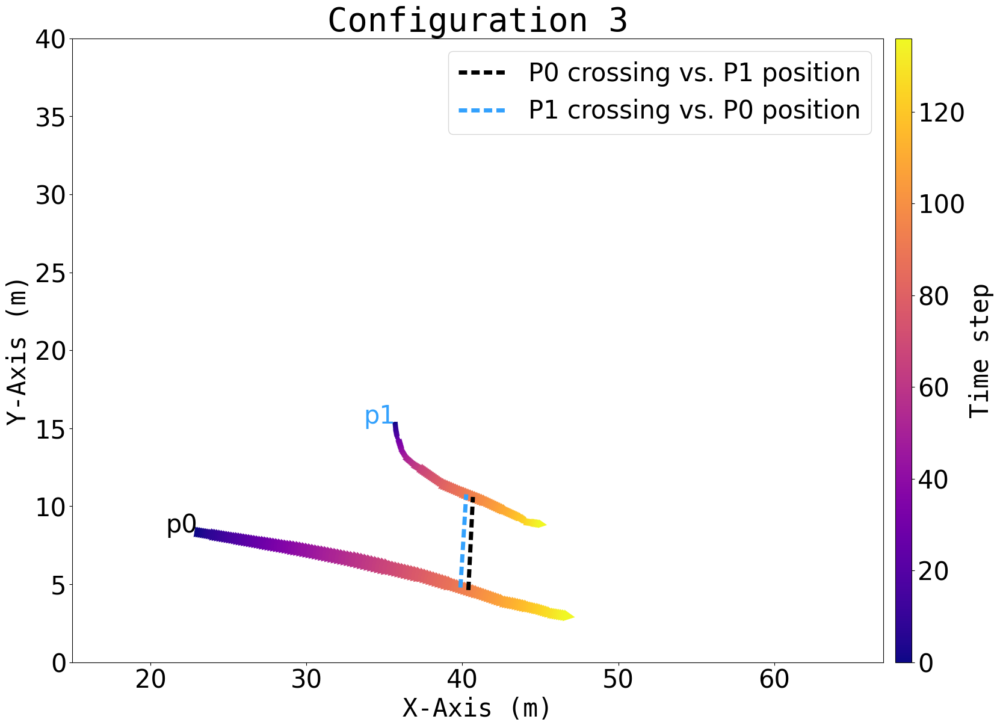

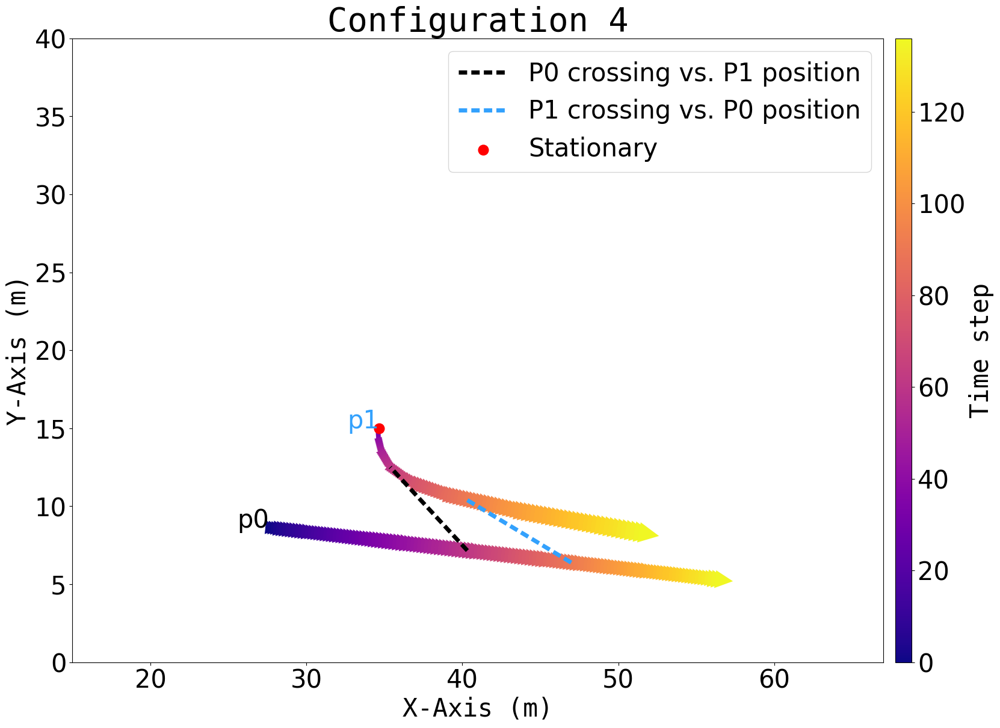

...

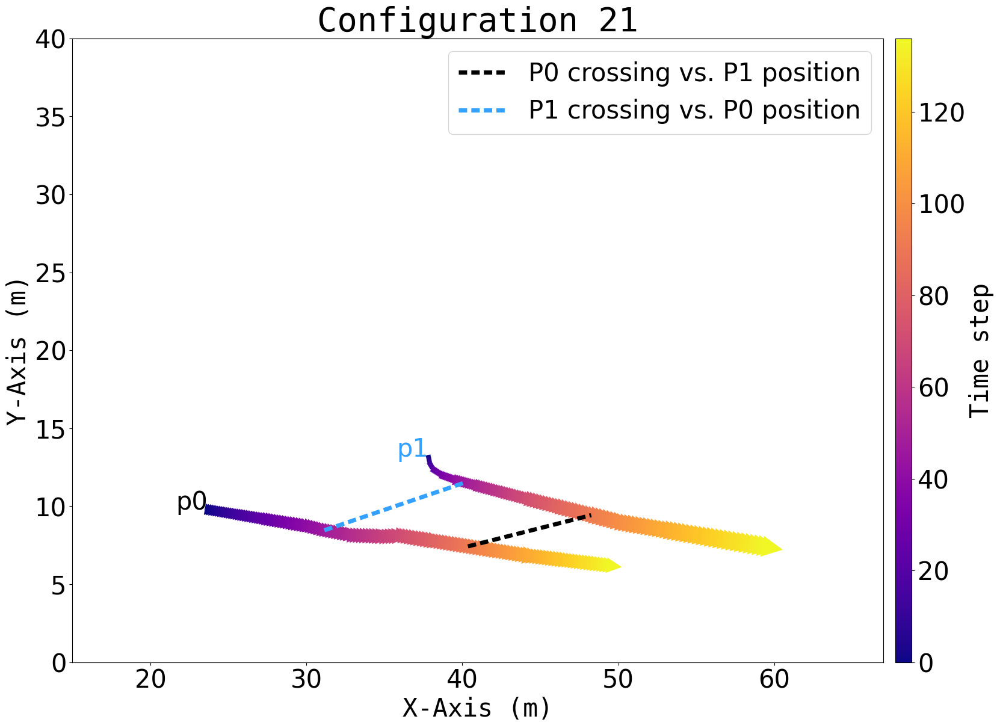

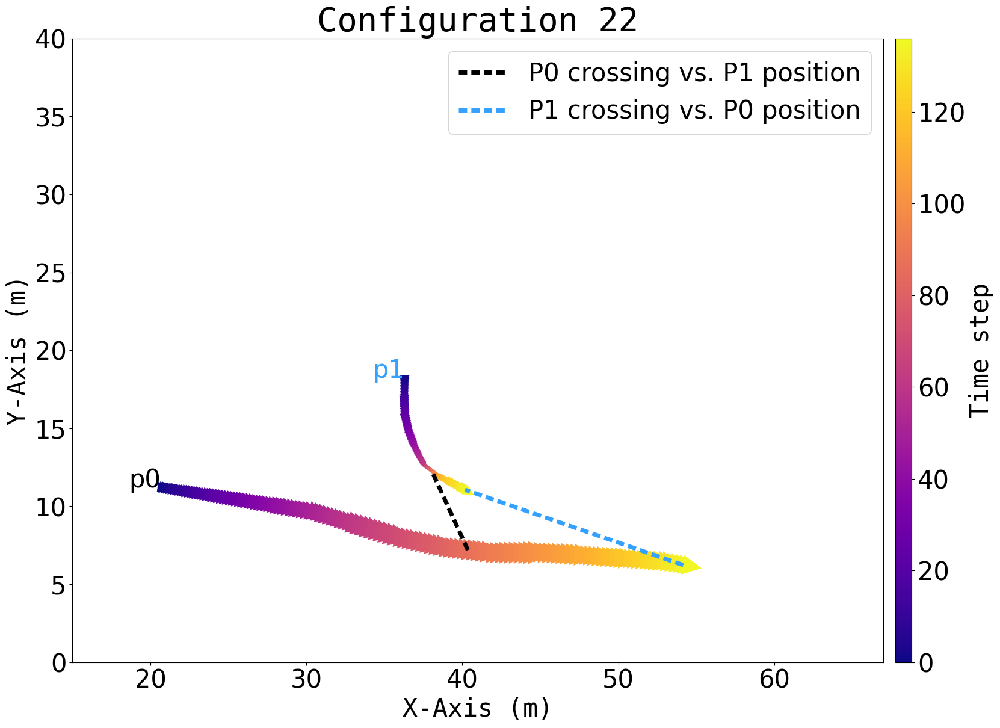

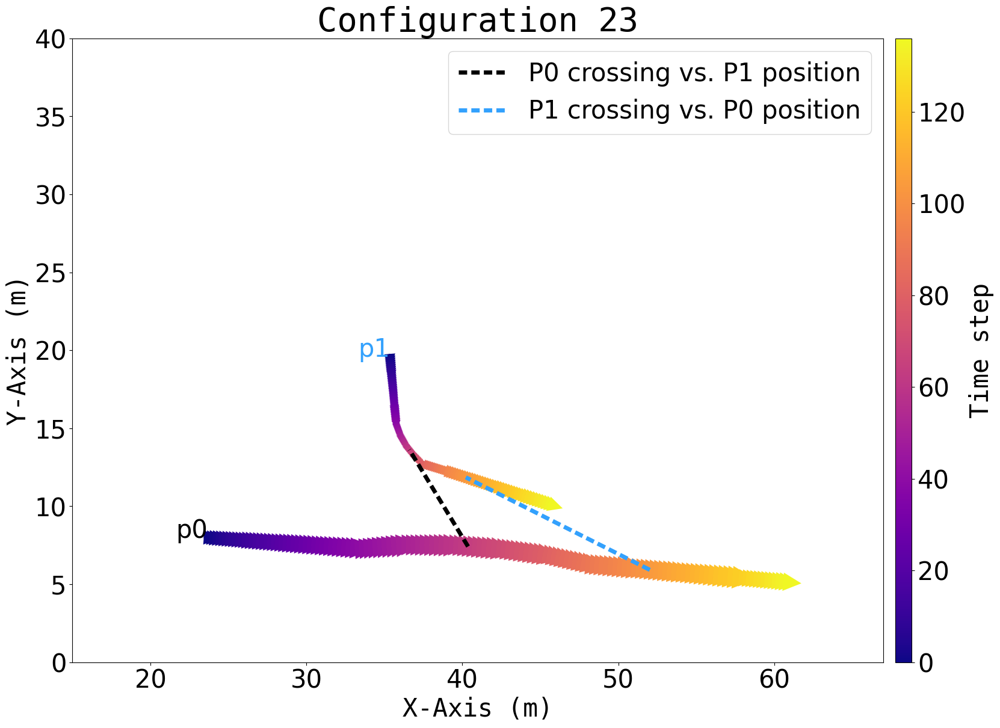

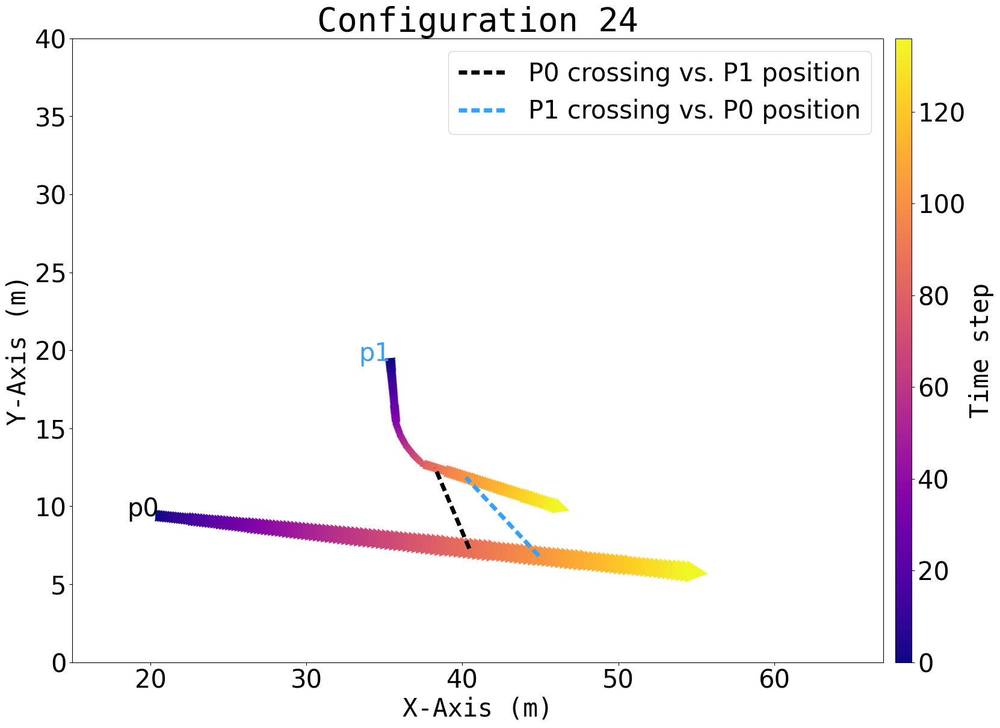

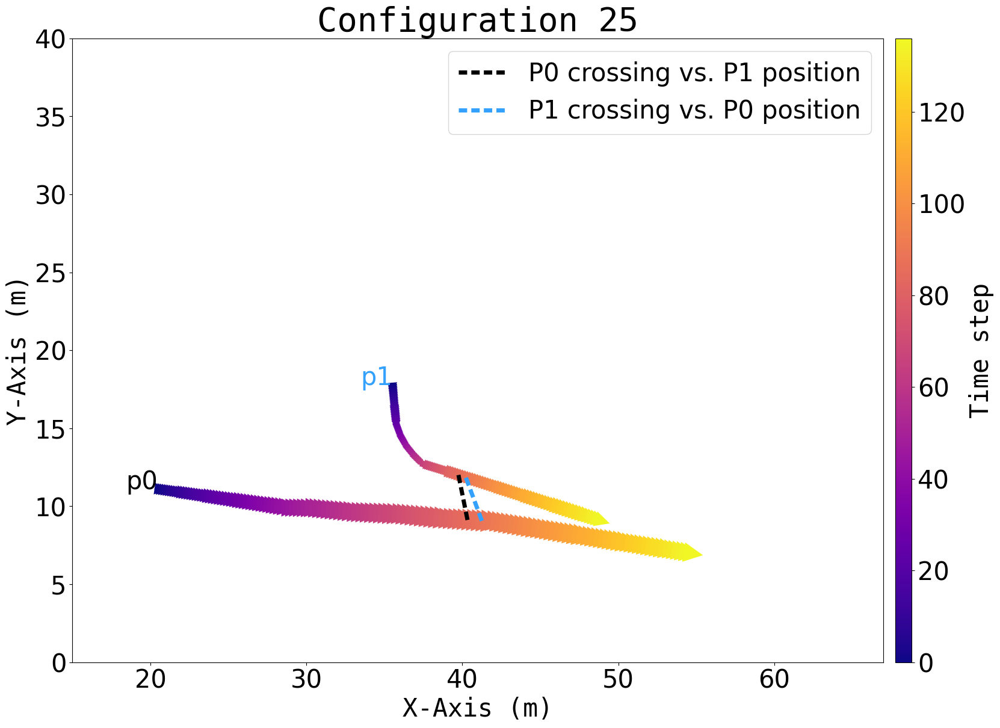

Time elapsed for running module "N_VA_StaticAbsolute": 26.559 sec.


In [6]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# ------------------------------
# NEW: toggles for connections
# ------------------------------
CONNECT_SE = 0           # 1 = draw dashed black connections for start/end; 0 = disable
CONNECT_CLOSEST_TST = 1  # 1 = draw lines connecting points at closest TSTs; 0 = disable

# Style for start-end connection lines
_SE_LINESTYLE = '--'     # dashed line
_SE_COLOR = 'black'
_SE_LINEWIDTH = 1.8
_SE_ALPHA = 0.9

# Style for closest-TST connection lines
_TST_LINESTYLE = (0, (2, 1))    
_TST_LINEWIDTH = 5
_TST_ALPHA = 1
_TST_COLOR_POI0 = 'black'   # lead by poi0
_TST_COLOR_POI1 = '#33A1FD'  # lead by poi1

# Start time
t_start = time.time()

# Set the default unit of length to centimeters
mpl.rcParams['figure.dpi'] = 2.54

# Load the dataset
df = pd.read_csv(av.dataset_name, header=None)

# Get the unique values of the first column
configurations = df[0].unique()

# Create a list of colors for scatter when only one timestamp
if av.poi == 3:
    colors = ['black', 'blue', 'magenta']
else:
    colors = [plt.cm.cividis(i/av.poi) for i in range(av.poi)]

# Define colormap for time sequence (plasma)
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1

# Parameters for stationary marker sizing
min_marker_size = 100
max_marker_size = 500

# ---------- NEW: Load closest TST connection lines ----------
closest_df = closest_to_line_df
raw_df = pd.read_csv(av.dataset_name, header=None)
raw_df.columns = ['configuration', 'TST', 'poi', 'x', 'y']
tst_connection_lines = {}
for _, row in closest_df.iterrows():
    config = int(row['configuration'])
    poi0_tst = int(row['poi0_TST'])
    poi1_tst = int(row['poi1_TST'])
    group = raw_df[raw_df['configuration'] == config]
    points_tst0 = group[group['TST'] == poi0_tst][['poi', 'x', 'y']].sort_values(by='poi')
    points_tst1 = group[group['TST'] == poi1_tst][['poi', 'x', 'y']].sort_values(by='poi')
    if len(points_tst0) >= 2 and len(points_tst1) >= 2:
        line0 = list(zip(points_tst0['x'], points_tst0['y']))
        line1 = list(zip(points_tst1['x'], points_tst1['y']))
        tst_connection_lines[config] = {'TST0': poi0_tst, 'line0': line0,
                                        'TST1': poi1_tst, 'line1': line1}
# ------------------------------------------------------------------

# Create the scatterplot, including arrows and stationary markers
for config in configurations:
    config_data = df[df[0] == config]
    x = config_data[3]
    y = config_data[4]

    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)
    # ax.set_xlim(av.min_boundary_x, av.max_boundary_x)
    ax.set_xlim(15, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)

    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    ax.set_aspect('equal', adjustable='box')

    static_counts = {}
    static_coords = {}
    start_points = {}
    end_points = {}

    if av.tst == 1:
        for p, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[p % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
            start_points[p] = (x_val, y_val)
            end_points[p] = (x_val, y_val)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                dx, dy = x2 - x1, y2 - y1
                step_len = np.hypot(dx, dy)

                if step_len == 0:
                    static_counts[p] = static_counts.get(p, 0) + 1
                    static_coords[p] = (x1, y1)
                else:
                    head_width = step_len * 4
                    head_length = step_len * 4
                    color_to_use = cmap_time(i / num_intervals)
                    ax.arrow(
                        x1, y1, dx, dy,
                        head_starts_at_zero=True,
                        length_includes_head=True,
                        head_width=head_width,
                        head_length=head_length,
                        linewidth=2 + step_len * 0.05,
                        color=color_to_use,
                        # alpha = 0.2
                    )

                if i == 0:
                    if p == 0:
                        ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')
                    elif p == 1:
                        ax.text(x1, y1, f'p{p}', fontsize=30, ha='right', color = _TST_COLOR_POI1)
                        
                    start_points[p] = (x1, y1)
                if i == av.tst - 2:
                    end_points[p] = (x2, y2)

    if CONNECT_SE and av.poi > 1:
        start_x = [start_points[p][0] for p in range(av.poi) if p in start_points]
        start_y = [start_points[p][1] for p in range(av.poi) if p in start_points]
        if len(start_x) >= 2:
            ax.plot(start_x, start_y, linestyle=_SE_LINESTYLE, color=_SE_COLOR,
                    linewidth=_SE_LINEWIDTH, alpha=_SE_ALPHA, zorder=1)

        if av.tst > 1:
            end_x = [end_points[p][0] for p in range(av.poi) if p in end_points]
            end_y = [end_points[p][1] for p in range(av.poi) if p in end_points]
            if len(end_x) >= 2:
                ax.plot(end_x, end_y, linestyle=_SE_LINESTYLE, color=_SE_COLOR,
                        linewidth=_SE_LINEWIDTH, alpha=_SE_ALPHA, zorder=1)

    # ---------- NEW: draw lines connecting points at closest TSTs ----------
    if CONNECT_CLOSEST_TST and config in tst_connection_lines:
        lines = tst_connection_lines[config]
        for line_key in ['line0', 'line1']:
            coords = lines[line_key]
            if len(coords) >= 2:
                x_vals, y_vals = zip(*coords)
                # Choose color based on which TST this is
                color = _TST_COLOR_POI0 if line_key == 'line0' else _TST_COLOR_POI1
                # label = f"TST={lines['TST0']} (poi0)" if line_key == 'line0' else f"TST={lines['TST1']} (poi1)"
                label = f"P0 crossing vs. P1 position" if line_key == 'line0' else f"P1 crossing vs. P0 position"

                ax.plot(
                    x_vals, y_vals,
                    linestyle=_TST_LINESTYLE,
                    color=color,
                    linewidth=_TST_LINEWIDTH,
                    alpha=_TST_ALPHA,
                    label=label
                )
    # ----------------------------------------------------------------------

    stationary_plotted = False
    total_intervals = num_intervals
    for p, count in static_counts.items():
        x1, y1 = static_coords[p]
        size = min_marker_size + (count / total_intervals) * (max_marker_size - min_marker_size)
        label = 'Stationary' if not stationary_plotted else None
        ax.scatter(x1, y1, color='red', s=size, label=label)
        stationary_plotted = True

    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

        # Always show legend if any labeled elements exist
        handles, labels = ax.get_legend_handles_labels()
        if labels:
            ax.legend(fontsize=30, loc='upper right')

    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    # Save the figure
    fig.savefig(f"N_C_Csa{config}.png", dpi=300, bbox_inches='tight')
    
    plt.show()
    plt.close(fig)

print(f"Time elapsed for running module \"N_VA_StaticAbsolute\": {time.time() - t_start:.3f} sec.")


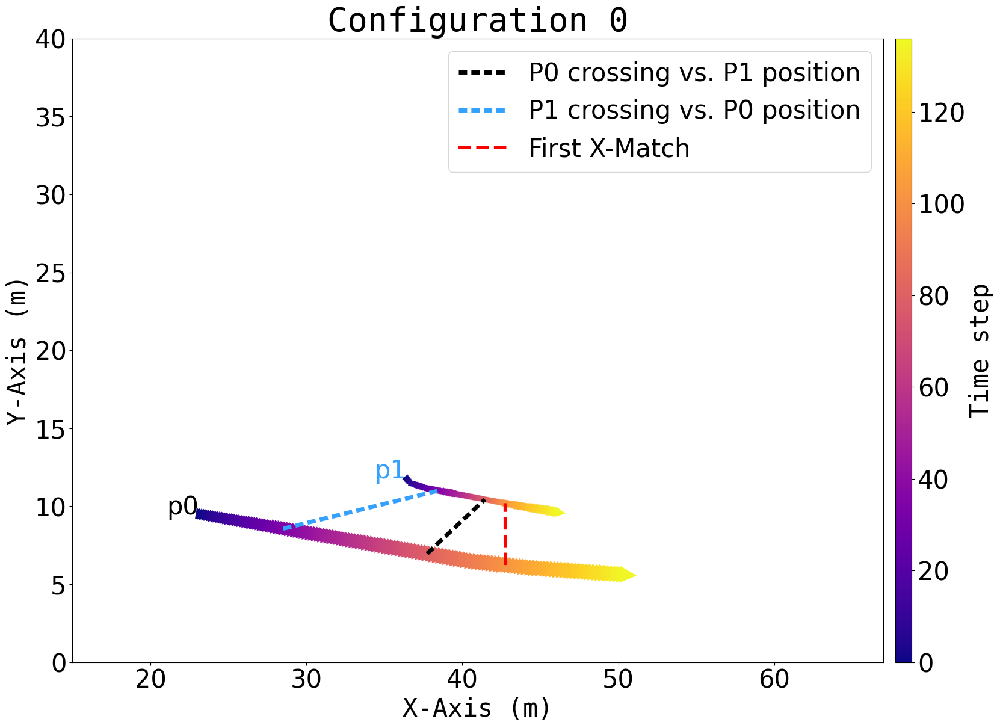

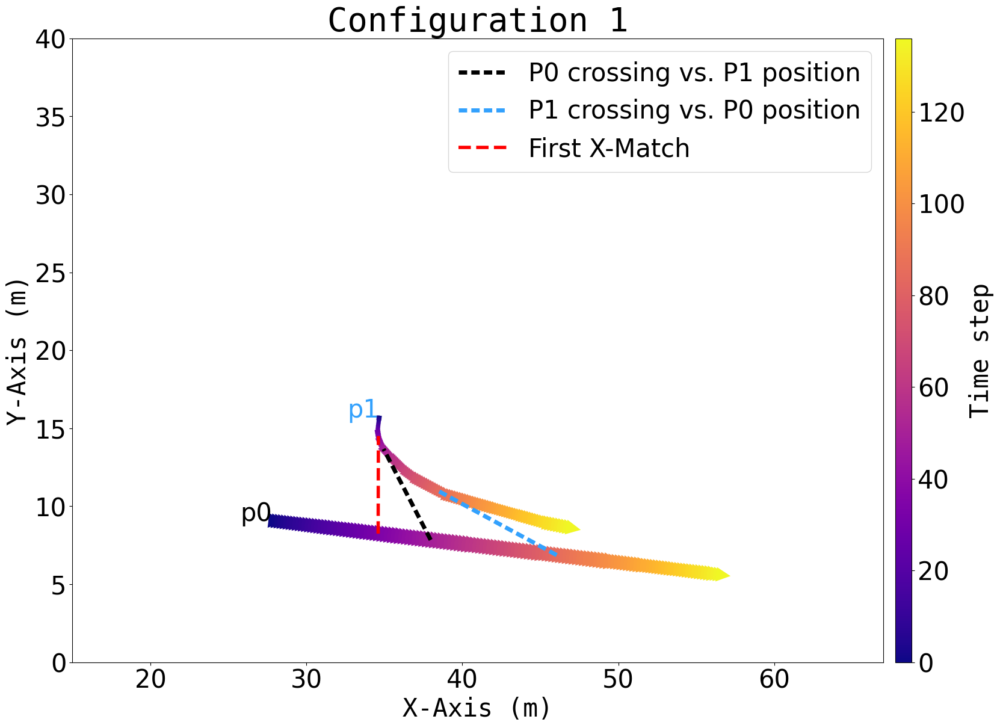

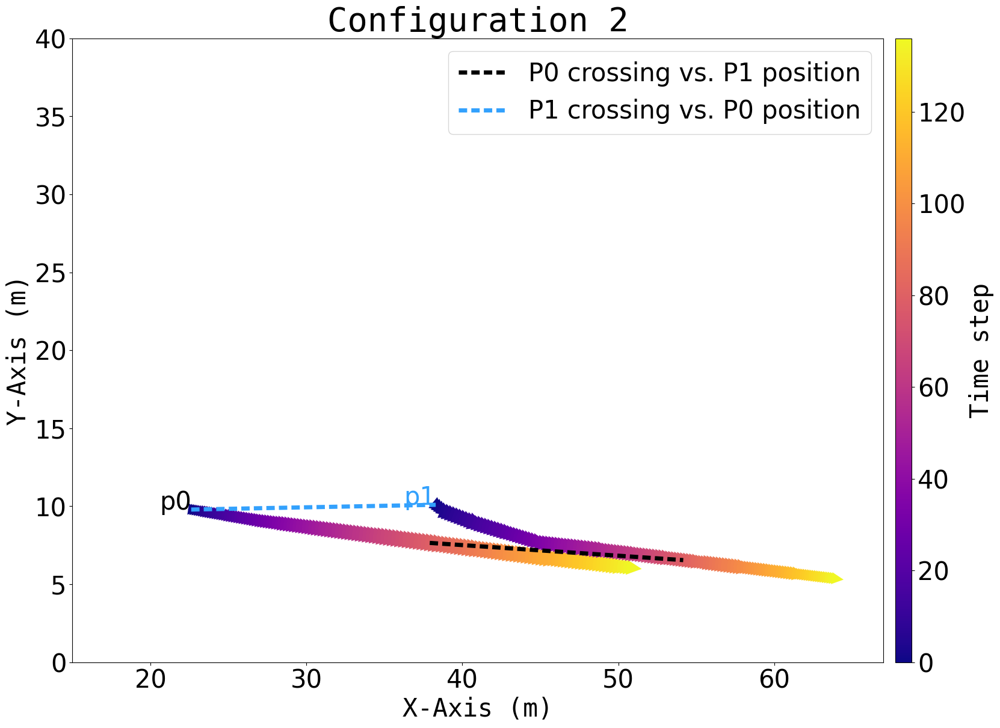

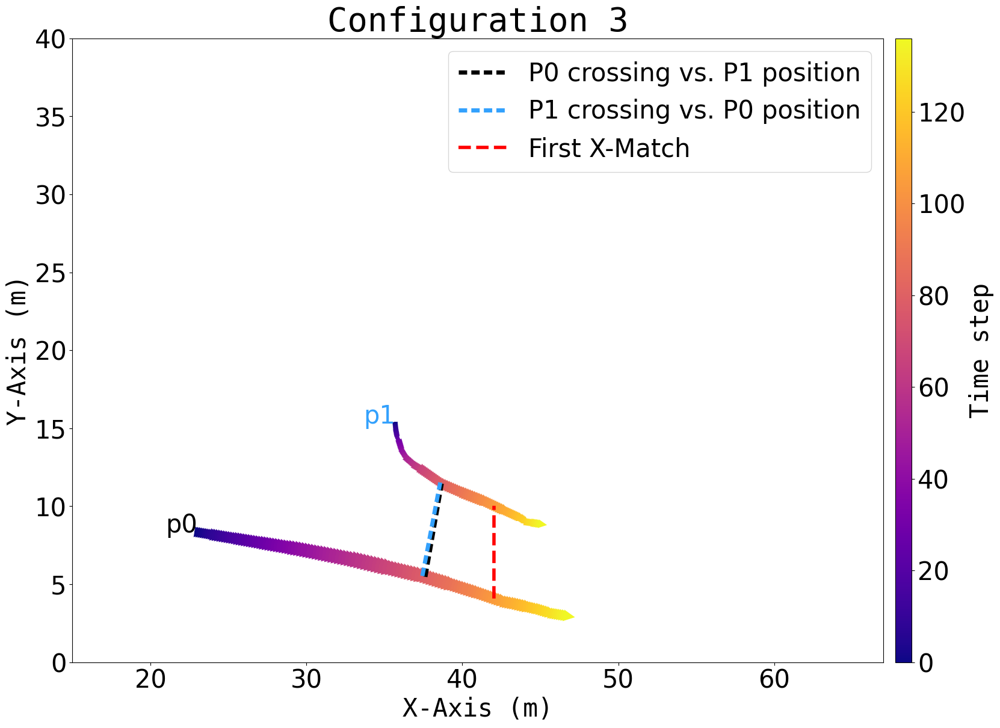

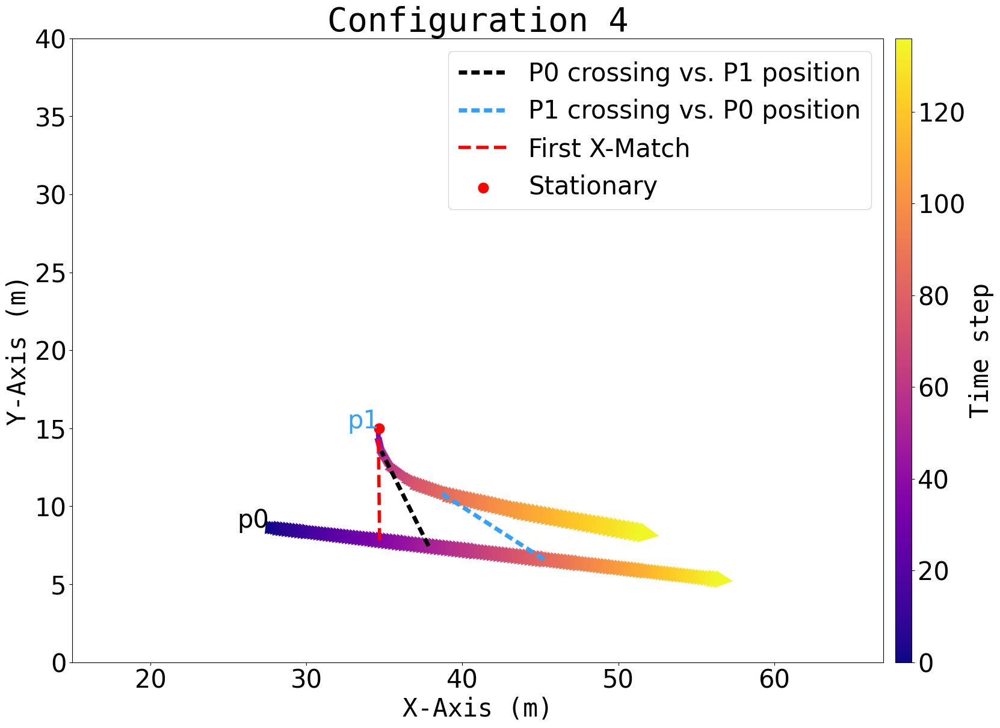

...

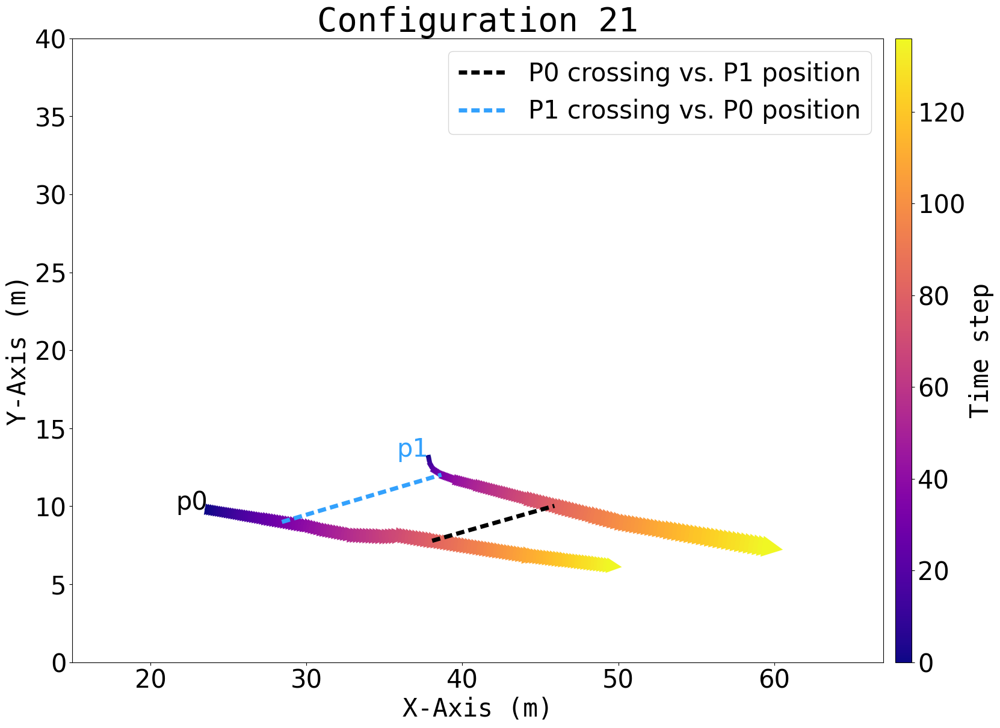

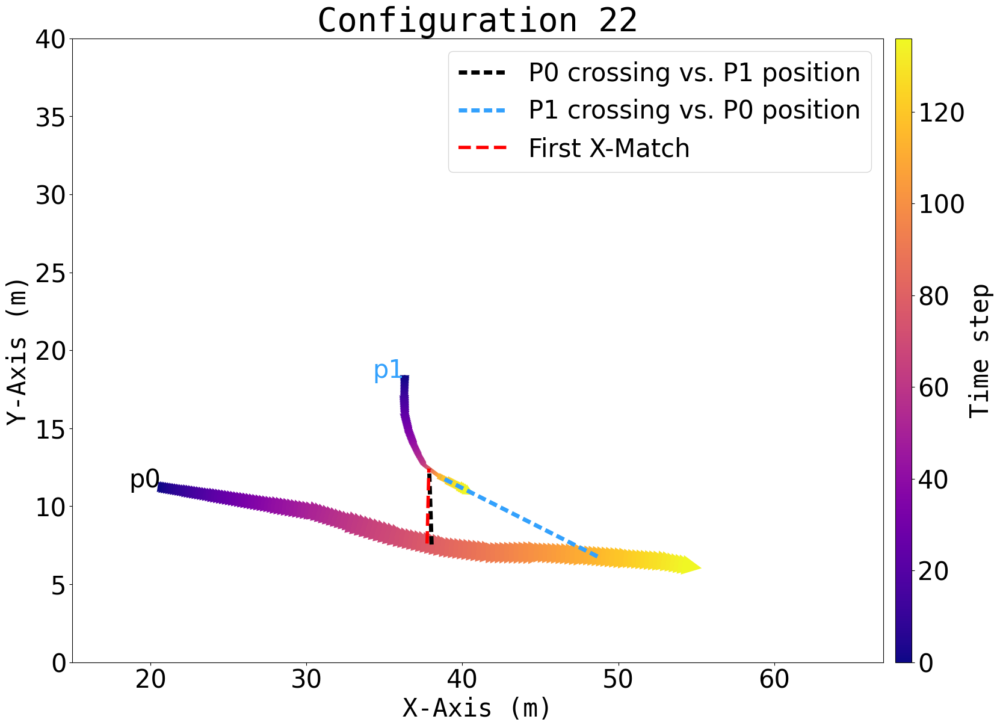

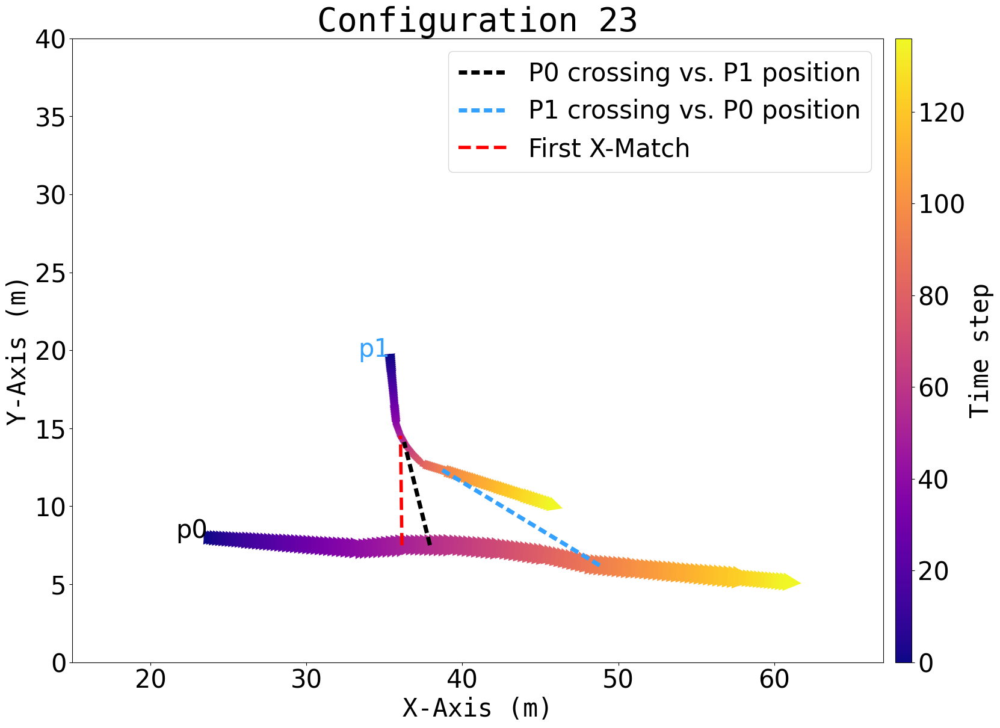

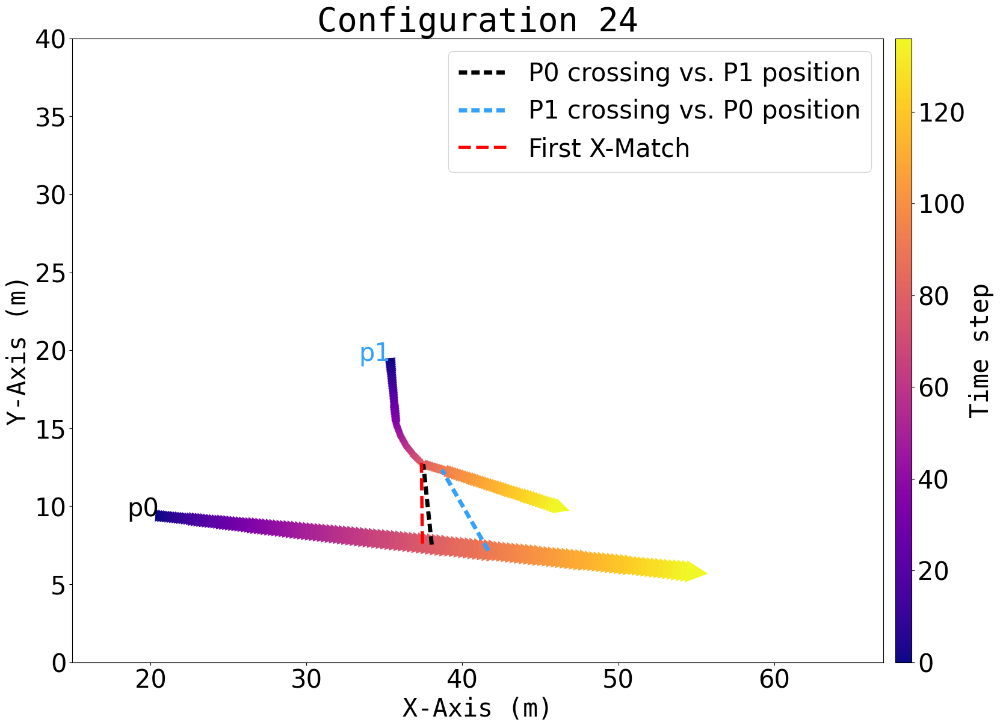

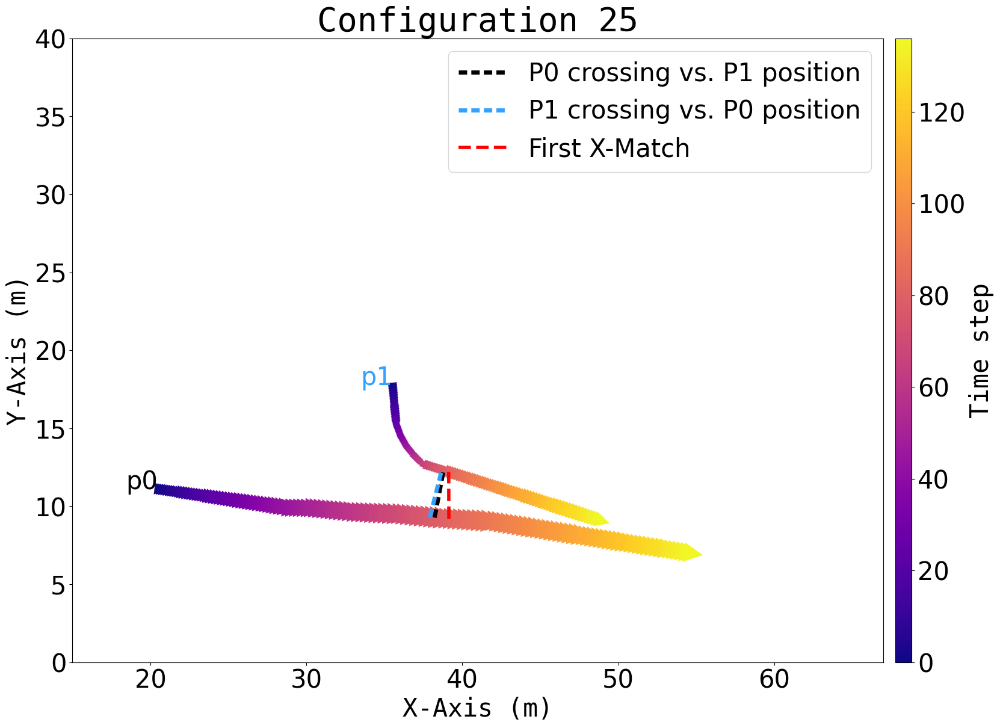

Time elapsed for running module "N_VA_StaticAbsolute": 28.320 sec.


In [4]:
# Load the necessary libraries
from matplotlib import cm  # Colormaps
import matplotlib.patches as patches  # For drawing shapes
import matplotlib.pyplot as plt  # Plotting library
import matplotlib as mpl  # Matplotlib settings
import os
import pandas as pd
import time
import numpy as np  # Numerical operations
from mpl_toolkits.axes_grid1 import make_axes_locatable  # For aligned colorbar

# Import custom attributes
import av

# ------------------------------
# TOGGLES
# ------------------------------
CONNECT_SE = 0           # Start/end connections
CONNECT_CLOSEST_TST = 1  # TST connections
DRAW_FIRST_X_MATCH_LINE = 1  # ✅ NEW: draw first x-matching line

# ------------------------------
# STYLE CONFIGS
# ------------------------------
_SE_LINESTYLE = '--'
_SE_COLOR = 'black'
_SE_LINEWIDTH = 1.8
_SE_ALPHA = 0.9

_TST_LINESTYLE = (0, (2, 1))    
_TST_LINEWIDTH = 5
_TST_ALPHA = 1
_TST_COLOR_POI0 = 'black'
_TST_COLOR_POI1 = '#33A1FD'

# ✅ NEW: style for x-match line
_X_MATCH_LINESTYLE = '--'
_X_MATCH_COLOR = 'red'
_X_MATCH_LINEWIDTH = 4
_X_MATCH_LABEL = 'First X-Match'
_X_MATCH_THRESHOLD = 0.5  # Only draw if abs(x0 - x1) < threshold

# ------------------------------
# INIT
# ------------------------------
t_start = time.time()
mpl.rcParams['figure.dpi'] = 2.54

df = pd.read_csv(av.dataset_name, header=None)
configurations = df[0].unique()

colors = ['black', 'blue', 'magenta'] if av.poi == 3 else [plt.cm.cividis(i/av.poi) for i in range(av.poi)]
cmap_time = cm.plasma
num_intervals = av.tst - 1 if av.tst > 1 else 1
min_marker_size = 100
max_marker_size = 500

# ---------- Load closest TST connection lines ----------
closest_df = closest_to_line_df
raw_df = pd.read_csv(av.dataset_name, header=None)
raw_df.columns = ['configuration', 'TST', 'poi', 'x', 'y']
tst_connection_lines = {}
for _, row in closest_df.iterrows():
    config = int(row['configuration'])
    poi0_tst = int(row['poi0_TST'])
    poi1_tst = int(row['poi1_TST'])
    group = raw_df[raw_df['configuration'] == config]
    points_tst0 = group[group['TST'] == poi0_tst][['poi', 'x', 'y']].sort_values(by='poi')
    points_tst1 = group[group['TST'] == poi1_tst][['poi', 'x', 'y']].sort_values(by='poi')
    if len(points_tst0) >= 2 and len(points_tst1) >= 2:
        line0 = list(zip(points_tst0['x'], points_tst0['y']))
        line1 = list(zip(points_tst1['x'], points_tst1['y']))
        tst_connection_lines[config] = {'TST0': poi0_tst, 'line0': line0,
                                        'TST1': poi1_tst, 'line1': line1}

# ---------- Plot ----------
for config in configurations:
    config_data = df[df[0] == config]
    x = config_data[3]
    y = config_data[4]

    fig, ax = plt.subplots(figsize=(18, 18), dpi=100.0)
    ax.set_xlim(15, av.max_boundary_x)
    ax.set_ylim(av.min_boundary_y, av.max_boundary_y)

    ax.set_xlabel('X-Axis (m)', fontsize=30, fontname='monospace')
    ax.set_ylabel('Y-Axis (m)', fontsize=30, fontname='monospace')
    ax.tick_params(axis='both', labelsize=30, labelcolor='black')
    ax.set_aspect('equal', adjustable='box')

    static_counts = {}
    static_coords = {}
    start_points = {}
    end_points = {}

    if av.tst == 1:
        for p, (x_val, y_val) in enumerate(zip(x, y)):
            color_to_use = colors[p % len(colors)]
            ax.scatter(x_val, y_val, color=color_to_use, s=200)
            start_points[p] = (x_val, y_val)
            end_points[p] = (x_val, y_val)
    else:
        for p in range(av.poi):
            for i in range(av.tst - 1):
                idx = p + i * av.poi
                x1, y1 = x.iloc[idx], y.iloc[idx]
                x2, y2 = x.iloc[idx + av.poi], y.iloc[idx + av.poi]
                dx, dy = x2 - x1, y2 - y1
                step_len = np.hypot(dx, dy)

                if step_len == 0:
                    static_counts[p] = static_counts.get(p, 0) + 1
                    static_coords[p] = (x1, y1)
                else:
                    head_width = step_len * 4
                    head_length = step_len * 4
                    color_to_use = cmap_time(i / num_intervals)
                    ax.arrow(
                        x1, y1, dx, dy,
                        head_starts_at_zero=True,
                        length_includes_head=True,
                        head_width=head_width,
                        head_length=head_length,
                        linewidth=2 + step_len * 0.05,
                        color=color_to_use,
                    )

                if i == 0:
                    if p == 0:
                        ax.text(x1, y1, f'p{p}', fontsize=30, ha='right')
                    elif p == 1:
                        ax.text(x1, y1, f'p{p}', fontsize=30, ha='right', color=_TST_COLOR_POI1)
                        
                    start_points[p] = (x1, y1)
                if i == av.tst - 2:
                    end_points[p] = (x2, y2)

    if CONNECT_SE and av.poi > 1:
        start_x = [start_points[p][0] for p in range(av.poi) if p in start_points]
        start_y = [start_points[p][1] for p in range(av.poi) if p in start_points]
        if len(start_x) >= 2:
            ax.plot(start_x, start_y, linestyle=_SE_LINESTYLE, color=_SE_COLOR,
                    linewidth=_SE_LINEWIDTH, alpha=_SE_ALPHA, zorder=1)

        if av.tst > 1:
            end_x = [end_points[p][0] for p in range(av.poi) if p in end_points]
            end_y = [end_points[p][1] for p in range(av.poi) if p in end_points]
            if len(end_x) >= 2:
                ax.plot(end_x, end_y, linestyle=_SE_LINESTYLE, color=_SE_COLOR,
                        linewidth=_SE_LINEWIDTH, alpha=_SE_ALPHA, zorder=1)

    # ---------- TST Connection Lines ----------
    if CONNECT_CLOSEST_TST and config in tst_connection_lines:
        lines = tst_connection_lines[config]
        for line_key in ['line0', 'line1']:
            coords = lines[line_key]
            if len(coords) >= 2:
                x_vals, y_vals = zip(*coords)
                color = _TST_COLOR_POI0 if line_key == 'line0' else _TST_COLOR_POI1
                label = f"P0 crossing vs. P1 position" if line_key == 'line0' else f"P1 crossing vs. P0 position"
                ax.plot(
                    x_vals, y_vals,
                    linestyle=_TST_LINESTYLE,
                    color=color,
                    linewidth=_TST_LINEWIDTH,
                    alpha=_TST_ALPHA,
                    label=label
                )

    # ---------- ✅ NEW: First X-Match Line ----------
    if DRAW_FIRST_X_MATCH_LINE and av.poi >= 2:
        group = raw_df[raw_df['configuration'] == config]
        min_x_diff = float('inf')
        min_x_tst = None

        for tst in sorted(group['TST'].unique()):
            subset = group[group['TST'] == tst]
            if len(subset['poi'].unique()) < 2:
                continue
            p0 = subset[subset['poi'] == 0].iloc[0]
            p1 = subset[subset['poi'] == 1].iloc[0]
            x_diff = abs(p0['x'] - p1['x'])
            if x_diff < min_x_diff:
                min_x_diff = x_diff
                min_x_tst = tst

        if min_x_tst is not None and min_x_diff < _X_MATCH_THRESHOLD:
            subset = group[group['TST'] == min_x_tst]
            p0 = subset[subset['poi'] == 0].iloc[0]
            p1 = subset[subset['poi'] == 1].iloc[0]
            x_vals = [p0['x'], p1['x']]
            y_vals = [p0['y'], p1['y']]
            ax.plot(
                x_vals, y_vals,
                linestyle=_X_MATCH_LINESTYLE,
                color=_X_MATCH_COLOR,
                linewidth=_X_MATCH_LINEWIDTH,
                alpha=1,
                label=_X_MATCH_LABEL
            )

    # ---------- Stationary Points ----------
    stationary_plotted = False
    total_intervals = num_intervals
    for p, count in static_counts.items():
        x1, y1 = static_coords[p]
        size = min_marker_size + (count / total_intervals) * (max_marker_size - min_marker_size)
        label = 'Stationary' if not stationary_plotted else None
        ax.scatter(x1, y1, color='red', s=size, label=label)
        stationary_plotted = True

    # ---------- Time Bar ----------
    if av.tst > 1:
        sm = plt.cm.ScalarMappable(cmap=cmap_time, norm=plt.Normalize(vmin=0, vmax=num_intervals))
        sm.set_array([])
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='2%', pad=0.2)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label('Time step', fontsize=30, fontname='monospace')
        cbar.ax.tick_params(labelsize=30)

        handles, labels = ax.get_legend_handles_labels()
        if labels:
            ax.legend(fontsize=30, loc='upper right')

    ax.set_title(f"Configuration {config}", fontname="monospace", fontsize=40)
    fig.savefig(f"N_C_Csa{config}.png", dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig)

print(f"Time elapsed for running module \"N_VA_StaticAbsolute\": {time.time() - t_start:.3f} sec.")


In [5]:
closest_to_line_df

,configuration,poi0_TST,poi0_x,poi0_y,poi1_TST,poi1_x,poi1_y
0,0,79.0,37.734517,6.963823,34.0,38.477808,11.007944
1,1,48.0,37.966135,7.842767,84.0,38.506996,10.956007
2,2,79.0,37.905591,7.652988,0.0,38.289101,10.095124
3,3,79.0,37.626938,5.475081,78.0,38.579554,11.524332
4,4,49.0,37.832365,7.447495,82.0,38.520993,10.910511
5,5,78.0,37.706035,6.726903,84.0,38.553991,11.484143
6,6,24.0,38.216920,9.076373,88.0,38.563177,11.052975
7,7,48.0,37.786939,6.383091,82.0,38.378203,10.472757
8,8,25.0,38.158620,8.368820,87.0,38.762248,12.681932
9,9,56.0,37.863698,6.880771,86.0,38.242822,9.771121


In [7]:
dic = dict(zip(
    closest_to_line_df['configuration'],
    closest_to_line_df['poi1_TST'] - closest_to_line_df['poi0_TST']
))

In [8]:
dic

{0: -33.0,
 1: 36.0,
 2: -78.0,
 3: -3.0,
 4: 30.0,
 5: 11.0,
 6: 68.0,
 7: 32.0,
 8: 63.0,
 9: 35.0,
 10: 38.0,
 11: -81.0,
 12: 55.0,
 13: -2.0,
 14: 41.0,
 15: 2.0,
 16: -33.0,
 17: 49.0,
 18: 45.0,
 19: 17.0,
 20: 29.0,
 21: -45.0,
 22: 48.0,
 23: 40.0,
 24: 15.0,
 25: 3.0}

In [97]:
df

,0,1,2,3,4
0,0,0,0,23.104007,9.501706
1,0,0,1,36.393708,11.799859
2,0,1,0,23.242618,9.477662
3,0,1,1,36.440938,11.746685
4,0,2,0,23.381805,9.453518
...,...,...,...,...,...
7119,25,134,1,48.558587,9.183353
7120,25,135,0,54.506260,7.010078
7121,25,135,1,48.751860,9.121400
7122,25,136,0,54.772854,6.967477


In [122]:
x = []
y = []
for idx, row in closest_to_line_df.iterrows():
    configuration = row['configuration']
    tst = row['poi1_TST']
    # print(tst)
    x1 = df[(df[0] == configuration) & (df[1] == int(tst)) & (df[2] == 1)][3].values[0]
    y1 = df[(df[0] == configuration) & (df[1] == int(tst)) & (df[2] == 1)][4].values[0]

    x0 = df[(df[0] == configuration) & (df[1] == int(tst)) & (df[2] == 0)][3].values[0]
    y0 = df[(df[0] == configuration) & (df[1] == int(tst)) & (df[2] == 0)][4].values[0]

    # print(x1,y1)
    x.append(x0 - x1)
    y.append(y0 - y1)
closest_to_line_df['x'] = x
closest_to_line_df['y'] = y

closest_to_line_df

,configuration,poi0_TST,poi0_x,poi0_y,poi1_TST,poi1_x,poi1_y,x,y,cluster
0,0,79.0,37.734517,6.963823,34.0,38.477808,11.007944,-9.965725,-2.444351,1
1,1,48.0,37.966135,7.842767,84.0,38.506996,10.956007,7.541507,-4.086346,3
2,2,79.0,37.905591,7.652988,0.0,38.289101,10.095124,-15.677153,-0.304518,4
3,3,79.0,37.626938,5.475081,78.0,38.579554,11.524332,-1.145183,-5.990945,1
4,4,49.0,37.832365,7.447495,82.0,38.520993,10.910511,6.714034,-4.317357,3
5,5,78.0,37.706035,6.726903,84.0,38.553991,11.484143,0.633084,-5.002760,1
6,6,24.0,38.216920,9.076373,88.0,38.563177,11.052975,12.898602,-4.399561,0
7,7,48.0,37.786939,6.383091,82.0,38.378203,10.472757,6.724812,-4.260503,3
8,8,25.0,38.158620,8.368820,87.0,38.762248,12.681932,15.095770,-6.681547,0
9,9,56.0,37.863698,6.880771,86.0,38.242822,9.771121,7.332255,-3.693347,3


C:\Users\25803\AppData\Local\Temp\ipykernel_11420\3688984233.py:28: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10')  # 最多支持 10 个聚类颜色


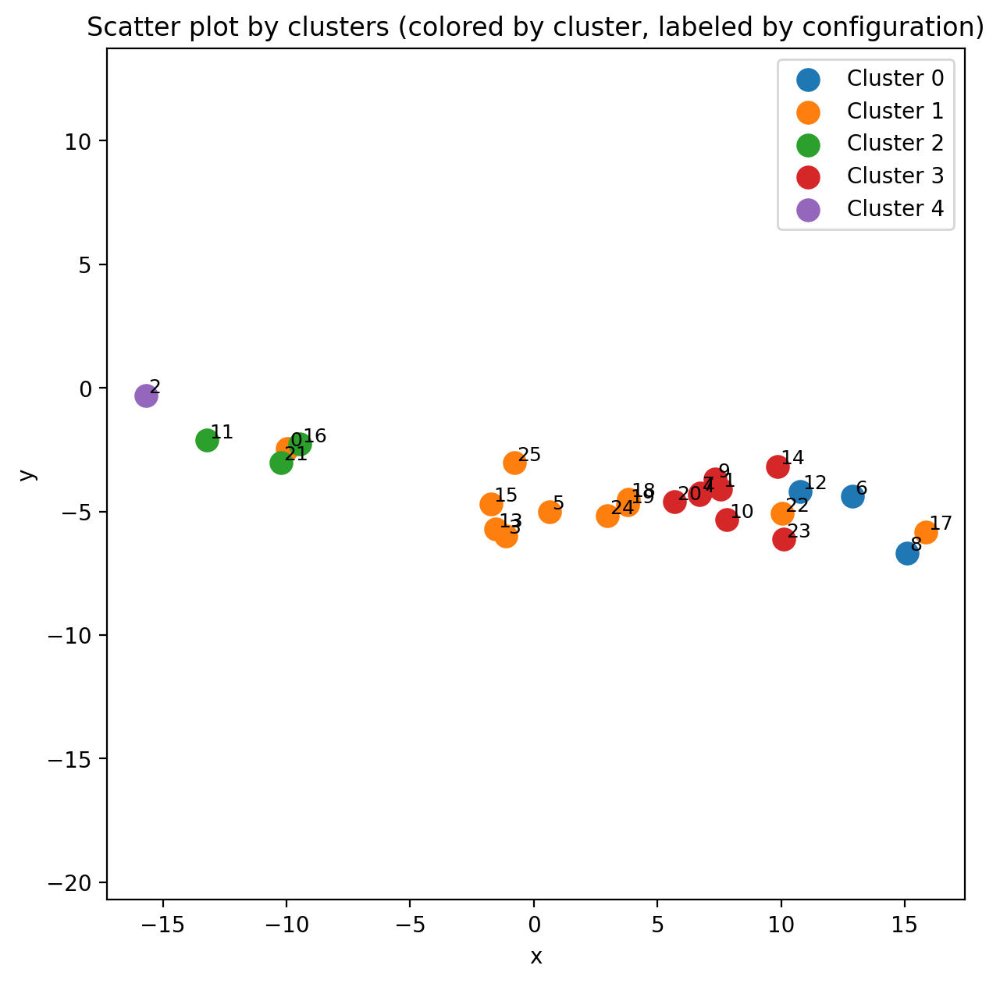

In [126]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd

# 假设你的 DataFrame 是 df，包含 columns: configuration, x, y

# Step 1: 原始聚类结果
clusters = {
    4: [2],
    2: [11, 16, 21],
    1: [0, 3, 5, 13, 15, 17, 18, 19, 22, 24, 25],
    3: [1, 4, 7, 9, 10, 14, 20, 23],
    0: [6, 8, 12]
}

# Step 2: 反转为 configuration -> cluster 映射
config_to_cluster = {}
for cluster_id, configs in clusters.items():
    for config in configs:
        config_to_cluster[config] = cluster_id

# Step 3: 添加 cluster_id 列
closest_to_line_df['cluster'] = closest_to_line_df['configuration'].map(config_to_cluster)

# Step 4: 画图
cm_to_inch = lambda cm: cm / 2.54
fig = plt.figure(figsize=(cm_to_inch(18), cm_to_inch(18)), dpi=200)
cmap = cm.get_cmap('tab10')  # 最多支持 10 个聚类颜色

for cluster_id in sorted(clusters.keys()):
    cluster_df = closest_to_line_df[closest_to_line_df['cluster'] == cluster_id]
    plt.scatter(cluster_df['x'], cluster_df['y'], 
                label=f'Cluster {cluster_id}', 
                s=100, c=[cmap(cluster_id)])

    # 标注 configuration
    for _, row in cluster_df.iterrows():
        plt.text(row['x'] + 0.1, row['y'] + 0.1, 
                 str(int(row['configuration'])), fontsize=9)

plt.xlabel("x")
plt.ylabel("y")
plt.title("Scatter plot by clusters (colored by cluster, labeled by configuration)")
plt.legend()
# plt.grid(True)
plt.axis('equal')
plt.show()
